## PROBLEM STATEMENT

## PROJECT NAME- AUTO INSURANCE CLAIM FRAUD DETETCTION



---


**Insurance Fraud Claims** :-
> Insurance Fraud Claim refers to any Insurance Claim with Improper Payment from Customer to Insurer (i.e., Insurance Company)
---
**CLIENT** :- 

  Our Client is an Insurance Company , which have a Business Problem of Fraud Claims that leads to excessive Leakages . So that Our Client wants to Find the Fraudlents ones before even processing the claims to allocate costs appropriately.

> There are Two main Reasons for the Claims
*   Motor Insurance and 
*   Health Insurance

These are the segments that have seen a spurt in fraud.

>Frauds can be classified into following Categories 
> *   Source and 
> *   Nature point of view

1. Sources Can be Policy Holders ,Intermediary (i.e., Who are refering the policy to Customers) and Internal (i.e., Employees who are working in that Domain). This Problem is more Critical from Internal control framework point of view. 


2. Nature Point Of View can refers to application, Inflation , Identity, Fabrication(i.e.,Claiming more amount than what they spent), staged/contrived/induced accidents (i.e., Doing Accidents Intentionally To Claim money) etc


> This Kind of Fraud Claims affects the Lives of Innocent people as well as the Insurance industry not only this, Society get Lose their Instrest On Insurance Companies which leads to the destruction of Insurance Companies.So, by Detecting the Fraud Claims we can helpful to Regular Cuatomers and Intelligence Team. Predicting at the time of processing claims will reduce costs and minimize losses.


---


**Client Requirements** :- 


Beyond Building a model to predict Fraudlents they also want to identify patterns in Fraud Claims which helps in turn to Company to take Action to initiate investigation to Identify if Fraud Exist and also to handle Fraudlent Cases while setteling the claims.So they are Expected to Perform

1. Exploratory Data Analysis using visualizations - To get Insights which helps to Identify Fraudlents. 

2. Build the analytical framework to predict if a claim is fraudulent or not - Evaluating the Model by Using F1-Score as Metric

3. Report  the results/observations from learning curves - To Know Which model works Well in Predicting Fraud Cliams.

4. Extract the top 20 patterns for fraudulent claims - Which helps to Understand the Company that Claim is Fraud or not Even Before they Processing the Claim.




---



---





















## Importing Necessary Libraries

In [ ]:
!pip install mlxtend==0.17.3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install catboost

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os                           #os module is a part of the standard library or stdlib-->it comes with your Python installation
import pandas as pd                 # tells Python to bring the pandas data analysis library into your current environment--> used for importing,managing,manipulating,analyzing datasets
import numpy as np                  #to perform a wide variety of mathematical operations on numpy arrays
import matplotlib.pyplot as plt     # a collection of command style functions that make matplotlib work like MATLAB
import seaborn as sns               #open-source Python library built on top of matplotlib-->used for data visualization and exploratory data analysis
import plotly.express as px
                                    #sklearn-Scikit-Learn is a free Machine Learning library -->useful tool for data mining and data analysis

from sklearn.model_selection import train_test_split    #Split arrays or matrices into random train and test subsets-->we have to mention test_size and random state for data productivity
from sklearn.preprocessing import StandardScaler        #helps in feature scaling-->to standardize the range of functionality of the input dataset
from sklearn.impute import SimpleImputer                #SimpleImputer class provides basic strategies for imputing missing values using mean,median and mode
from sklearn.model_selection import GridSearchCV        # used Hyper Parameter Tuning--> finding the optimal parameter values from a given set of parameters in a grid
from sklearn.metrics import confusion_matrix,accuracy_score #to evaluate machine learning algorithms --> the performance of algorithm is evaluated by using accuracy,precision,recall and f1_score
from sklearn.metrics import precision_score,recall_score,f1_score   
from sklearn.preprocessing import OneHotEncoder         # used for performing dummification on categorical colums in the dataframe

from sklearn.linear_model import LogisticRegression                                #helps to use Linear Regression , Logistic Regression
from sklearn.tree import DecisionTreeClassifier                                    #helps to use Method  like DecisionTreeClassifier , DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor          #helps to use Methods like RandomForestClassifier , RandomForestTreeRegressor
from sklearn.svm import SVC                                                        #helps to import support vector machine functions like Support Vector Classifier , Support Vector Regressor
from sklearn.neighbors import KNeighborsClassifier                                 # helps to build a distance based and lazy model K-Nearest Neighbors model
from xgboost import XGBClassifier                                              #helps to build a boosting model XG Boost
from sklearn.ensemble import AdaBoostClassifier                                    #helps to build another boosting model AdaBoost
from mlxtend.classifier import StackingCVClassifier                                #helps to use and build Stacking model
from catboost import CatBoostClassifier,Pool                                       #helps to import and build CatBoost model

from sklearn.model_selection import GridSearchCV                             #GridSearch CV--> cross validation is used to tune hyper parameters which are present in a given list of values
from imblearn.over_sampling import SMOTE                                     # to address problem of class imbalance and solving by using SMOTE method
from sklearn.experimental import enable_iterative_imputer                    # helps to use advanced Imputation Techniques like KNN Imputer and Mice Imputer
from sklearn.impute import IterativeImputer                                  # helps to import and use MICE Imputer --> Multiple Imputation by Chained Equation.




---


**This code mounts your Google Drive to your Google Colab notebook so that you can access files and folders stored in your Google Drive**


---



---



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).




---


I have written all the Functions in "ml_functions.py" File.So the Below Code of Line is used when you want to import modules or packages that are located outside of the current working directory or standard library


---



In [ ]:
import sys
sys.path.append("/content/drive/MyDrive/CapStone")

In [ ]:
from ml_functions import *      # I have written all functions which are needed for preprocessing in ml_functions.py file and I'm Importing here



---


The below Code sets the display options for Pandas dataframes in the Jupyter notebook or Python environment.


1.   "pd.set_option('display.expand_frame_repr', False)" sets the option to not wrap the dataframe to the next line when it reaches the end of the screen

2.   "pd.set_option('display.max_columns', None)" sets the option to display all columns of the dataframe. If it's set to a specific integer value, only that many columns will be displayed and the rest will be truncated 


---



---




In [ ]:
# pd.set_option('display.max_rows', None)
pd.set_option('display.expand_frame_repr', False)
pd.set_option('display.max_columns', None)

## Reading the DATA



---


1. **"pd.read_csv()" is a function in Pandas that reads a CSV file into a dataframe.**
2. ***The na_values argument is used to specify the symbols that represent missing values in the CSV file. In this case, the missing value symbols are "?", "???", "NA", "-1", "-5", "MISSEDDATA", and "MISSINGVALUE". ***


---



---



In [ ]:
Train_Claim=pd.read_csv("/content/drive/MyDrive/CapStone/Train_data/Train_Claim.csv",na_values=["?","???","NA","-1","-5","MISSEDDATA","MISSINGVALUE"])
Train_Demo=pd.read_csv("/content/drive/MyDrive/CapStone/Train_data/Train_Demographics.csv",na_values=["?","???","NA","-1","-5","MISSEDDATA","MISSINGVALUE"])
Train_policy=pd.read_csv("/content/drive/MyDrive/CapStone/Train_data/Train_Policy.csv",na_values=["?","???","NA","-1","-5","MISSEDDATA","MISSINGVALUE"])
Train_Vehicle=pd.read_csv("/content/drive/MyDrive/CapStone/Train_data/Train_Vehicle.csv",na_values=["?","???","NA","-1","-5","MISSEDDATA","MISSINGVALUE"])
Train_target=pd.read_csv("/content/drive/MyDrive/CapStone/Train_data/Traindata_with_Target.csv")

In [ ]:
Train_Claim

,CustomerID,DateOfIncident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,IncidentAddress,IncidentTime,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage
0,Cust10000,2015-02-03,Multi-vehicle Collision,Side Collision,Total Loss,Police,State7,City1,Location 1311,17.0,3,NaN,1,0.0,NaN,65501.0,13417,6071,46013
1,Cust10001,2015-02-02,Multi-vehicle Collision,Side Collision,Total Loss,Police,State7,City5,Location 1311,10.0,3,YES,2,1.0,YES,61382.0,15560,5919,39903
2,Cust10002,2015-01-15,Single Vehicle Collision,Side Collision,Minor Damage,Other,State8,City6,Location 2081,22.0,1,YES,2,3.0,NO,66755.0,11630,11630,43495
3,Cust10003,2015-01-19,Single Vehicle Collision,Side Collision,Minor Damage,Other,State9,City6,Location 2081,22.0,1,YES,2,3.0,NO,66243.0,12003,12003,42237
4,Cust10004,2015-01-09,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State8,City6,Location 1695,10.0,1,NO,2,1.0,YES,53544.0,8829,7234,37481
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28831,Cust9993,2015-01-24,Vehicle Theft,NaN,Trivial Damage,Police,State9,City4,Location 1890,3.0,1,NO,0,3.0,NaN,6590.0,870,1078,4642
28832,Cust9994,2015-02-09,Single Vehicle Collision,Front Collision,Minor Damage,Fire,State8,City3,Location 2097,17.0,1,YES,0,2.0,YES,74547.0,14699,7875,51973
28833,Cust9996,2015-01-28,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State9,City7,Location 1452,1.0,1,YES,2,0.0,YES,55305.0,7043,7043,41219
28834,Cust9997,2015-01-28,Single Vehicle Collision,Rear Collision,Minor Damage,Ambulance,State9,City3,Location 1876,1.0,1,NaN,2,0.0,YES,55830.0,7059,7059,41712


In [ ]:
Train_Demo

,CustomerID,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,Country
0,Cust10000,35,454776,MALE,JD,armed-forces,movies,56700,-48500,India
1,Cust10001,36,454776,MALE,JD,tech-support,cross-fit,70600,-48500,India
2,Cust10002,33,603260,MALE,JD,armed-forces,polo,66400,-63700,India
3,Cust10003,36,474848,MALE,JD,armed-forces,polo,47900,-73400,India
4,Cust10004,29,457942,FEMALE,High School,exec-managerial,dancing,0,-41500,India
...,...,...,...,...,...,...,...,...,...,...
28831,Cust9993,46,600561,MALE,Masters,protective-serv,sleeping,0,0,India
28832,Cust9994,44,439304,MALE,Masters,adm-clerical,dancing,0,-28800,India
28833,Cust9996,53,460722,MALE,PhD,transport-moving,base-jumping,63100,-43800,India
28834,Cust9997,53,472634,MALE,Associate,transport-moving,skydiving,67400,-43800,India


In [ ]:
Train_policy

,InsurancePolicyNumber,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,CustomerID
0,110122,328,2014-10-17,State3,250/500,1000,1406.91,0,husband,Cust1001
1,110125,256,1990-05-25,State1,250/500,2000,1415.74,6000000,unmarried,Cust1004
2,110126,228,2014-06-06,State1,500/1000,1000,1583.91,6000000,unmarried,Cust1005
3,110127,256,2006-10-12,State3,250/500,1000,1351.10,0,unmarried,Cust1006
4,110128,137,2000-06-04,State2,250/500,1000,1333.35,0,husband,Cust1007
...,...,...,...,...,...,...,...,...,...,...
28831,148614,425,1999-10-12,State3,250/500,1000,839.81,0,wife,Cust39493
28832,148615,367,1996-11-09,State3,250/500,1000,811.03,0,husband,Cust39494
28833,148616,208,1995-12-04,State3,250/500,1000,891.37,0,husband,Cust39495
28834,148618,401,1994-09-12,State3,250/500,856,911.37,0,own-child,Cust39497


In [ ]:
Train_Vehicle

,CustomerID,VehicleAttribute,VehicleAttributeDetails
0,Cust20179,VehicleID,Vehicle8898
1,Cust21384,VehicleModel,Malibu
2,Cust33335,VehicleMake,Toyota
3,Cust27118,VehicleModel,Neon
4,Cust13038,VehicleID,Vehicle30212
...,...,...,...
115339,Cust22134,VehicleMake,Audi
115340,Cust25338,VehicleID,Vehicle28831
115341,Cust7637,VehicleID,Vehicle12870
115342,Cust33581,VehicleID,Vehicle19680




---


**The above "Train_Vehicle" DataFrame is given as "VehicleAttribute" Column Contains all the attributes of Vehicle like "VehicleID","VehicleModel","Vehiclemake","vehicleYOM" but acutally they are attributes of each "CustomerID". So I need to convert them into respective DataFrame.**

> **The below code performs a pivot operation on a dataframe Train_Vehicle and creates a new dataframe Train_Vehicle_pivoted that contains the pivoted data.**

1. Train_Vehicle.pivot() function is used to pivot the data. The index parameter is set to 'CustomerID', which means that the CustomerID column will be the new index of the pivoted dataframe.

2. The columns parameter is set to 'VehicleAttribute', which means that the values in the VehicleAttribute column will become the new column names of the pivoted dataframe. 

3. The values parameter is set to 'VehicleAttributeDetails', which means that the values in the VehicleAttributeDetails column will be used to populate the pivoted dataframe.

> After the pivot operation, Train_Vehicle_pivoted dataframe has a row for each CustomerID, and the columns represent the different VehicleAttribute values in the original dataframe. The reset_index() function is used to reset the index column to its original integer values.

The resulting Train_Vehicle_pivoted dataframe will be useful for further data analysis or modeling that requires the VehicleAttribute data to be in a wide format, with each attribute represented by a separate column.


---



---



In [ ]:
Train_Vehicle_pivoted = Train_Vehicle.pivot(index='CustomerID', columns='VehicleAttribute', values='VehicleAttributeDetails')
Train_Vehicle_pivoted=Train_Vehicle_pivoted.reset_index()
Train_Vehicle_pivoted

VehicleAttribute,CustomerID,VehicleID,VehicleMake,VehicleModel,VehicleYOM
0,Cust10000,Vehicle26917,Audi,A5,2008
1,Cust10001,Vehicle15893,Audi,A5,2006
2,Cust10002,Vehicle5152,Volkswagen,Jetta,1999
3,Cust10003,Vehicle37363,Volkswagen,Jetta,2003
4,Cust10004,Vehicle28633,Toyota,CRV,2010
...,...,...,...,...,...
28831,Cust9993,Vehicle13568,Suburu,Impreza,2007
28832,Cust9994,Vehicle19810,Jeep,Wrangler,2003
28833,Cust9996,Vehicle3339,Suburu,Legacy,2004
28834,Cust9997,Vehicle10240,Suburu,Forrestor,2004


In [ ]:
Train_target

,CustomerID,ReportedFraud
0,Cust20065,N
1,Cust37589,N
2,Cust24312,N
3,Cust5493,Y
4,Cust7704,Y
...,...,...
28831,Cust9773,N
28832,Cust38439,N
28833,Cust38444,N
28834,Cust26466,N


## Combining All The DataFrames



---


**The below code merges four dataframes - "Train_Claim", "Train_Demo", "Train_policy", and "Train_Vehicle_pivoted" - into a single dataframe named "Train_df", using a common column "CustomerID" to merge the data.**

> The "pd.merge()" function is used multiple times to merge the dataframes. The first pd.merge() function merges "Train_Vehicle_pivoted and Train_target" dataframes on the common column CustomerID, and the resulting dataframe is then merged with "Train_policy" dataframe using the same CustomerID column. This process is repeated for Train_Demo and Train_Claim dataframes, resulting in a final merged dataframe Train_df containing all the data.


---



---



In [ ]:
Train_df=pd.merge(Train_Claim,pd.merge(Train_Demo,pd.merge(Train_policy,pd.merge(Train_Vehicle_pivoted,Train_target,on="CustomerID"),on="CustomerID"),on="CustomerID"),on="CustomerID")

In [ ]:
Train_df

,CustomerID,DateOfIncident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,IncidentAddress,IncidentTime,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,Country,InsurancePolicyNumber,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,VehicleID,VehicleMake,VehicleModel,VehicleYOM,ReportedFraud
0,Cust10000,2015-02-03,Multi-vehicle Collision,Side Collision,Total Loss,Police,State7,City1,Location 1311,17.0,3,NaN,1,0.0,NaN,65501.0,13417,6071,46013,35,454776,MALE,JD,armed-forces,movies,56700,-48500,India,119121,49,1998-10-25,State1,100/300,1000,1632.73,0,not-in-family,Vehicle26917,Audi,A5,2008,N
1,Cust10001,2015-02-02,Multi-vehicle Collision,Side Collision,Total Loss,Police,State7,City5,Location 1311,10.0,3,YES,2,1.0,YES,61382.0,15560,5919,39903,36,454776,MALE,JD,tech-support,cross-fit,70600,-48500,India,119122,114,2000-11-15,State1,100/300,1000,1255.19,0,not-in-family,Vehicle15893,Audi,A5,2006,N
2,Cust10002,2015-01-15,Single Vehicle Collision,Side Collision,Minor Damage,Other,State8,City6,Location 2081,22.0,1,YES,2,3.0,NO,66755.0,11630,11630,43495,33,603260,MALE,JD,armed-forces,polo,66400,-63700,India,119123,167,2001-02-12,State3,500/1000,617,1373.38,0,wife,Vehicle5152,Volkswagen,Jetta,1999,N
3,Cust10003,2015-01-19,Single Vehicle Collision,Side Collision,Minor Damage,Other,State9,City6,Location 2081,22.0,1,YES,2,3.0,NO,66243.0,12003,12003,42237,36,474848,MALE,JD,armed-forces,polo,47900,-73400,India,119124,190,2005-04-11,State2,500/1000,722,1337.60,0,own-child,Vehicle37363,Volkswagen,Jetta,2003,N
4,Cust10004,2015-01-09,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State8,City6,Location 1695,10.0,1,NO,2,1.0,YES,53544.0,8829,7234,37481,29,457942,FEMALE,High School,exec-managerial,dancing,0,-41500,India,119125,115,1996-10-25,State2,100/300,500,1353.73,4279863,unmarried,Vehicle28633,Toyota,CRV,2010,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28831,Cust9993,2015-01-24,Vehicle Theft,NaN,Trivial Damage,Police,State9,City4,Location 1890,3.0,1,NO,0,3.0,NaN,6590.0,870,1078,4642,46,600561,MALE,Masters,protective-serv,sleeping,0,0,India,119114,321,1998-04-18,State1,500/1000,655,1276.01,0,unmarried,Vehicle13568,Suburu,Impreza,2007,N
28832,Cust9994,2015-02-09,Single Vehicle Collision,Front Collision,Minor Damage,Fire,State8,City3,Location 2097,17.0,1,YES,0,2.0,YES,74547.0,14699,7875,51973,44,439304,MALE,Masters,adm-clerical,dancing,0,-28800,India,119115,237,2004-09-07,State2,100/300,1089,1273.38,0,unmarried,Vehicle19810,Jeep,Wrangler,2003,N
28833,Cust9996,2015-01-28,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State9,City7,Location 1452,1.0,1,YES,2,0.0,YES,55305.0,7043,7043,41219,53,460722,MALE,PhD,transport-moving,base-jumping,63100,-43800,India,119117,392,1998-09-10,State3,250/500,787,1380.92,3448735,own-child,Vehicle3339,Suburu,Legacy,2004,N
28834,Cust9997,2015-01-28,Single Vehicle Collision,Rear Collision,Minor Damage,Ambulance,State9,City3,Location 1876,1.0,1,NaN,2,0.0,YES,55830.0,7059,7059,41712,53,472634,MALE,Associate,transport-moving,skydiving,67400,-43800,India,119118,391,1998-08-10,State3,250/500,780,1389.29,3364301,not-in-family,Vehicle10240,Suburu,Forrestor,2004,N


## Understanding The Data



---


**Understanding Data in the sense Identifing the Shape of the DataFrame , Information about the DataFrame and Seeing the Top 10 rows of the Data.**


---



---



In [ ]:
Understanding_data(Train_df)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File. In this Function 
  I'm Understanding the dat

,CustomerID,DateOfIncident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,IncidentAddress,IncidentTime,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,Country,InsurancePolicyNumber,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,VehicleID,VehicleMake,VehicleModel,VehicleYOM,ReportedFraud
0,Cust10000,2015-02-03,Multi-vehicle Collision,Side Collision,Total Loss,Police,State7,City1,Location 1311,17.0,3,NaN,1,0.0,NaN,65501.0,13417,6071,46013,35,454776,MALE,JD,armed-forces,movies,56700,-48500,India,119121,49,1998-10-25,State1,100/300,1000,1632.73,0,not-in-family,Vehicle26917,Audi,A5,2008,N
1,Cust10001,2015-02-02,Multi-vehicle Collision,Side Collision,Total Loss,Police,State7,City5,Location 1311,10.0,3,YES,2,1.0,YES,61382.0,15560,5919,39903,36,454776,MALE,JD,tech-support,cross-fit,70600,-48500,India,119122,114,2000-11-15,State1,100/300,1000,1255.19,0,not-in-family,Vehicle15893,Audi,A5,2006,N
2,Cust10002,2015-01-15,Single Vehicle Collision,Side Collision,Minor Damage,Other,State8,City6,Location 2081,22.0,1,YES,2,3.0,NO,66755.0,11630,11630,43495,33,603260,MALE,JD,armed-forces,polo,66400,-63700,India,119123,167,2001-02-12,State3,500/1000,617,1373.38,0,wife,Vehicle5152,Volkswagen,Jetta,1999,N
3,Cust10003,2015-01-19,Single Vehicle Collision,Side Collision,Minor Damage,Other,State9,City6,Location 2081,22.0,1,YES,2,3.0,NO,66243.0,12003,12003,42237,36,474848,MALE,JD,armed-forces,polo,47900,-73400,India,119124,190,2005-04-11,State2,500/1000,722,1337.60,0,own-child,Vehicle37363,Volkswagen,Jetta,2003,N
4,Cust10004,2015-01-09,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State8,City6,Location 1695,10.0,1,NO,2,1.0,YES,53544.0,8829,7234,37481,29,457942,FEMALE,High School,exec-managerial,dancing,0,-41500,India,119125,115,1996-10-25,State2,100/300,500,1353.73,4279863,unmarried,Vehicle28633,Toyota,CRV,2010,N
5,Cust10005,2015-02-07,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State7,City6,Location 1695,7.0,1,NO,1,2.0,NaN,53167.0,7818,8132,37217,28,457942,FEMALE,High School,exec-managerial,dancing,0,-41500,India,119126,101,1999-10-24,State2,100/300,500,1334.49,3921366,unmarried,Vehicle26409,Toyota,CRV,2011,N
6,Cust10006,2015-01-30,Single Vehicle Collision,Front Collision,Minor Damage,Ambulance,State5,City4,Location 1440,20.0,1,NaN,0,2.0,NO,77453.0,6476,12822,58155,57,476456,MALE,Masters,adm-clerical,sleeping,67400,0,India,119127,471,1995-02-18,State3,100/300,512,1214.78,165819,own-child,Vehicle12114,Mercedes,C300,2000,N
7,Cust10007,2015-01-12,Single Vehicle Collision,Front Collision,Minor Damage,Police,State5,City3,Location 1440,18.0,1,NaN,0,2.0,NO,60569.0,5738,7333,47498,49,476456,MALE,Masters,adm-clerical,sleeping,67400,0,India,119128,340,1993-02-22,State3,100/300,877,1159.81,5282219,own-child,Vehicle26987,Suburu,C300,2010,N
8,Cust10009,2015-02-06,Multi-vehicle Collision,Front Collision,Minor Damage,Ambulance,State9,City2,Location 1521,3.0,3,YES,0,0.0,NaN,67876.0,6788,7504,53584,27,432896,FEMALE,High School,handlers-cleaners,camping,56400,-32800,India,119130,81,1998-05-09,State2,500/1000,2000,989.53,0,own-child,Vehicle12490,Volkswagen,Passat,1995,N
9,Cust1001,2015-01-25,Single Vehicle Collision,Side Collision,Major Damage,Police,State7,City2,Location 1596,5.0,1,YES,1,2.0,YES,71610.0,6510,13020,52080,48,466132,MALE,MD,craft-repair,sleeping,53300,0,India,110122,328,2014-10-17,State3,250/500,1000,1406.91,0,husband,Vehicle28516,Saab,92x,2004,Y


## Checking Unique And Null Values 



---


**Checking the Unique Values and Null Values in each Column which helps to get the thought about what we have to do next.**


---



---



In [ ]:
Unique_Null_values(Train_df)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File. In this Function
  I want to Check for How ma

,Column_Name,Unique_Values,Null_Values
0,CustomerID,28836,0
1,DateOfIncident,72,0
2,TypeOfIncident,4,0
3,TypeOfCollission,3,5162
4,SeverityOfIncident,4,0
5,AuthoritiesContacted,5,0
6,IncidentState,7,0
7,IncidentCity,7,0
8,IncidentAddress,1000,0
9,IncidentTime,24,31


## Droping High Cardinality Columns



---


**Cardinality** :-  
 > cardinality refers to the number of distinct values in a categorical feature or variable

 >High cardinality variables can be problematic for some machine learning algorithms, such as decision trees or k-nearest neighbors, as they can lead to overfitting and poor generalization performance. Additionally, high cardinality can increase the dimensionality of the data and the computational complexity of some algorithms, making them less efficient or even infeasible to use.


---



---



In [ ]:
col=["CustomerID","Country","InsurancePolicyNumber","VehicleID"]
Delete_Cardinality(Train_df,col)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm "Deleting the High Car

,DateOfIncident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,IncidentAddress,IncidentTime,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,VehicleMake,VehicleModel,VehicleYOM,ReportedFraud
0,2015-02-03,Multi-vehicle Collision,Side Collision,Total Loss,Police,State7,City1,Location 1311,17.0,3,NaN,1,0.0,NaN,65501.0,13417,6071,46013,35,454776,MALE,JD,armed-forces,movies,56700,-48500,49,1998-10-25,State1,100/300,1000,1632.73,0,not-in-family,Audi,A5,2008,N
1,2015-02-02,Multi-vehicle Collision,Side Collision,Total Loss,Police,State7,City5,Location 1311,10.0,3,YES,2,1.0,YES,61382.0,15560,5919,39903,36,454776,MALE,JD,tech-support,cross-fit,70600,-48500,114,2000-11-15,State1,100/300,1000,1255.19,0,not-in-family,Audi,A5,2006,N
2,2015-01-15,Single Vehicle Collision,Side Collision,Minor Damage,Other,State8,City6,Location 2081,22.0,1,YES,2,3.0,NO,66755.0,11630,11630,43495,33,603260,MALE,JD,armed-forces,polo,66400,-63700,167,2001-02-12,State3,500/1000,617,1373.38,0,wife,Volkswagen,Jetta,1999,N
3,2015-01-19,Single Vehicle Collision,Side Collision,Minor Damage,Other,State9,City6,Location 2081,22.0,1,YES,2,3.0,NO,66243.0,12003,12003,42237,36,474848,MALE,JD,armed-forces,polo,47900,-73400,190,2005-04-11,State2,500/1000,722,1337.60,0,own-child,Volkswagen,Jetta,2003,N
4,2015-01-09,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State8,City6,Location 1695,10.0,1,NO,2,1.0,YES,53544.0,8829,7234,37481,29,457942,FEMALE,High School,exec-managerial,dancing,0,-41500,115,1996-10-25,State2,100/300,500,1353.73,4279863,unmarried,Toyota,CRV,2010,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28831,2015-01-24,Vehicle Theft,NaN,Trivial Damage,Police,State9,City4,Location 1890,3.0,1,NO,0,3.0,NaN,6590.0,870,1078,4642,46,600561,MALE,Masters,protective-serv,sleeping,0,0,321,1998-04-18,State1,500/1000,655,1276.01,0,unmarried,Suburu,Impreza,2007,N
28832,2015-02-09,Single Vehicle Collision,Front Collision,Minor Damage,Fire,State8,City3,Location 2097,17.0,1,YES,0,2.0,YES,74547.0,14699,7875,51973,44,439304,MALE,Masters,adm-clerical,dancing,0,-28800,237,2004-09-07,State2,100/300,1089,1273.38,0,unmarried,Jeep,Wrangler,2003,N
28833,2015-01-28,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State9,City7,Location 1452,1.0,1,YES,2,0.0,YES,55305.0,7043,7043,41219,53,460722,MALE,PhD,transport-moving,base-jumping,63100,-43800,392,1998-09-10,State3,250/500,787,1380.92,3448735,own-child,Suburu,Legacy,2004,N
28834,2015-01-28,Single Vehicle Collision,Rear Collision,Minor Damage,Ambulance,State9,City3,Location 1876,1.0,1,NaN,2,0.0,YES,55830.0,7059,7059,41712,53,472634,MALE,Associate,transport-moving,skydiving,67400,-43800,391,1998-08-10,State3,250/500,780,1389.29,3364301,not-in-family,Suburu,Forrestor,2004,N


## Replacing Target Values With Y=1 and N=0



---


**Replacing Target Column classes "Y" and "N" with "1" and "0"**


---



---



In [ ]:
Train_df["ReportedFraud"]=Train_df["ReportedFraud"].replace({"Y":1,"N":0})

In [ ]:
Train_df["ReportedFraud"]

0        0
1        0
2        0
3        0
4        0
        ..
28831    0
28832    0
28833    0
28834    0
28835    0
Name: ReportedFraud, Length: 28836, dtype: int64

## Converting Data Types into Respective Formats



---


**Data type conversion is an important step in machine learning data preprocessing. The reasons why we need to convert data types :**

> **To make the data compatible with the machine learning algorithm**: Different machine learning algorithms require different data types. For example, some algorithms work only with numerical data, while others can handle categorical data. If the data type is not compatible with the algorithm, it can lead to errors or poor performance.

>**To improve interpretability**: Sometimes, it may be easier to interpret the data if it is in a certain data type. 


---



---




In [ ]:
date_col=["DateOfIncident","DateOfPolicyCoverage"]
cat_col=['TypeOfIncident', 'TypeOfCollission','SeverityOfIncident', 'AuthoritiesContacted', 'IncidentState',
       'IncidentCity', 'IncidentAddress','NumberOfVehicles','PropertyDamage', 'BodilyInjuries', 'Witnesses','PoliceReport',
       'InsuredZipCode','InsuredGender', 'InsuredEducationLevel', 'InsuredOccupation','InsuredHobbies','InsurancePolicyState',
       'Policy_CombinedSingleLimit','InsuredRelationship','VehicleMake', 'VehicleModel', 'VehicleYOM', 'ReportedFraud']

In [ ]:
Train_df=Convert_dtype(Train_df,date_col,cat_col)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Converting the DataTyp

# Summary of the Numerical Attributes



---


**Summary Of Data** :-   
> This summary can be useful for getting a quick overview of the data, identifying any potential issues such as missing values or outliers, and understanding the distribution of the numerical features in the dataset. It can also be used to gain insights into the relationships between different features and to identify Distribution of the data.

>Summary is useful function for exploratory data analysis and can provide a good starting point for further investigation and modeling.


---



---



In [ ]:
Train_df.describe()

,IncidentTime,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit
count,28805.000000,28786.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28695.000000,2.883600e+04
mean,11.764069,52308.545473,7337.118428,7283.870197,37687.129387,38.815370,23066.569566,-24940.612429,203.067867,1114.282529,1261.702646,9.836680e+05
std,6.148869,25101.172550,4427.638593,4375.842738,17977.048232,7.996377,27637.813724,27913.209608,99.932951,546.632816,205.385158,1.969282e+06
min,0.000000,150.000000,0.000000,0.000000,109.000000,19.000000,0.000000,-111100.000000,1.000000,500.000000,436.280000,-1.000000e+06
25%,6.000000,44643.750000,4743.750000,4862.000000,32193.250000,33.000000,0.000000,-50000.000000,126.000000,622.000000,1124.425000,0.000000e+00
50%,12.000000,58360.000000,7147.000000,7051.000000,42457.500000,38.000000,0.000000,0.000000,199.000000,1000.000000,1266.440000,0.000000e+00
75%,17.000000,68982.750000,10571.250000,10327.000000,49535.750000,44.000000,49000.000000,0.000000,267.000000,1627.000000,1397.200000,4.859610e+05
max,23.000000,114920.000000,21450.000000,23670.000000,79560.000000,64.000000,100500.000000,0.000000,479.000000,2000.000000,2047.590000,1.000000e+07


In [ ]:
Train_df["ReportedFraud"].value_counts()

0    21051
1     7785
Name: ReportedFraud, dtype: int64

## Exploratory Data Analysis Using Visualizations And Doing Feature Engineering With Insights



---


**Box Plot** :-   
> A boxplot is a visual representation of the distribution of a dataset, showing the median, quartiles, and outliers. It is a useful tool for summarizing and comparing the distribution of numerical data across different groups or categories.

>Boxplots are particularly helpful in identifying the range of the data, the central tendency (represented by the median), and the spread (represented by the length of the box) of the data. They also provide information about the symmetry or skewness of the data and any potential outliers.


---



---



In [ ]:
import plotly.graph_objs as go
import plotly.subplots as sp
# create a list of column names with numerical data
numerical_cols = Train_df.select_dtypes(include='number').columns.tolist()

# create a grid of boxplots for each numerical colum

fig = sp.make_subplots(rows=len(numerical_cols), cols=1, subplot_titles=numerical_cols)
for i, col in enumerate(numerical_cols):
    fig.add_trace(go.Box(y=Train_df[col], name=col, boxmean=True), row=i+1, col=1)

# update the plot layout
fig.update_layout(title="Boxplots of Numerical Data", height=3000, width=800)

# show the plot
fig.show()



---



---


**Insight** :-
>Since having more outiers in many Columns We cannot Impute Null Values by Using Mean, Median And Most_Frequent methods. So We need Adavanced Methods to Impute Null Values



---


**Outliers are data points that deviate significantly from the rest of the data. These extreme values can have a significant impact on statistical models, potentially leading to misleading or incorrect results.**

>The impact of outliers on a model depends on the specific type of model being used. Here are a few examples:

> 1. **Logistic Regression** :- Outliers that are far from the majority of the data can pull the regression line towards them, which may lead to incorrect predictions

> 2. Decision trees: Outliers can affect the structure of decision trees, leading to inaccurate predictions. This is because decision trees are sensitive to small changes in the input data, and outliers can have a significant impact on the splitting criteria used to build the tree.


---



---



## REPLACING OUTLIER VALUES WITH EXTREME VALUES USING WINSORIZE METHOD 

In [ ]:
import numpy as np
from scipy.stats.mstats import winsorize

# apply Winsorization to replace the top 10% of values with the 99th percentile value
Train_df.insert(35,"UmbrellaLimit_winsorize",winsorize(Train_df['UmbrellaLimit'], limits=[0.001, 0.22]))



---


**Winsorizing** :-   
 > Winsorizing is a data preprocessing technique used to handle outliers in statistical models. The method involves replacing extreme values (outliers) with a trimmed value that lies within a predefined range. The range is typically determined by the minimum and maximum percentile values of the data.

 1. Winsorizing can help reduce the impact of outliers on statistical models and make them more robust.

 2. The technique is easy to implement and does not require a lot of computational resources.

 3. Winsorizing retains more information from the data compared to outlier removal techniques.


---



---



In [ ]:
numerical_cols =["UmbrellaLimit","UmbrellaLimit_winsorize"]

# create a grid of boxplots for each numerical colum

fig = sp.make_subplots(rows=len(numerical_cols), cols=1, subplot_titles=numerical_cols)
for i, col in enumerate(numerical_cols):
    fig.add_trace(go.Box(y=Train_df[col], name=col, boxmean=True), row=i+1, col=1)

# update the plot layout
fig.update_layout(title="Boxplots of Numerical Data", height=800, width=800)

# show the plot
fig.show()

In [ ]:
Train_df.drop(["UmbrellaLimit"],axis=1,inplace=True)



---


**HEAT MAP** :-
> Heatmaps are a useful data visualization tool that can be used to visualize complex datasets and identify patterns and trends in the data. Heatmaps use a color-coded matrix to represent the values of the data, with darker colors indicating higher values and lighter colors indicating lower values.
>1.  Heatmaps provide an intuitive and easy-to-understand way to visualize large and complex datasets.
2. Heatmaps are visually appealing and can help identify patterns and trends in the data that may not be apparent in other forms of visualization.
3. Heatmaps can be used to identify correlations and relationships between variables.


---



---



In [ ]:
import seaborn as sns
import plotly.express as px
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# compute the correlation matrix
corr_matrix = Train_df.corr()

# create a heatmap with annotations using plotly
fig = px.imshow(corr_matrix.values, x=corr_matrix.columns, y=corr_matrix.columns,
                labels=dict(x="Features", y="Features", color="Correlation_Intensity_Range"),
                color_continuous_scale="RdBu", zmin=-1, zmax=1)

# set the plot title
fig.update_layout(title="Feature Correlation Heatmap")

# show the plot
fig.show()



---



---


**Insights** :- 
> In the above Heat Map we have seen that "AmountOfTotalClaim" , "AmountOfInjuryClaim","AmountOfPropertyClaim",and "AmountOfVehicleDamage" have very much correlation among each other.

So when I check the Given Data , I found that 
> --> AmountOfTotalClaim=AmountOfInjuryClaim+AmountOfPropertyClaim+ AmountOfVehicleDamage

So There is a problem of **"Multi-Collinearity"**.


---



---



**Multi-Collinearity** :-
> Refers to the high correlation between two or more predictor variables in a regression mode

 Multicollinearity among the predictor variables can impact the performance of the model, particularly if the classification algorithm relies on the assumption of independence among the predictor variables. Multicollinearity occurs when two or more predictor variables are highly correlated with each other, making it difficult for the model to distinguish between their effects on the response variable
 > 1. It can reduce the stability and robustness of the model by increasing the variance of the coefficients estimates, which can lead to overfitting and unstable predictions.
2. It can lead to biased estimates of the coefficients and incorrect statistical significance tests, which can lead to incorrect conclusions about the importance of the predictor variables.
3. It can lead to lower prediction accuracy due to the inability of the model to properly estimate the effect of each predictor variable on the response variable.


---



---



In [ ]:
Train_df.drop(["AmountOfTotalClaim"],axis=1,inplace=True)



---


**Histogram** :-
> Histogram is a graphical representation of the distribution of numerical data. It consists of a series of bars, where the height of each bar represents the frequency or proportion of data points falling within a specific range or bin.

>Histograms are useful for visualizing the shape and spread of a dataset, as well as identifying patterns or outliers. They can also help in identifying any potential data errors or anomalies that may need further investigation.


---



---



In [ ]:
import plotly.graph_objs as go
import plotly.subplots as sp
import plotly.figure_factory as ff
# create a list of column names with numerical data
numerical_cols = Train_df.select_dtypes(include='number').columns.tolist()

# create a grid of boxplots for each numerical colum

fig = sp.make_subplots(rows=len(numerical_cols), cols=1, subplot_titles=numerical_cols)
for i, col in enumerate(numerical_cols):
  fig.add_trace(go.Histogram(x=Train_df[col], name=col), row=i+1, col=1)

# update the plot layout
fig.update_layout(title="Histogram for Numerical Data", height=5000, width=800)

# show the plot
fig.show()

In [ ]:
cat_col=['TypeOfIncident', 'TypeOfCollission','SeverityOfIncident', 'AuthoritiesContacted', 'IncidentState',
       'IncidentCity','NumberOfVehicles','PropertyDamage', 'BodilyInjuries', 'Witnesses','PoliceReport',
       'InsuredGender', 'InsuredEducationLevel', 'InsuredOccupation','InsuredHobbies','InsurancePolicyState',
       'Policy_CombinedSingleLimit','InsuredRelationship','VehicleMake', 'VehicleModel', 'VehicleYOM', 'ReportedFraud']



---


**Count Plot** :-
> A count plot is a type of bar plot that displays the count or frequency of observations in each category of a categorical variable. It is a useful tool for visualizing the distribution of categorical data and identifying any imbalances or patterns within the data.



*  In a count plot, the hue parameter is used to break down the count of observations by a second categorical variable. This means that the count of each category in the primary variable is further divided into subcategories based on the levels of the hue variable

*   Using hue in a count plot can be a useful way to compare the distribution of categories across different subgroups


---



---





In [ ]:
for i in cat_col:
  count_plot(Train_df, i, "ReportedFraud").show()



---


**Insights** :-
> First and Most Useful Insight we found i.e., There is Lot of Class Imbalance in Data .  Approximately their ratio be "3:1" i.e., 75%(Non-Frauds) : 25% (Frauds).

> From Above Plots I got some Insights , like Some of the features will Contribute more to the Target Column. "TypeOfIncident", "SeverityOfIncident","InsuredHobbies" etc.

> But From that Insights by using only each Feature I'm Unable to perform any feature Engineeing and which are not meaningful also. Because All Data is Spreaded Evenly. There is No scope for Getting meaningful Insights.

> But What I thought is I'm unable to get insights when I use single feature, but I have taken Combination of Some Features which contributes more to predict Target and Did some Feature Engineering.


---



---



## FEATURE ENGINEERING



---


**Feature Engineering** :-
> Feature engineering is the process of selecting and transforming raw data features into new features that can improve the performance of machine learning models. It involves selecting and extracting the most relevant features from raw data, and creating new features by combining, scaling, or transforming the existing features.

>The primary goal of feature engineering is to create features that can capture the underlying patterns and relationships in the data, and thus help the machine learning model to make more accurate predictions.


---



---



In [ ]:
Train_df.insert(loc=10, column='Gap_Policy_Incident', value=(Train_df['DateOfIncident']- Train_df['DateOfPolicyCoverage']))



---


DateOfIncident and DateOfPolicyCoverage are the two data Columns we cannot handle them Directly.
> So I Have taken the Gap Between the Two dates and Created a New Column in DataFrame and I used this Column further.

>Also, From DateOfIncident I have taken the Day and month because in the given three months January and February got many Fraud Claims.

> I have divided the Gap between two dates which is explained above I converted them into Decades.


---



---



In [ ]:
Train_df["Gap_Policy_Incident"]=Train_df["Gap_Policy_Incident"]/np.timedelta64(1,'D')

In [ ]:
Train_df.insert(1,"Incident_Month",Train_df["DateOfIncident"].dt.month)

In [ ]:
count_plot(Train_df,"Incident_Month","ReportedFraud")

In [ ]:
Train_df.insert(3,"Day_of_incident",Train_df['DateOfIncident'].dt.day_name())

In [ ]:
count_plot(Train_df,"Day_of_incident","ReportedFraud")

In [ ]:
category = pd.cut(Train_df.Gap_Policy_Incident,bins=[-100,3650,7300,10000],labels=["Below_Ten_years","Second_Decade","Above_two_Decades"])
Train_df.insert(11,"Gap_in_Decades",category)

In [ ]:
count_plot(Train_df,"Gap_in_Decades","ReportedFraud")

In [ ]:
Train_df.insert(loc=9, column='State_city_of_incident_address', value=(Train_df['IncidentState'].astype(str) + '-' + Train_df['IncidentCity'].astype(str)).astype('category'))

In [ ]:
Train_df

,DateOfIncident,Incident_Month,TypeOfIncident,Day_of_incident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,State_city_of_incident_address,IncidentAddress,IncidentTime,Gap_in_Decades,NumberOfVehicles,Gap_Policy_Incident,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,InsuredRelationship,VehicleMake,UmbrellaLimit_winsorize,VehicleModel,VehicleYOM,ReportedFraud
0,2015-02-03,2,Multi-vehicle Collision,Tuesday,Side Collision,Total Loss,Police,State7,City1,State7-City1,Location 1311,17.0,Second_Decade,3,5945.0,NaN,1,0.0,NaN,13417,6071,46013,35,454776,MALE,JD,armed-forces,movies,56700,-48500,49,1998-10-25,State1,100/300,1000,1632.73,not-in-family,Audi,0,A5,2008,0
1,2015-02-02,2,Multi-vehicle Collision,Monday,Side Collision,Total Loss,Police,State7,City5,State7-City5,Location 1311,10.0,Second_Decade,3,5192.0,YES,2,1.0,YES,15560,5919,39903,36,454776,MALE,JD,tech-support,cross-fit,70600,-48500,114,2000-11-15,State1,100/300,1000,1255.19,not-in-family,Audi,0,A5,2006,0
2,2015-01-15,1,Single Vehicle Collision,Thursday,Side Collision,Minor Damage,Other,State8,City6,State8-City6,Location 2081,22.0,Second_Decade,1,5085.0,YES,2,3.0,NO,11630,11630,43495,33,603260,MALE,JD,armed-forces,polo,66400,-63700,167,2001-02-12,State3,500/1000,617,1373.38,wife,Volkswagen,0,Jetta,1999,0
3,2015-01-19,1,Single Vehicle Collision,Monday,Side Collision,Minor Damage,Other,State9,City6,State9-City6,Location 2081,22.0,Below_Ten_years,1,3570.0,YES,2,3.0,NO,12003,12003,42237,36,474848,MALE,JD,armed-forces,polo,47900,-73400,190,2005-04-11,State2,500/1000,722,1337.60,own-child,Volkswagen,0,Jetta,2003,0
4,2015-01-09,1,Single Vehicle Collision,Friday,Rear Collision,Minor Damage,Fire,State8,City6,State8-City6,Location 1695,10.0,Second_Decade,1,6650.0,NO,2,1.0,YES,8829,7234,37481,29,457942,FEMALE,High School,exec-managerial,dancing,0,-41500,115,1996-10-25,State2,100/300,500,1353.73,unmarried,Toyota,1315519,CRV,2010,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28831,2015-01-24,1,Vehicle Theft,Saturday,NaN,Trivial Damage,Police,State9,City4,State9-City4,Location 1890,3.0,Second_Decade,1,6125.0,NO,0,3.0,NaN,870,1078,4642,46,600561,MALE,Masters,protective-serv,sleeping,0,0,321,1998-04-18,State1,500/1000,655,1276.01,unmarried,Suburu,0,Impreza,2007,0
28832,2015-02-09,2,Single Vehicle Collision,Monday,Front Collision,Minor Damage,Fire,State8,City3,State8-City3,Location 2097,17.0,Second_Decade,1,3807.0,YES,0,2.0,YES,14699,7875,51973,44,439304,MALE,Masters,adm-clerical,dancing,0,-28800,237,2004-09-07,State2,100/300,1089,1273.38,unmarried,Jeep,0,Wrangler,2003,0
28833,2015-01-28,1,Single Vehicle Collision,Wednesday,Rear Collision,Minor Damage,Fire,State9,City7,State9-City7,Location 1452,1.0,Second_Decade,1,5984.0,YES,2,0.0,YES,7043,7043,41219,53,460722,MALE,PhD,transport-moving,base-jumping,63100,-43800,392,1998-09-10,State3,250/500,787,1380.92,own-child,Suburu,1315519,Legacy,2004,0
28834,2015-01-28,1,Single Vehicle Collision,Wednesday,Rear Collision,Minor Damage,Ambulance,State9,City3,State9-City3,Location 1876,1.0,Second_Decade,1,6015.0,NaN,2,0.0,YES,7059,7059,41712,53,472634,MALE,Associate,transport-moving,skydiving,67400,-43800,391,1998-08-10,State3,250/500,780,1389.29,not-in-family,Suburu,1315519,Forrestor,2004,0




---


Creating a New Feature By Using Some Important Features
> I have taken some columns which impacted target namely 'TypeOfIncident','SeverityOfIncident',"InsuredHobbies","Policy_CombinedSingleLimit","NumberOfVehicles".

> I have taken all the possible combinations from each class of all the Columns and I compared with the Target column.

>Taken the Percentage of Zeros and Ones for each Combination and Considered the Combinations which have ">50%" of Ones, and stored that combinations in one List.



---



---



In [ ]:
import itertools
# Define the three columns to compare
columns_to_compare = ['TypeOfIncident','SeverityOfIncident',"InsuredHobbies","Policy_CombinedSingleLimit","NumberOfVehicles",]

# Get the unique classes in each column
classes = {}
for col in columns_to_compare:
    classes[col] = Train_df[col].unique()

# Get all possible combinations of the columns and their classes
combinations = list(itertools.product(*classes.values()))

# Calculate the percentage of 0's and 1's for each combination
results = []
for combo in combinations:
    temp_data =Train_df.copy()
    for i, col in enumerate(columns_to_compare):
        temp_data = temp_data[temp_data[col] == combo[i]]
    count_0 = len(temp_data[temp_data['ReportedFraud'] == 0])
    count_1 = len(temp_data[temp_data['ReportedFraud'] == 1])
    total = count_0 + count_1
    if total > 0:
        perc_0 = count_0 / total
        perc_1 = count_1 / total
    else:
        perc_0 = 0
        perc_1 = 0
    if perc_1 > 0.5:
        results.append((combo, perc_0, perc_1))
for res in results:
    print(f'Combination: {res[0]}, Percentage of 1: {res[2]*100:.2f}%')

Combination: ('Multi-vehicle Collision', 'Total Loss', 'movies', '100/300', 4), Percentage of 1: 100.00%
Combination: ('Multi-vehicle Collision', 'Total Loss', 'cross-fit', '100/300', 1), Percentage of 1: 100.00%
Combination: ('Multi-vehicle Collision', 'Total Loss', 'cross-fit', '100/300', 4), Percentage of 1: 100.00%
Combination: ('Multi-vehicle Collision', 'Total Loss', 'cross-fit', '100/300', 2), Percentage of 1: 100.00%
Combination: ('Multi-vehicle Collision', 'Total Loss', 'cross-fit', '500/1000', 3), Percentage of 1: 60.00%
Combination: ('Multi-vehicle Collision', 'Total Loss', 'cross-fit', '500/1000', 2), Percentage of 1: 100.00%
Combination: ('Multi-vehicle Collision', 'Total Loss', 'cross-fit', '250/500', 3), Percentage of 1: 93.75%
Combination: ('Multi-vehicle Collision', 'Total Loss', 'cross-fit', '250/500', 4), Percentage of 1: 66.67%
Combination: ('Multi-vehicle Collision', 'Total Loss', 'cross-fit', '250/500', 2), Percentage of 1: 57.14%
Combination: ('Multi-vehicle Coll



---


**Checking Combination and Creates New Feature**
>>Now I wrote a Function which checks each row for combinations what I Stored in List , if any combination is there in a row then it Creates a New Column and Filled that particular cell as "effective" otherwise it gives "Non-effective"


---



---



In [ ]:
def check_combination(row):
    # Create a set of the values in the columns we want to compare for this row
    row_set = set(row[columns_to_compare])
   
    # Loop through the combinations of unique values
    for combo in results:
        # Check if the row set is a subset of the combination set
        if row_set.issubset(combo[0]):
            # If the row set is a subset of the combination, return "effective"
            return "effective"
    
    # If we have looped through all the combinations and haven't found a match, return "Non_effective"
    return "Non_effective"

Train_df.insert(4, 'Effect_to_target', Train_df.apply(check_combination, axis=1).astype('category')) 

In [ ]:
count_plot(Train_df,col1="Effect_to_target",col2="ReportedFraud")




---

After Visualizing the Newly Created Feature I got Clarity that New Feature works well in Classifing the target
> Repeated the Same process for Creating Three Columns by Taking another Set of Impacted Columns 

> Now I Included the previous created Column in this Combination which will be useful for classifing Frauds and Non-Frauds .


---

---





In [ ]:
import itertools
# Define the three columns to compare
columns_to_compare1 = ['Day_of_incident','Effect_to_target',"InsuredHobbies","State_city_of_incident_address","Incident_Month"]

# Get the unique classes in each column
classes = {}
for col in columns_to_compare1:
    classes[col] = Train_df[col].unique()

# Get all possible combinations of the columns and their classes
combinations2 = list(itertools.product(*classes.values()))

# Calculate the percentage of 0's and 1's for each combination
results1 = []
for combo in combinations2:
    temp_data =Train_df.copy()
    for i, col in enumerate(columns_to_compare1):
        temp_data = temp_data[temp_data[col] == combo[i]]
    count_0 = len(temp_data[temp_data['ReportedFraud'] == 0])
    count_1 = len(temp_data[temp_data['ReportedFraud'] == 1])
    total = count_0 + count_1
    if total > 0:
        perc_0 = count_0 / total
        perc_1 = count_1 / total
    else:
        perc_0 = 0
        perc_1 = 0
    if perc_1 > 0.5:
        results1.append((combo, perc_0, perc_1))
for res in results1:
    print(f'Combination: {res[0]}, Percentage of 1: {res[2]*100:.2f}%')

Combination: ('Tuesday', 'Non_effective', 'movies', 'State6-City5', 2), Percentage of 1: 100.00%
Combination: ('Tuesday', 'Non_effective', 'cross-fit', 'State9-City5', 1), Percentage of 1: 100.00%
Combination: ('Tuesday', 'Non_effective', 'cross-fit', 'State5-City2', 2), Percentage of 1: 100.00%
Combination: ('Tuesday', 'Non_effective', 'cross-fit', 'State7-City3', 1), Percentage of 1: 66.67%
Combination: ('Tuesday', 'Non_effective', 'cross-fit', 'State7-City7', 2), Percentage of 1: 66.67%
Combination: ('Tuesday', 'Non_effective', 'cross-fit', 'State8-City2', 1), Percentage of 1: 100.00%
Combination: ('Tuesday', 'Non_effective', 'cross-fit', 'State6-City3', 1), Percentage of 1: 100.00%
Combination: ('Tuesday', 'Non_effective', 'polo', 'State7-City5', 1), Percentage of 1: 60.00%
Combination: ('Tuesday', 'Non_effective', 'polo', 'State7-City6', 1), Percentage of 1: 100.00%
Combination: ('Tuesday', 'Non_effective', 'polo', 'State5-City4', 2), Percentage of 1: 100.00%
Combination: ('Tuesda

In [ ]:
def check_combination_2(row):
    # Create a set of the values in the columns we want to compare for this row
    row_set = set(row[columns_to_compare1])
   
    # Loop through the combinations of unique values
    for combo in results1:
        # Check if the row set is a subset of the combination set
        if row_set.issubset(combo[0]):
            # If the row set is a subset of the combination, return "effective"
            return "Useful"
    
    # If we have looped through all the combinations and haven't found a match, return "Non_effective"
    return "less_useful"

Train_df.insert(5, 'Useful_to_target', Train_df.apply(check_combination_2, axis=1).astype('category')) 

In [ ]:
count_plot(Train_df,col1="Useful_to_target",col2="ReportedFraud")



---


**I want to Create a Feature which will purely Classify My Target as Fraud or Non-Fraud**
> For that I taken another set of Columns and Included the Previous Created Column and Finally I plotted that new Feature with Respect to Target "ReportedFraud" then I have Seen how well My new Feaature Classified the Frauds and Non-Frauds


---



---





In [ ]:
import itertools
# Define the three columns to compare
columns_to_compare2 = ['InsuredRelationship','InsuredOccupation',"InsuredHobbies","InsuredEducationLevel","Useful_to_target"]

# Get the unique classes in each column
classes = {}
for col in columns_to_compare2:
    classes[col] = Train_df[col].unique()

# Get all possible combinations of the columns and their classes
combinations3 = list(itertools.product(*classes.values()))

# Calculate the percentage of 0's and 1's for each combination
results2 = []
for combo in combinations3:
    temp_data =Train_df.copy()
    for i, col in enumerate(columns_to_compare2):
        temp_data = temp_data[temp_data[col] == combo[i]]
    count_0 = len(temp_data[temp_data['ReportedFraud'] == 0])
    count_1 = len(temp_data[temp_data['ReportedFraud'] == 1])
    total = count_0 + count_1
    if total > 0:
        perc_0 = count_0 / total
        perc_1 = count_1 / total
    else:
        perc_0 = 0
        perc_1 = 0
    if perc_1 > 0.5:
        results2.append((combo, perc_0, perc_1))
for res in results2:
    print(f'Combination: {res[0]}, Percentage of 1: {res[2]*100:.2f}%')

Combination: ('not-in-family', 'armed-forces', 'movies', 'MD', 'less_useful'), Percentage of 1: 100.00%
Combination: ('not-in-family', 'armed-forces', 'movies', 'College', 'Useful'), Percentage of 1: 100.00%
Combination: ('not-in-family', 'armed-forces', 'cross-fit', 'High School', 'Useful'), Percentage of 1: 66.67%
Combination: ('not-in-family', 'armed-forces', 'cross-fit', 'MD', 'Useful'), Percentage of 1: 100.00%
Combination: ('not-in-family', 'armed-forces', 'cross-fit', 'College', 'Useful'), Percentage of 1: 100.00%
Combination: ('not-in-family', 'armed-forces', 'polo', 'JD', 'Useful'), Percentage of 1: 100.00%
Combination: ('not-in-family', 'armed-forces', 'sleeping', 'Associate', 'less_useful'), Percentage of 1: 66.67%
Combination: ('not-in-family', 'armed-forces', 'sleeping', 'College', 'Useful'), Percentage of 1: 100.00%
Combination: ('not-in-family', 'armed-forces', 'paintball', 'JD', 'Useful'), Percentage of 1: 100.00%
Combination: ('not-in-family', 'armed-forces', 'paintbal

In [ ]:
def check_combination_3(row):
    # Create a set of the values in the columns we want to compare for this row
    row_set = set(row[columns_to_compare2])
   
    # Loop through the combinations of unique values
    for combo in results2:
        # Check if the row set is a subset of the combination set
        if row_set.issubset(combo[0]):
            # If the row set is a subset of the combination, return "effective"
            return "More_Chance_of_Fraud"
    
    # If we have looped through all the combinations and haven't found a match, return "Non_effective"
    return "Less_Chance_of_Fraud"

Train_df.insert(6, 'Insured_details_Chance_Fraud', Train_df.apply(check_combination_3, axis=1).astype('category')) 

In [ ]:
count_plot(Train_df,col1="Insured_details_Chance_Fraud",col2="ReportedFraud")

## Dropping Unnecessary Columns



---


**Dropping Unnecessary Columns - which helps to reduce Dimensions of DataSet**
>Dropping unnecessary columns is a common practice in data preprocessing, and involves removing columns from a dataset that are not relevant or useful for the analysis or modeling tasks at hand.

>Dropping unnecessary columns can help to improve the quality of the analysis or modeling results by reducing the noise and redundancy in the dataset. By focusing only on the most important variables, it can help to identify the most relevant patterns and relationships in the data and improve the accuracy of the predictions or insights generated from the analysis.


---



---



In [ ]:
Train_df.drop(["DateOfIncident","Day_of_incident","State_city_of_incident_address","IncidentState","IncidentCity","IncidentAddress","InsuredZipCode","DateOfPolicyCoverage","InsuredRelationship"],axis=1,inplace=True)

In [ ]:
Train_df

,Incident_Month,TypeOfIncident,Effect_to_target,Useful_to_target,Insured_details_Chance_Fraud,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentTime,Gap_in_Decades,NumberOfVehicles,Gap_Policy_Incident,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,VehicleMake,UmbrellaLimit_winsorize,VehicleModel,VehicleYOM,ReportedFraud
0,2,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Total Loss,Police,17.0,Second_Decade,3,5945.0,NaN,1,0.0,NaN,13417,6071,46013,35,MALE,JD,armed-forces,movies,56700,-48500,49,State1,100/300,1000,1632.73,Audi,0,A5,2008,0
1,2,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Total Loss,Police,10.0,Second_Decade,3,5192.0,YES,2,1.0,YES,15560,5919,39903,36,MALE,JD,tech-support,cross-fit,70600,-48500,114,State1,100/300,1000,1255.19,Audi,0,A5,2006,0
2,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Other,22.0,Second_Decade,1,5085.0,YES,2,3.0,NO,11630,11630,43495,33,MALE,JD,armed-forces,polo,66400,-63700,167,State3,500/1000,617,1373.38,Volkswagen,0,Jetta,1999,0
3,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Other,22.0,Below_Ten_years,1,3570.0,YES,2,3.0,NO,12003,12003,42237,36,MALE,JD,armed-forces,polo,47900,-73400,190,State2,500/1000,722,1337.60,Volkswagen,0,Jetta,2003,0
4,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Rear Collision,Minor Damage,Fire,10.0,Second_Decade,1,6650.0,NO,2,1.0,YES,8829,7234,37481,29,FEMALE,High School,exec-managerial,dancing,0,-41500,115,State2,100/300,500,1353.73,Toyota,1315519,CRV,2010,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28831,1,Vehicle Theft,Non_effective,less_useful,Less_Chance_of_Fraud,NaN,Trivial Damage,Police,3.0,Second_Decade,1,6125.0,NO,0,3.0,NaN,870,1078,4642,46,MALE,Masters,protective-serv,sleeping,0,0,321,State1,500/1000,655,1276.01,Suburu,0,Impreza,2007,0
28832,2,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Minor Damage,Fire,17.0,Second_Decade,1,3807.0,YES,0,2.0,YES,14699,7875,51973,44,MALE,Masters,adm-clerical,dancing,0,-28800,237,State2,100/300,1089,1273.38,Jeep,0,Wrangler,2003,0
28833,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Rear Collision,Minor Damage,Fire,1.0,Second_Decade,1,5984.0,YES,2,0.0,YES,7043,7043,41219,53,MALE,PhD,transport-moving,base-jumping,63100,-43800,392,State3,250/500,787,1380.92,Suburu,1315519,Legacy,2004,0
28834,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Rear Collision,Minor Damage,Ambulance,1.0,Second_Decade,1,6015.0,NaN,2,0.0,YES,7059,7059,41712,53,MALE,Associate,transport-moving,skydiving,67400,-43800,391,State3,250/500,780,1389.29,Suburu,1315519,Forrestor,2004,0


## Data Preprocessing

## Separating Independent and Dependent Variables



---


**Independent  and Dependent Attribute** :-  
>In machine learning, the dependent variable is often referred to as the target variable or the response variable, while the independent variables are referred to as the features or the predictors. In a supervised learning model, the algorithm uses the features to predict or explain the target variable.

>Separating independent and dependent variables is a crucial step in many data analysis and modeling tasks, particularly in supervised learning where the goal is to predict an outcome variable based on a set of input features.



---



---




In [ ]:
X,y=Separate_x_y_df(Train_df,"ReportedFraud")

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Seperating the Indepen

In [ ]:
X

,Incident_Month,TypeOfIncident,Effect_to_target,Useful_to_target,Insured_details_Chance_Fraud,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentTime,Gap_in_Decades,NumberOfVehicles,Gap_Policy_Incident,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,VehicleMake,UmbrellaLimit_winsorize,VehicleModel,VehicleYOM
0,2,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Total Loss,Police,17.0,Second_Decade,3,5945.0,NaN,1,0.0,NaN,13417,6071,46013,35,MALE,JD,armed-forces,movies,56700,-48500,49,State1,100/300,1000,1632.73,Audi,0,A5,2008
1,2,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Total Loss,Police,10.0,Second_Decade,3,5192.0,YES,2,1.0,YES,15560,5919,39903,36,MALE,JD,tech-support,cross-fit,70600,-48500,114,State1,100/300,1000,1255.19,Audi,0,A5,2006
2,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Other,22.0,Second_Decade,1,5085.0,YES,2,3.0,NO,11630,11630,43495,33,MALE,JD,armed-forces,polo,66400,-63700,167,State3,500/1000,617,1373.38,Volkswagen,0,Jetta,1999
3,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Other,22.0,Below_Ten_years,1,3570.0,YES,2,3.0,NO,12003,12003,42237,36,MALE,JD,armed-forces,polo,47900,-73400,190,State2,500/1000,722,1337.60,Volkswagen,0,Jetta,2003
4,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Rear Collision,Minor Damage,Fire,10.0,Second_Decade,1,6650.0,NO,2,1.0,YES,8829,7234,37481,29,FEMALE,High School,exec-managerial,dancing,0,-41500,115,State2,100/300,500,1353.73,Toyota,1315519,CRV,2010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28831,1,Vehicle Theft,Non_effective,less_useful,Less_Chance_of_Fraud,NaN,Trivial Damage,Police,3.0,Second_Decade,1,6125.0,NO,0,3.0,NaN,870,1078,4642,46,MALE,Masters,protective-serv,sleeping,0,0,321,State1,500/1000,655,1276.01,Suburu,0,Impreza,2007
28832,2,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Minor Damage,Fire,17.0,Second_Decade,1,3807.0,YES,0,2.0,YES,14699,7875,51973,44,MALE,Masters,adm-clerical,dancing,0,-28800,237,State2,100/300,1089,1273.38,Jeep,0,Wrangler,2003
28833,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Rear Collision,Minor Damage,Fire,1.0,Second_Decade,1,5984.0,YES,2,0.0,YES,7043,7043,41219,53,MALE,PhD,transport-moving,base-jumping,63100,-43800,392,State3,250/500,787,1380.92,Suburu,1315519,Legacy,2004
28834,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Rear Collision,Minor Damage,Ambulance,1.0,Second_Decade,1,6015.0,NaN,2,0.0,YES,7059,7059,41712,53,MALE,Associate,transport-moving,skydiving,67400,-43800,391,State3,250/500,780,1389.29,Suburu,1315519,Forrestor,2004


In [ ]:
y

0        0
1        0
2        0
3        0
4        0
        ..
28831    0
28832    0
28833    0
28834    0
28835    0
Name: ReportedFraud, Length: 28836, dtype: category
Categories (2, int64): [0, 1]

## Train Test Split



---


**Train Test Split** :-
>In machine learning, it is important to evaluate the performance of a model on unseen data to assess its ability to generalize to new, unseen examples. This is where train_test_split comes in. It randomly splits the dataset into two separate subsets: the training set and the testing set. The training set is used to fit the model, while the testing set is used to evaluate its performance.

>The split ratio between the training and testing sets can be specified as a parameter when calling the train_test_split function. For example, a common split ratio is 70% of the data for training and 30% for testing.


---



---



In [ ]:
X_train,X_test,y_train,y_test=Split_train_test(X,y)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function we are Splitting The Train

In [ ]:
X_train

,Incident_Month,TypeOfIncident,Effect_to_target,Useful_to_target,Insured_details_Chance_Fraud,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentTime,Gap_in_Decades,NumberOfVehicles,Gap_Policy_Incident,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,VehicleMake,UmbrellaLimit_winsorize,VehicleModel,VehicleYOM
24088,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Fire,17.0,Second_Decade,2,6781.0,NO,1,0.0,NO,9164,9164,54990,36,MALE,Masters,priv-house-serv,camping,0,0,194,State3,100/300,1000,1440.36,BMW,1315519,X6,1997
4722,1,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Police,3.0,Above_two_Decades,4,8397.0,NO,0,1.0,NaN,11367,11367,45295,28,FEMALE,JD,machine-op-inspct,skydiving,0,0,126,State2,100/500,512,1510.11,Ford,0,F150,2011
6441,2,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Police,11.0,Below_Ten_years,1,1481.0,NO,1,2.0,NaN,4167,4167,29168,46,FEMALE,JD,sales,dancing,46100,0,277,State1,250/500,1764,1098.15,Nissan,0,Maxima,2009
24858,3,Multi-vehicle Collision,effective,Useful,More_Chance_of_Fraud,Front Collision,Total Loss,Police,23.0,Below_Ten_years,3,3237.0,YES,2,2.0,NO,11510,5755,51363,38,FEMALE,JD,sales,video-games,0,-60300,189,State1,250/300,1950,1214.11,Saab,0,95,1999
22041,2,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Major Damage,Ambulance,14.0,Above_two_Decades,3,7828.0,NaN,0,3.0,YES,7172,7172,57375,29,FEMALE,Associate,handlers-cleaners,golf,0,-66200,124,State3,500/1000,510,1308.77,Audi,0,A3,2005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15609,2,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Other,4.0,Above_two_Decades,1,7871.0,NO,2,0.0,NaN,13748,1319,43883,31,FEMALE,College,adm-clerical,kayaking,0,-51200,92,State2,500/300,897,1411.64,Accura,0,Malibu,2004
9126,2,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Other,17.0,Below_Ten_years,3,2783.0,NaN,0,0.0,NaN,3474,10215,40859,29,FEMALE,High School,tech-support,reading,60000,0,89,State3,100/300,500,869.48,Nissan,0,A3,2013
15279,2,Vehicle Theft,Non_effective,less_useful,Less_Chance_of_Fraud,NaN,Trivial Damage,Police,2.0,Above_two_Decades,1,8656.0,NO,0,1.0,NO,487,776,3370,32,FEMALE,High School,prof-specialty,bungie-jumping,0,-47400,96,State1,250/500,500,1199.81,Nissan,0,Ultima,2006
27890,2,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Total Loss,Fire,3.0,Below_Ten_years,3,3498.0,NaN,2,2.0,NO,6124,12008,42629,39,MALE,Masters,adm-clerical,paintball,0,0,198,State2,250/500,500,857.45,Jeep,302371,Grand Cherokee,2011


In [ ]:
X_test

,Incident_Month,TypeOfIncident,Effect_to_target,Useful_to_target,Insured_details_Chance_Fraud,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentTime,Gap_in_Decades,NumberOfVehicles,Gap_Policy_Incident,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,VehicleMake,UmbrellaLimit_winsorize,VehicleModel,VehicleYOM
17755,1,Vehicle Theft,Non_effective,less_useful,Less_Chance_of_Fraud,NaN,Minor Damage,None,8.0,Second_Decade,1,4415.0,YES,1,2.0,YES,1169,584,5260,41,MALE,JD,tech-support,paintball,0,0,244,State2,250/500,500,1105.67,Accura,0,Pathfinder,2008
12781,2,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Rear Collision,Total Loss,Ambulance,7.0,Below_Ten_years,3,1716.0,NO,1,1.0,NaN,13927,6530,51779,26,FEMALE,MD,priv-house-serv,paintball,0,0,100,State1,250/500,1000,1601.50,Accura,0,MDX,1998
6697,1,Multi-vehicle Collision,Non_effective,less_useful,More_Chance_of_Fraud,Rear Collision,Minor Damage,Police,19.0,Second_Decade,4,7216.0,YES,1,2.0,YES,7525,7525,43355,35,MALE,High School,exec-managerial,kayaking,31900,-44600,130,State2,250/500,500,1123.82,Volkswagen,0,Jetta,2008
19643,2,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Other,11.0,Below_Ten_years,1,1526.0,YES,0,2.0,NO,7964,14060,51079,40,MALE,Masters,armed-forces,skydiving,50000,-56900,191,State2,500/1000,929,1002.83,Chevrolet,0,A3,2007
16174,1,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Minor Damage,Ambulance,4.0,Second_Decade,3,4116.0,NaN,0,3.0,NaN,4934,4934,33684,37,FEMALE,High School,transport-moving,basketball,52300,0,153,State3,250/500,590,994.37,Nissan,0,Jetta,1999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24654,1,Multi-vehicle Collision,effective,Useful,More_Chance_of_Fraud,Side Collision,Major Damage,Ambulance,11.0,Above_two_Decades,3,8394.0,YES,2,0.0,NO,467,5589,39587,26,FEMALE,College,priv-house-serv,chess,0,-56100,40,State3,500/300,954,1233.17,Accura,0,MDX,2010
22669,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Ambulance,22.0,Below_Ten_years,1,1996.0,NaN,0,0.0,NO,11194,11194,34675,57,MALE,MD,farming-fishing,dancing,0,-54000,427,State2,500/1000,2000,1188.96,Chevrolet,436279,RAM,2004
11963,1,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Other,7.0,Second_Decade,2,7202.0,YES,1,2.0,YES,10344,7671,36379,44,FEMALE,PhD,sales,camping,0,0,244,State2,100/300,700,1364.29,Saab,0,95,2013
5421,2,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Total Loss,Fire,10.0,Below_Ten_years,1,1798.0,NaN,0,1.0,NO,7198,14085,49454,38,FEMALE,Associate,craft-repair,camping,0,0,213,State2,250/500,500,1403.66,Mercedes,0,ML350,2008


## Dividing Numerical and Categoical Datasets For Further Pre-Processing



---


**Need Of Separating Numerical and Categorical Features** :-  
> Separating numerical and categorical columns is an important step in data preprocessing and can help to improve the accuracy and efficiency of many data analysis and modeling tasks.

>One of the primary reasons for separating numerical and categorical columns is that they often require different preprocessing and modeling techniques. For Numerical Data we have to do Standardisation and for Categorical data we need to perform Dummification.

>Separating numerical and categorical columns can help to identify potential issues with the data, such as missing values or outliers and we can impuute Missing values with Appropriate Methods.


---



---



In [ ]:
X_train_num,X_train_cat=Num_Cat_df(X_train)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Seperating X_train,X_t

In [ ]:
X_train_num

,Incident_Month,IncidentTime,Gap_Policy_Incident,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit_winsorize
24088,1,17.0,6781.0,9164,9164,54990,36,0,0,194,1000,1440.36,1315519
4722,1,3.0,8397.0,11367,11367,45295,28,0,0,126,512,1510.11,0
6441,2,11.0,1481.0,4167,4167,29168,46,46100,0,277,1764,1098.15,0
24858,3,23.0,3237.0,11510,5755,51363,38,0,-60300,189,1950,1214.11,0
22041,2,14.0,7828.0,7172,7172,57375,29,0,-66200,124,510,1308.77,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15609,2,4.0,7871.0,13748,1319,43883,31,0,-51200,92,897,1411.64,0
9126,2,17.0,2783.0,3474,10215,40859,29,60000,0,89,500,869.48,0
15279,2,2.0,8656.0,487,776,3370,32,0,-47400,96,500,1199.81,0
27890,2,3.0,3498.0,6124,12008,42629,39,0,0,198,500,857.45,302371


In [ ]:
X_train_cat

,TypeOfIncident,Effect_to_target,Useful_to_target,Insured_details_Chance_Fraud,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,Gap_in_Decades,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,InsurancePolicyState,Policy_CombinedSingleLimit,VehicleMake,VehicleModel,VehicleYOM
24088,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Fire,Second_Decade,2,NO,1,0.0,NO,MALE,Masters,priv-house-serv,camping,State3,100/300,BMW,X6,1997
4722,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Police,Above_two_Decades,4,NO,0,1.0,NaN,FEMALE,JD,machine-op-inspct,skydiving,State2,100/500,Ford,F150,2011
6441,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Police,Below_Ten_years,1,NO,1,2.0,NaN,FEMALE,JD,sales,dancing,State1,250/500,Nissan,Maxima,2009
24858,Multi-vehicle Collision,effective,Useful,More_Chance_of_Fraud,Front Collision,Total Loss,Police,Below_Ten_years,3,YES,2,2.0,NO,FEMALE,JD,sales,video-games,State1,250/300,Saab,95,1999
22041,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Major Damage,Ambulance,Above_two_Decades,3,NaN,0,3.0,YES,FEMALE,Associate,handlers-cleaners,golf,State3,500/1000,Audi,A3,2005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15609,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Other,Above_two_Decades,1,NO,2,0.0,NaN,FEMALE,College,adm-clerical,kayaking,State2,500/300,Accura,Malibu,2004
9126,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Other,Below_Ten_years,3,NaN,0,0.0,NaN,FEMALE,High School,tech-support,reading,State3,100/300,Nissan,A3,2013
15279,Vehicle Theft,Non_effective,less_useful,Less_Chance_of_Fraud,NaN,Trivial Damage,Police,Above_two_Decades,1,NO,0,1.0,NO,FEMALE,High School,prof-specialty,bungie-jumping,State1,250/500,Nissan,Ultima,2006
27890,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Total Loss,Fire,Below_Ten_years,3,NaN,2,2.0,NO,MALE,Masters,adm-clerical,paintball,State2,250/500,Jeep,Grand Cherokee,2011


In [ ]:
X_test_num,X_test_cat=Num_Cat_df(X_test)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Seperating X_train,X_t

In [ ]:
X_test_num

,Incident_Month,IncidentTime,Gap_Policy_Incident,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit_winsorize
17755,1,8.0,4415.0,1169,584,5260,41,0,0,244,500,1105.67,0
12781,2,7.0,1716.0,13927,6530,51779,26,0,0,100,1000,1601.50,0
6697,1,19.0,7216.0,7525,7525,43355,35,31900,-44600,130,500,1123.82,0
19643,2,11.0,1526.0,7964,14060,51079,40,50000,-56900,191,929,1002.83,0
16174,1,4.0,4116.0,4934,4934,33684,37,52300,0,153,590,994.37,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24654,1,11.0,8394.0,467,5589,39587,26,0,-56100,40,954,1233.17,0
22669,1,22.0,1996.0,11194,11194,34675,57,0,-54000,427,2000,1188.96,436279
11963,1,7.0,7202.0,10344,7671,36379,44,0,0,244,700,1364.29,0
5421,2,10.0,1798.0,7198,14085,49454,38,0,0,213,500,1403.66,0


In [ ]:
X_test_cat

,TypeOfIncident,Effect_to_target,Useful_to_target,Insured_details_Chance_Fraud,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,Gap_in_Decades,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,InsurancePolicyState,Policy_CombinedSingleLimit,VehicleMake,VehicleModel,VehicleYOM
17755,Vehicle Theft,Non_effective,less_useful,Less_Chance_of_Fraud,NaN,Minor Damage,None,Second_Decade,1,YES,1,2.0,YES,MALE,JD,tech-support,paintball,State2,250/500,Accura,Pathfinder,2008
12781,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Rear Collision,Total Loss,Ambulance,Below_Ten_years,3,NO,1,1.0,NaN,FEMALE,MD,priv-house-serv,paintball,State1,250/500,Accura,MDX,1998
6697,Multi-vehicle Collision,Non_effective,less_useful,More_Chance_of_Fraud,Rear Collision,Minor Damage,Police,Second_Decade,4,YES,1,2.0,YES,MALE,High School,exec-managerial,kayaking,State2,250/500,Volkswagen,Jetta,2008
19643,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Other,Below_Ten_years,1,YES,0,2.0,NO,MALE,Masters,armed-forces,skydiving,State2,500/1000,Chevrolet,A3,2007
16174,Multi-vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Minor Damage,Ambulance,Second_Decade,3,NaN,0,3.0,NaN,FEMALE,High School,transport-moving,basketball,State3,250/500,Nissan,Jetta,1999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24654,Multi-vehicle Collision,effective,Useful,More_Chance_of_Fraud,Side Collision,Major Damage,Ambulance,Above_two_Decades,3,YES,2,0.0,NO,FEMALE,College,priv-house-serv,chess,State3,500/300,Accura,MDX,2010
22669,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Front Collision,Total Loss,Ambulance,Below_Ten_years,1,NaN,0,0.0,NO,MALE,MD,farming-fishing,dancing,State2,500/1000,Chevrolet,RAM,2004
11963,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Minor Damage,Other,Second_Decade,2,YES,1,2.0,YES,FEMALE,PhD,sales,camping,State2,100/300,Saab,95,2013
5421,Single Vehicle Collision,Non_effective,less_useful,Less_Chance_of_Fraud,Side Collision,Total Loss,Fire,Below_Ten_years,1,NaN,0,1.0,NO,FEMALE,Associate,craft-repair,camping,State2,250/500,Mercedes,ML350,2008


In [ ]:
X_test_cat.columns

Index(['TypeOfIncident', 'Effect_to_target', 'Useful_to_target',
       'Insured_details_Chance_Fraud', 'TypeOfCollission',
       'SeverityOfIncident', 'AuthoritiesContacted', 'Gap_in_Decades',
       'NumberOfVehicles', 'PropertyDamage', 'BodilyInjuries', 'Witnesses',
       'PoliceReport', 'InsuredGender', 'InsuredEducationLevel',
       'InsuredOccupation', 'InsuredHobbies', 'InsurancePolicyState',
       'Policy_CombinedSingleLimit', 'VehicleMake', 'VehicleModel',
       'VehicleYOM'],
      dtype='object')

## Dummifying Categorical Columns By Using One-Hot Encoding



---


**ONE HOT ENCODING** :-
>One hot encoding is a technique used in data processing and machine learning to convert categorical variables into numerical variables that can be used for analysis and modeling.

>One hot encoding is necessary because many machine learning algorithms cannot handle categorical data directly. They require numerical input features. By using one hot encoding, we can transform categorical data into a format that can be easily understood by these algorithms.

>Setting handle_unknown=ignore means that if a new category is encountered during the encoding process, it will be ignored and all corresponding binary variables will be set to 0. This can be useful in situations where we only want to encode the categories that we have seen in the training data, and we want to ignore any new categories that may appear in the testing data.


---



---



In [ ]:
X_train_cat_dum,enc=One_Hot_Encoding(X_train_cat,X_train_cat.columns)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Dummifing the Categori

In [ ]:
X_train_cat_dum

,TypeOfIncident_Parked Car,TypeOfIncident_Single Vehicle Collision,TypeOfIncident_Vehicle Theft,Effect_to_target_effective,Useful_to_target_less_useful,Insured_details_Chance_Fraud_More_Chance_of_Fraud,TypeOfCollission_Rear Collision,TypeOfCollission_Side Collision,TypeOfCollission_nan,SeverityOfIncident_Minor Damage,SeverityOfIncident_Total Loss,SeverityOfIncident_Trivial Damage,AuthoritiesContacted_Fire,AuthoritiesContacted_None,AuthoritiesContacted_Other,AuthoritiesContacted_Police,Gap_in_Decades_Below_Ten_years,Gap_in_Decades_Second_Decade,NumberOfVehicles_2,NumberOfVehicles_3,NumberOfVehicles_4,PropertyDamage_YES,PropertyDamage_nan,BodilyInjuries_1,BodilyInjuries_2,Witnesses_1.0,Witnesses_2.0,Witnesses_3.0,Witnesses_nan,PoliceReport_YES,PoliceReport_nan,InsuredGender_MALE,InsuredGender_nan,InsuredEducationLevel_College,InsuredEducationLevel_High School,InsuredEducationLevel_JD,InsuredEducationLevel_MD,InsuredEducationLevel_Masters,InsuredEducationLevel_PhD,InsuredOccupation_armed-forces,InsuredOccupation_craft-repair,InsuredOccupation_exec-managerial,InsuredOccupation_farming-fishing,InsuredOccupation_handlers-cleaners,InsuredOccupation_machine-op-inspct,InsuredOccupation_other-service,InsuredOccupation_priv-house-serv,InsuredOccupation_prof-specialty,InsuredOccupation_protective-serv,InsuredOccupation_sales,InsuredOccupation_tech-support,InsuredOccupation_transport-moving,InsuredHobbies_basketball,InsuredHobbies_board-games,InsuredHobbies_bungie-jumping,InsuredHobbies_camping,InsuredHobbies_chess,InsuredHobbies_cross-fit,InsuredHobbies_dancing,InsuredHobbies_exercise,InsuredHobbies_golf,InsuredHobbies_hiking,InsuredHobbies_kayaking,InsuredHobbies_movies,InsuredHobbies_paintball,InsuredHobbies_polo,InsuredHobbies_reading,InsuredHobbies_skydiving,InsuredHobbies_sleeping,InsuredHobbies_video-games,InsuredHobbies_yachting,InsurancePolicyState_State2,InsurancePolicyState_State3,Policy_CombinedSingleLimit_100/300,Policy_CombinedSingleLimit_100/500,Policy_CombinedSingleLimit_250/1000,Policy_CombinedSingleLimit_250/300,Policy_CombinedSingleLimit_250/500,Policy_CombinedSingleLimit_500/1000,Policy_CombinedSingleLimit_500/300,Policy_CombinedSingleLimit_500/500,VehicleMake_Audi,VehicleMake_BMW,VehicleMake_Chevrolet,VehicleMake_Dodge,VehicleMake_Ford,VehicleMake_Honda,VehicleMake_Jeep,VehicleMake_Mercedes,VehicleMake_Nissan,VehicleMake_Saab,VehicleMake_Suburu,VehicleMake_Toyota,VehicleMake_Volkswagen,VehicleMake_nan,VehicleModel_92x,VehicleModel_93,VehicleModel_95,VehicleModel_A3,VehicleModel_A5,VehicleModel_Accord,VehicleModel_C300,VehicleModel_CRV,VehicleModel_Camry,VehicleModel_Civic,VehicleModel_Corolla,VehicleModel_E400,VehicleModel_Escape,VehicleModel_F150,VehicleModel_Forrestor,VehicleModel_Fusion,VehicleModel_Grand Cherokee,VehicleModel_Highlander,VehicleModel_Impreza,VehicleModel_Jetta,VehicleModel_Legacy,VehicleModel_M5,VehicleModel_MDX,VehicleModel_ML350,VehicleModel_Malibu,VehicleModel_Maxima,VehicleModel_Neon,VehicleModel_Passat,VehicleModel_Pathfinder,VehicleModel_RAM,VehicleModel_RSX,VehicleModel_Silverado,VehicleModel_TL,VehicleModel_Tahoe,VehicleModel_Ultima,VehicleModel_Wrangler,VehicleModel_X5,VehicleModel_X6,VehicleYOM_1996,VehicleYOM_1997,VehicleYOM_1998,VehicleYOM_1999,VehicleYOM_2000,VehicleYOM_2001,VehicleYOM_2002,VehicleYOM_2003,VehicleYOM_2004,VehicleYOM_2005,VehicleYOM_2006,VehicleYOM_2007,VehicleYOM_2008,VehicleYOM_2009,VehicleYOM_2010,VehicleYOM_2011,VehicleYOM_2012,VehicleYOM_2013,VehicleYOM_2014,VehicleYOM_2015
0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [ ]:
X_test_cat_dum = pd.DataFrame(enc.transform(X_test_cat))
X_test_cat_dum.columns = enc.get_feature_names_out(input_features=X_test_cat.columns)

In [ ]:
X_test_cat_dum

,TypeOfIncident_Parked Car,TypeOfIncident_Single Vehicle Collision,TypeOfIncident_Vehicle Theft,Effect_to_target_effective,Useful_to_target_less_useful,Insured_details_Chance_Fraud_More_Chance_of_Fraud,TypeOfCollission_Rear Collision,TypeOfCollission_Side Collision,TypeOfCollission_nan,SeverityOfIncident_Minor Damage,SeverityOfIncident_Total Loss,SeverityOfIncident_Trivial Damage,AuthoritiesContacted_Fire,AuthoritiesContacted_None,AuthoritiesContacted_Other,AuthoritiesContacted_Police,Gap_in_Decades_Below_Ten_years,Gap_in_Decades_Second_Decade,NumberOfVehicles_2,NumberOfVehicles_3,NumberOfVehicles_4,PropertyDamage_YES,PropertyDamage_nan,BodilyInjuries_1,BodilyInjuries_2,Witnesses_1.0,Witnesses_2.0,Witnesses_3.0,Witnesses_nan,PoliceReport_YES,PoliceReport_nan,InsuredGender_MALE,InsuredGender_nan,InsuredEducationLevel_College,InsuredEducationLevel_High School,InsuredEducationLevel_JD,InsuredEducationLevel_MD,InsuredEducationLevel_Masters,InsuredEducationLevel_PhD,InsuredOccupation_armed-forces,InsuredOccupation_craft-repair,InsuredOccupation_exec-managerial,InsuredOccupation_farming-fishing,InsuredOccupation_handlers-cleaners,InsuredOccupation_machine-op-inspct,InsuredOccupation_other-service,InsuredOccupation_priv-house-serv,InsuredOccupation_prof-specialty,InsuredOccupation_protective-serv,InsuredOccupation_sales,InsuredOccupation_tech-support,InsuredOccupation_transport-moving,InsuredHobbies_basketball,InsuredHobbies_board-games,InsuredHobbies_bungie-jumping,InsuredHobbies_camping,InsuredHobbies_chess,InsuredHobbies_cross-fit,InsuredHobbies_dancing,InsuredHobbies_exercise,InsuredHobbies_golf,InsuredHobbies_hiking,InsuredHobbies_kayaking,InsuredHobbies_movies,InsuredHobbies_paintball,InsuredHobbies_polo,InsuredHobbies_reading,InsuredHobbies_skydiving,InsuredHobbies_sleeping,InsuredHobbies_video-games,InsuredHobbies_yachting,InsurancePolicyState_State2,InsurancePolicyState_State3,Policy_CombinedSingleLimit_100/300,Policy_CombinedSingleLimit_100/500,Policy_CombinedSingleLimit_250/1000,Policy_CombinedSingleLimit_250/300,Policy_CombinedSingleLimit_250/500,Policy_CombinedSingleLimit_500/1000,Policy_CombinedSingleLimit_500/300,Policy_CombinedSingleLimit_500/500,VehicleMake_Audi,VehicleMake_BMW,VehicleMake_Chevrolet,VehicleMake_Dodge,VehicleMake_Ford,VehicleMake_Honda,VehicleMake_Jeep,VehicleMake_Mercedes,VehicleMake_Nissan,VehicleMake_Saab,VehicleMake_Suburu,VehicleMake_Toyota,VehicleMake_Volkswagen,VehicleMake_nan,VehicleModel_92x,VehicleModel_93,VehicleModel_95,VehicleModel_A3,VehicleModel_A5,VehicleModel_Accord,VehicleModel_C300,VehicleModel_CRV,VehicleModel_Camry,VehicleModel_Civic,VehicleModel_Corolla,VehicleModel_E400,VehicleModel_Escape,VehicleModel_F150,VehicleModel_Forrestor,VehicleModel_Fusion,VehicleModel_Grand Cherokee,VehicleModel_Highlander,VehicleModel_Impreza,VehicleModel_Jetta,VehicleModel_Legacy,VehicleModel_M5,VehicleModel_MDX,VehicleModel_ML350,VehicleModel_Malibu,VehicleModel_Maxima,VehicleModel_Neon,VehicleModel_Passat,VehicleModel_Pathfinder,VehicleModel_RAM,VehicleModel_RSX,VehicleModel_Silverado,VehicleModel_TL,VehicleModel_Tahoe,VehicleModel_Ultima,VehicleModel_Wrangler,VehicleModel_X5,VehicleModel_X6,VehicleYOM_1996,VehicleYOM_1997,VehicleYOM_1998,VehicleYOM_1999,VehicleYOM_2000,VehicleYOM_2001,VehicleYOM_2002,VehicleYOM_2003,VehicleYOM_2004,VehicleYOM_2005,VehicleYOM_2006,VehicleYOM_2007,VehicleYOM_2008,VehicleYOM_2009,VehicleYOM_2010,VehicleYOM_2011,VehicleYOM_2012,VehicleYOM_2013,VehicleYOM_2014,VehicleYOM_2015
0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0

## Imputing Null Values Using MICE Imputer For Categorical and Numerical Attributes



---


**MICE IMPUTATION** :-
>MICE (Multivariate Imputation by Chained Equations) imputation is a popular method for handling missing data in statistical analysis and machine learning. The method involves replacing missing values with estimated values based on observed data, using an iterative approach that takes into account correlations among variables.


>The basic idea behind MICE is to impute missing values one variable at a time, using a regression model that includes all the other variables in the dataset as predictors. The model is fitted on the observed data and then used to predict the missing values for the variable in question. This process is then repeated for each variable with missing data, with the updated values from each imputation round used as input for subsequent rounds.

**The MICE algorithm is typically implemented using the following steps**:

>1. Initialize missing values: Replace missing values with reasonable starting values, such as the mean or median of the observed values for that variable.
2. Create a predictive model: Build a predictive model for each variable with missing values, using all other variables in the dataset as predictors.
3. Impute missing values: Use the fitted model to impute missing values for each variable.
4. Repeat steps 2 and 3: Iterate the process of building predictive models and imputing missing values until convergence is reached (i.e., until the imputed values stabilize).
5. Pool results: Once convergence is reached, combine the imputed datasets from each iteration into a single dataset by taking the mean or median of each imputed value across all iterations.


---



---



In [ ]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

rf=RandomForestClassifier()
imputer_cat = IterativeImputer(estimator=rf,missing_values=np.nan,initial_strategy="most_frequent", max_iter=50, verbose=2, imputation_order='descending',random_state=123)
imputer_cat=imputer_cat.fit(X_train_cat_dum)
X_train_cat_impute=pd.DataFrame(imputer_cat.transform(X_train_cat_dum),columns=X_train_cat_dum.columns)

[IterativeImputer] Completing matrix with shape (20185, 153)
[IterativeImputer] Ending imputation round 1/50, elapsed time 446.98
[IterativeImputer] Change: 0.0, scaled tolerance: 0.001 
[IterativeImputer] Early stopping criterion reached.
[IterativeImputer] Completing matrix with shape (20185, 153)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.00


In [ ]:
X_test_cat_impute=pd.DataFrame(imputer_cat.transform(X_test_cat_dum),columns=X_train_cat_dum.columns)

[IterativeImputer] Completing matrix with shape (8651, 153)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.00


In [ ]:
X_train_cat_impute.isnull().sum()

TypeOfIncident_Parked Car                  0
TypeOfIncident_Single Vehicle Collision    0
TypeOfIncident_Vehicle Theft               0
Effect_to_target_effective                 0
Useful_to_target_less_useful               0
                                          ..
VehicleYOM_2011                            0
VehicleYOM_2012                            0
VehicleYOM_2013                            0
VehicleYOM_2014                            0
VehicleYOM_2015                            0
Length: 153, dtype: int64

In [ ]:
X_test_cat_impute.isnull().sum()

TypeOfIncident_Parked Car                  0
TypeOfIncident_Single Vehicle Collision    0
TypeOfIncident_Vehicle Theft               0
Effect_to_target_effective                 0
Useful_to_target_less_useful               0
                                          ..
VehicleYOM_2011                            0
VehicleYOM_2012                            0
VehicleYOM_2013                            0
VehicleYOM_2014                            0
VehicleYOM_2015                            0
Length: 153, dtype: int64



---


**WHY MICE IMPUTER INSTEAD SIMPLE AND KNN IMPUTERS** :-
>MICE is a more sophisticated method than KNN imputation because it can model the correlations among variables in the dataset. Specifically, MICE imputation involves fitting a model for each variable with missing data that includes all other variables in the dataset as predictors. This approach allows MICE to capture the complex relationships between variables and produce more accurate imputations. And KNN Imputer will not give efficient results when large amount of Null values are there.

>Simple Imputer replaces missing values with a fixed value such as the mean, median, or most frequent value of the observed data for that variable,it can be problematic when the missing data has a systematic pattern or is correlated with other variables in the dataset.


---



---



In [ ]:
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

rf1=RandomForestRegressor()
imputer_num = IterativeImputer(estimator=rf1,missing_values=np.nan,initial_strategy="mean", max_iter=50, verbose=2, imputation_order='descending',random_state=123)
imputer_num=imputer_num.fit(X_train_num)
X_train_num_impute=pd.DataFrame(imputer_num.transform(X_train_num),columns=X_train_num.columns)

[IterativeImputer] Completing matrix with shape (20185, 13)
[IterativeImputer] Ending imputation round 1/50, elapsed time 258.78
[IterativeImputer] Change: 454.915525102062, scaled tolerance: 1315.519 
[IterativeImputer] Early stopping criterion reached.
[IterativeImputer] Completing matrix with shape (20185, 13)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.04


In [ ]:
X_test_num_impute=pd.DataFrame(imputer_num.transform(X_test_num),columns=X_test_num.columns)

[IterativeImputer] Completing matrix with shape (8651, 13)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.03


In [ ]:
X_train_num_impute.isnull().sum()

Incident_Month             0
IncidentTime               0
Gap_Policy_Incident        0
AmountOfInjuryClaim        0
AmountOfPropertyClaim      0
AmountOfVehicleDamage      0
InsuredAge                 0
CapitalGains               0
CapitalLoss                0
CustomerLoyaltyPeriod      0
Policy_Deductible          0
PolicyAnnualPremium        0
UmbrellaLimit_winsorize    0
dtype: int64

In [ ]:
X_test_num_impute.isnull().sum()

Incident_Month             0
IncidentTime               0
Gap_Policy_Incident        0
AmountOfInjuryClaim        0
AmountOfPropertyClaim      0
AmountOfVehicleDamage      0
InsuredAge                 0
CapitalGains               0
CapitalLoss                0
CustomerLoyaltyPeriod      0
Policy_Deductible          0
PolicyAnnualPremium        0
UmbrellaLimit_winsorize    0
dtype: int64

## Scaling The Numerical Attributes By Using StandardScaler Method



---


**Standardization** :-
>Standardization in machine learning (ML) refers to the process of transforming data so that it has zero mean and unit variance. This involves subtracting the mean value of each feature from the dataset and dividing it by the standard deviation of that feature.

>Standardization helps to ensure that each feature contributes equally to the analysis, which can improve the performance of machine learning algorithms.

>Standardization is particularly important in machine learning because many algorithms are sensitive to the scale of the input data. Without standardization, features that have a large scale can dominate the learning process and overshadow other features. This can result in poor model performance and inaccurate predictions.


---



---



In [ ]:
X_train_num,X_test_num,scaler=Standard_Scaler(X_train_num_impute,X_test_num_impute)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Standardizing the Nume

In [ ]:
X_train_num

,Incident_Month,IncidentTime,Gap_Policy_Incident,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit_winsorize
0,-0.957582,0.847581,0.834716,0.417562,0.433059,0.966167,-0.355967,-0.832606,0.891807,-0.092601,-0.208418,0.875326,1.810844
1,-0.957582,-1.424247,1.506699,0.913841,0.936090,0.428834,-1.356706,-0.832606,0.891807,-0.773060,-1.101605,1.216032,-0.576274
2,0.978007,-0.126060,-1.369188,-0.708133,-0.707949,-0.464985,0.894958,0.834135,0.891807,0.737958,1.189932,-0.796258,-0.576274
3,2.913596,1.821221,-0.638989,0.946055,-0.345348,0.765145,-0.105782,-0.832606,-1.267827,-0.142635,1.530368,-0.229831,-0.576274
4,0.978007,0.360760,1.270091,-0.031184,-0.021791,1.098353,-1.231614,-0.832606,-1.479134,-0.793073,-1.105265,0.232552,-0.576274
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20180,0.978007,-1.261974,1.287971,1.450219,-1.358258,0.350575,-0.981429,-0.832606,-0.941912,-1.113289,-0.396939,0.735038,-0.576274
20181,0.978007,0.847581,-0.827777,-0.864248,0.673043,0.182974,-1.231614,1.336688,0.891807,-1.143309,-1.123568,-1.913236,-0.576274
20182,0.978007,-1.586521,1.614399,-1.537142,-1.482246,-1.894806,-0.856336,-0.832606,-0.805816,-1.073262,-1.123568,-0.299682,-0.576274
20183,0.978007,-1.424247,-0.530457,-0.267272,1.082455,0.281074,0.019311,-0.832606,0.891807,-0.052574,-1.123568,-1.971998,-0.027597


In [ ]:
X_test_num

,Incident_Month,IncidentTime,Gap_Policy_Incident,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit_winsorize
0,-0.957582,-0.612880,-0.149140,-1.383505,-1.526087,-1.790056,0.269496,-0.832606,0.891807,0.407736,-1.123568,-0.759525,-0.576274
1,0.978007,-0.775153,-1.271468,1.490543,-0.168385,0.788201,-1.606891,-0.832606,0.891807,-1.033235,-0.208418,1.662442,-0.576274
2,-0.957582,1.172128,1.015602,0.048337,0.058812,0.321312,-0.481059,0.320735,-0.705534,-0.733033,-1.123568,-0.670868,-0.576274
3,0.978007,-0.126060,-1.350476,0.147233,1.551006,0.749405,0.144403,0.975139,-1.146056,-0.122622,-0.338369,-1.261865,-0.576274
4,-0.957582,-1.261974,-0.273474,-0.535348,-0.532814,-0.214691,-0.230874,1.058295,0.891807,-0.502878,-0.958841,-1.303189,-0.576274
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8646,-0.957582,-0.126060,1.505451,-1.541648,-0.383252,0.112475,-1.606891,-0.832606,-1.117404,-1.633639,-0.292612,-0.136729,-0.576274
8647,-0.957582,1.658948,-1.155035,0.874868,0.896587,-0.159766,2.270975,-0.832606,-1.042193,2.238968,1.621883,-0.352681,0.215390
8648,-0.957582,-0.775153,1.009781,0.683385,0.092150,-0.065324,0.644773,-0.832606,0.891807,0.407736,-0.757508,0.503749,-0.576274
8649,0.978007,-0.288333,-1.237370,-0.025327,1.556714,0.659341,-0.105782,-0.832606,0.891807,0.097527,-1.123568,0.696059,-0.576274


## After Performing Dummification and Scaling Combining Categorical and Numerical Attributes



---


Combining independent features before passing them to a model can have several benefits in machine learning. Here are a few reasons why this approach might be helpful:

1. Improved model performance
2. Reduced risk of overfitting
3. Increased interpretability

>Basically any Machine Learning Model will accepts only two attributes while fitting i.e., Independent and Dependent. So Inorder to build ML Models we have to Combine all Independent Variables which are already undergone for Fine Pre-processing .


---



---




In [ ]:
X_train_df=Combine_Num_Cat_df(X_train_num,X_train_cat_impute)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
Combining Numeric And categorical DataFrames After Performing 
  All the preprocessing steps after 

In [ ]:
X_test_df=Combine_Num_Cat_df(X_test_num,X_test_cat_impute)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
Combining Numeric And categorical DataFrames After Performing 
  All the preprocessing steps after 

In [ ]:
X_train_df.isnull().sum().sum()

0

In [ ]:
y_train

24088    0
4722     0
6441     0
24858    1
22041    0
        ..
15609    0
9126     0
15279    0
27890    0
14006    0
Name: ReportedFraud, Length: 20185, dtype: category
Categories (2, int64): [0, 1]

## CHECKING FOR INFLUENCE OF OUTLIERS USING COOKS DISTANCE 



---


**Influential Outliers** :-
>Influential outliers are data points that have a significant impact on the results of a statistical model. These outliers can affect the estimated parameters, model fit, and prediction accuracy of the model

>One way to identify influential outliers is by using Cook's distance (also known as Cook's D), which is a measure of the influence of each observation on the regression coefficients.

>Cook's distance measures the change in the estimated regression coefficients when a particular observation is removed from the dataset. A large value of Cook's distance indicates that the corresponding observation has a strong influence on the estimated coefficients, and may be an influential outlier. Specifically, an observation with a Cook's distance greater than 1 is often considered to be influential.


---



---



In [ ]:
import math
from sklearn.linear_model import LogisticRegression

import statsmodels.api as sm
from statsmodels.genmod.generalized_linear_model import GLM
from statsmodels.genmod import families
from statsmodels.stats.outliers_influence import variance_inflation_factor
X_train_df.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
X_constant = sm.add_constant(X_train_df, prepend=False)
logit_model = GLM(y_train, X_constant, family=families.Binomial())
logit_results = logit_model.fit()

In [ ]:
from scipy import stats

# Get influence measures
influence = logit_results.get_influence()

# Obtain summary df of influence measures
summ_df = influence.summary_frame()

# Filter summary df to Cook distance
diagnosis_df = summ_df.loc[:,['cooks_d']]

# Append absolute standardized residual values
diagnosis_df['std_resid'] = stats.zscore(logit_results.resid_pearson)
diagnosis_df['std_resid'] = diagnosis_df.loc[:,'std_resid'].apply(lambda x: np.abs(x))

# Sort by Cook's Distance
diagnosis_df.sort_values("cooks_d", ascending=False)
diagnosis_df

,cooks_d,std_resid
0,1.184956e-06,0.185017
1,4.162478e-06,0.251322
2,9.723995e-07,0.184014
3,2.398157e-06,0.217088
4,9.855851e-06,0.367424
...,...,...
20180,1.152893e-06,0.177088
20181,2.184961e-06,0.228466
20182,1.971639e-06,0.220452
20183,7.356747e-06,0.324431


In [ ]:
# Set Cook's distance threshold
cook_threshold = 0.005   # actually the Cooks Distance value we have to consider is 0.5 but here we are taking 0.005 for avoding outliers
print(f"Threshold for Cook Distance = {cook_threshold}")


extreme = diagnosis_df[(diagnosis_df['cooks_d'] > cook_threshold) & 
                       (diagnosis_df['std_resid'] > 2)]
extreme.sort_values("cooks_d", ascending=False)

Threshold for Cook Distance = 0.005


,cooks_d,std_resid




---


**Insight** :-
> **There are No Influential Outliers in our Dataset. So we can Build Linear Models also Like LogisticRegression and Support Vector Machine.**


---



---



## Checking For Distribution Before and After Imputation Using MICE Imputation



---


**Checking Distribution After Imputation** :-
>Imputation is the process of filling in missing values in a dataset with estimated or predicted values. After imputing missing values, it is important to check the distribution of the data to ensure that the imputed values are consistent with the underlying distribution of the original data

> **Here are a few reasons why checking the distribution after imputation is important** :-

>1. **Avoiding bias**: If the imputed values are not consistent with the underlying distribution of the original data, the resulting dataset may be biased and lead to inaccurate conclusions. Checking the distribution after imputation can help to identify any such biases and allow for corrective actions to be taken.
2. Maintaining statistical properties
3.** Quality control** :- This can help to identify any issues or errors in the imputation process and allow for corrective actions to be taken.


---



---



In [ ]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

num_col=X_train.select_dtypes(include=["int","float"]).columns.tolist()

subplot_titles = []
for col in num_col:
    subplot_titles += [f'{col} - Before Imputation', f'{col} - After Imputation']


fig = make_subplots(rows=len(num_col), cols=2, subplot_titles=subplot_titles)

for i, col in enumerate(num_col):
    fig.add_trace(go.Histogram(x=X_train[col], name=col, opacity=0.5), row=i+1, col=1)
    fig.add_trace(go.Histogram(x=X_train_df[col], name=col, opacity=0.5), row=i+1, col=2)

fig.update_layout(height=300*len(num_col), width=1000, title='Distribution Comparison - Before vs After Imputation')
fig.show()



---


**Insight** :- 
>By Visualizing Above Plot we can say that Done a good Imputation. Because the Distribution is Same for  Before and After Imputation.


---



---





In [ ]:
X_test_df

,Incident_Month,IncidentTime,Gap_Policy_Incident,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit_winsorize,TypeOfIncident_Parked Car,TypeOfIncident_Single Vehicle Collision,TypeOfIncident_Vehicle Theft,Effect_to_target_effective,Useful_to_target_less_useful,Insured_details_Chance_Fraud_More_Chance_of_Fraud,TypeOfCollission_Rear Collision,TypeOfCollission_Side Collision,TypeOfCollission_nan,SeverityOfIncident_Minor Damage,SeverityOfIncident_Total Loss,SeverityOfIncident_Trivial Damage,AuthoritiesContacted_Fire,AuthoritiesContacted_None,AuthoritiesContacted_Other,AuthoritiesContacted_Police,Gap_in_Decades_Below_Ten_years,Gap_in_Decades_Second_Decade,NumberOfVehicles_2,NumberOfVehicles_3,NumberOfVehicles_4,PropertyDamage_YES,PropertyDamage_nan,BodilyInjuries_1,BodilyInjuries_2,Witnesses_1.0,Witnesses_2.0,Witnesses_3.0,Witnesses_nan,PoliceReport_YES,PoliceReport_nan,InsuredGender_MALE,InsuredGender_nan,InsuredEducationLevel_College,InsuredEducationLevel_High School,InsuredEducationLevel_JD,InsuredEducationLevel_MD,InsuredEducationLevel_Masters,InsuredEducationLevel_PhD,InsuredOccupation_armed-forces,InsuredOccupation_craft-repair,InsuredOccupation_exec-managerial,InsuredOccupation_farming-fishing,InsuredOccupation_handlers-cleaners,InsuredOccupation_machine-op-inspct,InsuredOccupation_other-service,InsuredOccupation_priv-house-serv,InsuredOccupation_prof-specialty,InsuredOccupation_protective-serv,InsuredOccupation_sales,InsuredOccupation_tech-support,InsuredOccupation_transport-moving,InsuredHobbies_basketball,InsuredHobbies_board-games,InsuredHobbies_bungie-jumping,InsuredHobbies_camping,InsuredHobbies_chess,InsuredHobbies_cross-fit,InsuredHobbies_dancing,InsuredHobbies_exercise,InsuredHobbies_golf,InsuredHobbies_hiking,InsuredHobbies_kayaking,InsuredHobbies_movies,InsuredHobbies_paintball,InsuredHobbies_polo,InsuredHobbies_reading,InsuredHobbies_skydiving,InsuredHobbies_sleeping,InsuredHobbies_video-games,InsuredHobbies_yachting,InsurancePolicyState_State2,InsurancePolicyState_State3,Policy_CombinedSingleLimit_100/300,Policy_CombinedSingleLimit_100/500,Policy_CombinedSingleLimit_250/1000,Policy_CombinedSingleLimit_250/300,Policy_CombinedSingleLimit_250/500,Policy_CombinedSingleLimit_500/1000,Policy_CombinedSingleLimit_500/300,Policy_CombinedSingleLimit_500/500,VehicleMake_Audi,VehicleMake_BMW,VehicleMake_Chevrolet,VehicleMake_Dodge,VehicleMake_Ford,VehicleMake_Honda,VehicleMake_Jeep,VehicleMake_Mercedes,VehicleMake_Nissan,VehicleMake_Saab,VehicleMake_Suburu,VehicleMake_Toyota,VehicleMake_Volkswagen,VehicleMake_nan,VehicleModel_92x,VehicleModel_93,VehicleModel_95,VehicleModel_A3,VehicleModel_A5,VehicleModel_Accord,VehicleModel_C300,VehicleModel_CRV,VehicleModel_Camry,VehicleModel_Civic,VehicleModel_Corolla,VehicleModel_E400,VehicleModel_Escape,VehicleModel_F150,VehicleModel_Forrestor,VehicleModel_Fusion,VehicleModel_Grand Cherokee,VehicleModel_Highlander,VehicleModel_Impreza,VehicleModel_Jetta,VehicleModel_Legacy,VehicleModel_M5,VehicleModel_MDX,VehicleModel_ML350,VehicleModel_Malibu,VehicleModel_Maxima,VehicleModel_Neon,VehicleModel_Passat,VehicleModel_Pathfinder,VehicleModel_RAM,VehicleModel_RSX,VehicleModel_Silverado,VehicleModel_TL,VehicleModel_Tahoe,VehicleModel_Ultima,VehicleModel_Wrangler,VehicleModel_X5,VehicleModel_X6,VehicleYOM_1996,VehicleYOM_1997,VehicleYOM_1998,VehicleYOM_1999,VehicleYOM_2000,VehicleYOM_2001,VehicleYOM_2002,VehicleYOM_2003,VehicleYOM_2004,VehicleYOM_2005,VehicleYOM_2006,VehicleYOM_2007,VehicleYOM_2008,VehicleYOM_2009,VehicleYOM_2010,VehicleYOM_2011,VehicleYOM_2012,VehicleYOM_2013,VehicleYOM_2014,VehicleYOM_2015
0,-0.957582,-0.612880,-0.149140,-1.383505,-1.526087,-1.790056,0.269496,-0.832606,0.891807,0.407736,-1.123568,-0.759525,-0.576274,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,

## Balancing The Data Using SMOTE

In [ ]:
print("Before Upsampling By Using SMOTE")
print(pd.value_counts(y_train,normalize=True)*100)

Before Upsampling By Using SMOTE
0    73.004706
1    26.995294
Name: ReportedFraud, dtype: float64




---


**Class Imbalance** :-
>Class imbalance is a common problem in machine learning where the number of examples in each class in the dataset is not balanced. In other words, one class has significantly more or less examples than another class. Class imbalance is a common issue in many real-world applications, such as fraud detection, medical diagnosis, and text classification.

>The presence of class imbalance can lead to biased models that tend to perform poorly on the minority class, as the machine learning algorithms tend to focus on the majority class, resulting in poor classification of the minority class, where SMOTE comes into picture.

>SMOTE (Synthetic Minority Over-sampling Technique) is a data augmentation technique used in machine learning to address the problem of imbalanced datasets.

>SMOTE addresses this problem by creating synthetic examples of the minority class, which can then be used to balance the dataset. The technique works by selecting a minority class instance and then selecting one or more of its k-nearest neighbors. Synthetic examples are then generated by interpolating between the original instance and its neighbors.


---



---



In [ ]:
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state=123)
X_train_re,y_train_re=smote.fit_resample(X_train_df,y_train)

In [ ]:
print(pd.value_counts(y_train_re,normalize=True)*100)

0    50.0
1    50.0
Name: ReportedFraud, dtype: float64


In [ ]:
X_train_re

,Incident_Month,IncidentTime,Gap_Policy_Incident,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit_winsorize,TypeOfIncident_Parked Car,TypeOfIncident_Single Vehicle Collision,TypeOfIncident_Vehicle Theft,Effect_to_target_effective,Useful_to_target_less_useful,Insured_details_Chance_Fraud_More_Chance_of_Fraud,TypeOfCollission_Rear Collision,TypeOfCollission_Side Collision,TypeOfCollission_nan,SeverityOfIncident_Minor Damage,SeverityOfIncident_Total Loss,SeverityOfIncident_Trivial Damage,AuthoritiesContacted_Fire,AuthoritiesContacted_None,AuthoritiesContacted_Other,AuthoritiesContacted_Police,Gap_in_Decades_Below_Ten_years,Gap_in_Decades_Second_Decade,NumberOfVehicles_2,NumberOfVehicles_3,NumberOfVehicles_4,PropertyDamage_YES,PropertyDamage_nan,BodilyInjuries_1,BodilyInjuries_2,Witnesses_1.0,Witnesses_2.0,Witnesses_3.0,Witnesses_nan,PoliceReport_YES,PoliceReport_nan,InsuredGender_MALE,InsuredGender_nan,InsuredEducationLevel_College,InsuredEducationLevel_High School,InsuredEducationLevel_JD,InsuredEducationLevel_MD,InsuredEducationLevel_Masters,InsuredEducationLevel_PhD,InsuredOccupation_armed-forces,InsuredOccupation_craft-repair,InsuredOccupation_exec-managerial,InsuredOccupation_farming-fishing,InsuredOccupation_handlers-cleaners,InsuredOccupation_machine-op-inspct,InsuredOccupation_other-service,InsuredOccupation_priv-house-serv,InsuredOccupation_prof-specialty,InsuredOccupation_protective-serv,InsuredOccupation_sales,InsuredOccupation_tech-support,InsuredOccupation_transport-moving,InsuredHobbies_basketball,InsuredHobbies_board-games,InsuredHobbies_bungie-jumping,InsuredHobbies_camping,InsuredHobbies_chess,InsuredHobbies_cross-fit,InsuredHobbies_dancing,InsuredHobbies_exercise,InsuredHobbies_golf,InsuredHobbies_hiking,InsuredHobbies_kayaking,InsuredHobbies_movies,InsuredHobbies_paintball,InsuredHobbies_polo,InsuredHobbies_reading,InsuredHobbies_skydiving,InsuredHobbies_sleeping,InsuredHobbies_video-games,InsuredHobbies_yachting,InsurancePolicyState_State2,InsurancePolicyState_State3,Policy_CombinedSingleLimit_100/300,Policy_CombinedSingleLimit_100/500,Policy_CombinedSingleLimit_250/1000,Policy_CombinedSingleLimit_250/300,Policy_CombinedSingleLimit_250/500,Policy_CombinedSingleLimit_500/1000,Policy_CombinedSingleLimit_500/300,Policy_CombinedSingleLimit_500/500,VehicleMake_Audi,VehicleMake_BMW,VehicleMake_Chevrolet,VehicleMake_Dodge,VehicleMake_Ford,VehicleMake_Honda,VehicleMake_Jeep,VehicleMake_Mercedes,VehicleMake_Nissan,VehicleMake_Saab,VehicleMake_Suburu,VehicleMake_Toyota,VehicleMake_Volkswagen,VehicleMake_nan,VehicleModel_92x,VehicleModel_93,VehicleModel_95,VehicleModel_A3,VehicleModel_A5,VehicleModel_Accord,VehicleModel_C300,VehicleModel_CRV,VehicleModel_Camry,VehicleModel_Civic,VehicleModel_Corolla,VehicleModel_E400,VehicleModel_Escape,VehicleModel_F150,VehicleModel_Forrestor,VehicleModel_Fusion,VehicleModel_Grand Cherokee,VehicleModel_Highlander,VehicleModel_Impreza,VehicleModel_Jetta,VehicleModel_Legacy,VehicleModel_M5,VehicleModel_MDX,VehicleModel_ML350,VehicleModel_Malibu,VehicleModel_Maxima,VehicleModel_Neon,VehicleModel_Passat,VehicleModel_Pathfinder,VehicleModel_RAM,VehicleModel_RSX,VehicleModel_Silverado,VehicleModel_TL,VehicleModel_Tahoe,VehicleModel_Ultima,VehicleModel_Wrangler,VehicleModel_X5,VehicleModel_X6,VehicleYOM_1996,VehicleYOM_1997,VehicleYOM_1998,VehicleYOM_1999,VehicleYOM_2000,VehicleYOM_2001,VehicleYOM_2002,VehicleYOM_2003,VehicleYOM_2004,VehicleYOM_2005,VehicleYOM_2006,VehicleYOM_2007,VehicleYOM_2008,VehicleYOM_2009,VehicleYOM_2010,VehicleYOM_2011,VehicleYOM_2012,VehicleYOM_2013,VehicleYOM_2014,VehicleYOM_2015
0,-0.957582,0.847581,0.834716,0.417562,0.433059,0.966167,-0.355967,-0.832606,0.891807,-0.092601,-0.208418,0.875326,1.810844,0.000000,1.0,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.0,1.000000,0.0,0.0,1.000000,0.0,0.0,0.000000,0.0,1.000000,1.0,0.0,0.0,0.0000

## ERROR METRICS



---


**Evaluation Metrics** :-
>Evaluation metrics are essential in measuring the performance of machine learning models. These metrics help to assess how well a model is doing in terms of its predictions, and whether it is achieving its desired goals.

>There are various types of evaluation metrics that are used depending on the type of problem being solved, such as classification or regression. For example, in classification problems, metrics such as accuracy, precision, recall, F1 score.


---



---





In [ ]:
def ErrorMetrics(actual,pred):                                        # error metrics are used to evaluate  our model predictions by giving accuracy,precision,recall
    print("The Error Metrics are :\n","**"*50)
    print("Confusion Matrix \n", confusion_matrix(actual, pred))
    print("Accurcay : ", accuracy_score(actual, pred))
    print("Recall   : ", recall_score(actual, pred))
    print("Precision: ", precision_score(actual, pred)) 
    print("F1 Score:",f1_score(actual,pred))
    print("**"*50)

## MODEL BUILDING

## LAZY PREDICT



---


**Lazy Predict** :-
>Lazy Predict is a powerful Python library that allows you to build a baseline model for classification and regression problems with minimal code. It is a unique tool that can quickly provide you with an overview of a wide range of machine learning models and their corresponding performance metrics, allowing you to identify which models may be suitable for further optimization.

>The Lazy Predict library works by automatically training and testing a set of commonly used machine learning models, generating a report of the models' performance metrics, and providing a ranked list of the top-performing models. This can save a significant amount of time and effort that would otherwise be spent in building and tuning models manually.


---



---



In [ ]:
!pip install lazypredict

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from lazypredict.Supervised import LazyClassifier

In [ ]:
"""clf = LazyClassifier(verbose=0, ignore_warnings=True, custom_metric=f1_score)
models, predictions = clf.fit(X_train_re, X_test_df, y_train_re, y_test)

# Print the model accuracies
print(models)"""

'clf = LazyClassifier(verbose=0, ignore_warnings=True, custom_metric=f1_score)\nmodels, predictions = clf.fit(X_train_re, X_test_df, y_train_re, y_test)\n\n# Print the model accuracies\nprint(models)'

![alt text here](https://drive.google.com/uc?export=view&id=1R0RPETNCl5jHcXHzqDYDLT0LePcSTmiZ)

## LOGISTIC REGRESSION

In [ ]:
def LogisticReg(X_train,Y_train,X_test,Y_test):               # Building Logistic Regressionn model by taking X_train,Y_train,X_test,y_test as parameters
  clf=LogisticRegression()                                    # creating an object to LogisticRegression()
  clf=clf.fit(X_train,Y_train)                                # fit is used to fitting the model to our DataSet
  Y_train_pred=clf.predict(X_train)                           # predict is used to predict the values of target column for training and testing Datasets
  Y_test_pred=clf.predict(X_test)
  print("The First 10 train predictions are:\n",Y_train_pred[0:10],'\n')
  print("**"*50)
  print("The First 10 test predictions are:\n",Y_test_pred[0:10],'\n')
  return Y_train_pred,Y_test_pred,clf

In [ ]:
y_train_log,y_test_log,log_clf=LogisticReg(X_train_re,y_train_re,X_test_df,y_test)

The First 10 train predictions are:
 [0 0 0 1 0 0 0 1 0 0] 

****************************************************************************************************
The First 10 test predictions are:
 [0 0 1 0 0 0 0 0 0 0] 



In [ ]:
ErrorMetrics(y_train_re,y_train_log)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14519   217]
 [ 2025 12711]]
Accurcay :  0.9239277958740499
Recall   :  0.8625814332247557
Precision:  0.9832147277227723
F1 Score: 0.9189560439560439
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_log)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6227   88]
 [ 387 1949]]
Accurcay :  0.9450930528262629
Recall   :  0.834332191780822
Precision:  0.9567992145311733
F1 Score: 0.8913789160759206
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

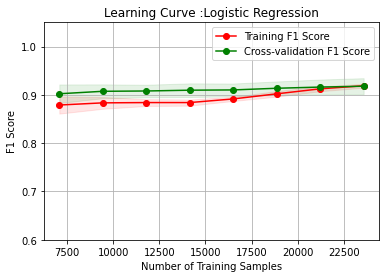

In [ ]:
Learning_Curve(LogisticRegression(),X_train_re,y_train_re,"Logistic Regression")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

**Logistic Regression Using GRID SEARCH CROSS VALIDATION**

In [ ]:
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10, 100],
    'penalty': ['l1', 'l2'],
    'max_iter': [10,100, 1000, 10000]}

log_reg = LogisticRegression()
scoring = ['f1']
grid_search = GridSearchCV(log_reg, param_grid, cv=5, n_jobs=-1,scoring=scoring, refit='f1')
grid_search.fit(X_train_re, y_train_re)
print(grid_search.best_params_)
print(grid_search.best_score_)

![alt text here](https://drive.google.com/uc?export=view&id=1R0RPETNCl5jHcXHzqDYDLT0LePcSTmiZ)

In [ ]:
log_reg=LogisticRegression(C=100,penalty="l2",max_iter=100)
log_reg=log_reg.fit(X_train_re,y_train_re)
y_train_log_cv=log_reg.predict(X_train_re)
y_test_log_cv=log_reg.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_log_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14517   219]
 [ 2029 12707]]
Accurcay :  0.9237242128121607
Recall   :  0.8623099891422367
Precision:  0.9830574036825004
F1 Score: 0.9187332803123418
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_log_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6226   89]
 [ 387 1949]]
Accurcay :  0.9449774592532655
Recall   :  0.834332191780822
Precision:  0.9563297350343474
F1 Score: 0.891175125743027
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

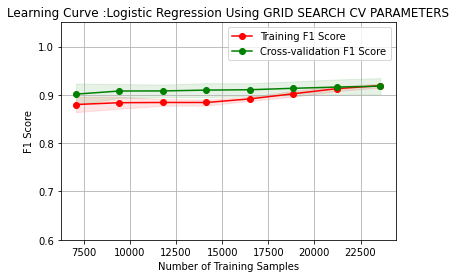

In [ ]:
Learning_Curve(LogisticRegression(C=100,penalty="l2",max_iter=100),X_train_re,y_train_re,"Logistic Regression Using GRID SEARCH CV PARAMETERS")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

## DECISION TREE MODEL 

In [ ]:

def Decision_Tree(X_train,Y_train,X_test,Y_test):                                                                          # Building Decision tree model 
  classifier = DecisionTreeClassifier()                        # Hyperparameters are -->criterion ="entropy" or "gini"
  classifier = classifier.fit(X_train,Y_train)                                                                            # max_depth: the maximum depth of a tree. If not specified, the tree is expanded until the last leaf nodes contain a single value
  Y_train_pred = classifier.predict(X_train)                                                                              #max_leaf_nodes :the number of leaf nodes in a decision tree.It will allow the branches of a tree to have varying depths, another way to control the model’s complexity
  Y_test_pred = classifier.predict(X_test)                                                                                # max_features : in this we can select how many features we can use to get best fit
  print("The First 10 train predictions are:\n",Y_train_pred[0:10],'\n')                                                  # #random_state– controls randomness of the sample
  print("**"*50)
  print("The First 10 test predictions are:\n",Y_test_pred[0:10],'\n')
  return Y_train_pred,Y_test_pred,classifier

In [ ]:
y_train_dt,y_test_dt,dt_clf=Decision_Tree(X_train_re,y_train_re,X_test_df,y_test)

The First 10 train predictions are:
 [0 0 0 1 0 0 0 1 0 0] 

****************************************************************************************************
The First 10 test predictions are:
 [1 0 1 0 0 0 0 0 0 0] 



In [ ]:
ErrorMetrics(y_train_re,y_train_dt)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14736     0]
 [    0 14736]]
Accurcay :  1.0
Recall   :  1.0
Precision:  1.0
F1 Score: 1.0
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_dt)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[5858  457]
 [ 401 1935]]
Accurcay :  0.9008207143682812
Recall   :  0.8283390410958904
Precision:  0.8089464882943144
F1 Score: 0.8185279187817259
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

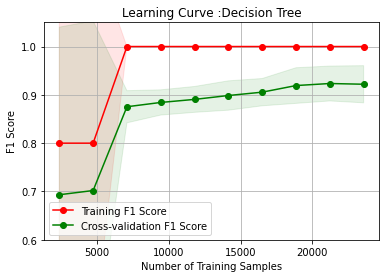

In [ ]:
Learning_Curve(DecisionTreeClassifier(),X_train_re,y_train_re,"Decision Tree")


---


**Report** :
>The learning curve suggests that the model is consistently overfitting the data regardless of the number of training samples.


---



---

**DECISION TREE MODEL WITH GRID SEARCH CROSS VALIDATION**

In [ ]:
"""dtc=DecisionTreeClassifier()
param_grid={'criterion': ['gini', 'entropy'],
              'max_depth': [6, 8, 10,12],
              'min_samples_split': [2, 4, 6, 8, 10],
              'min_samples_leaf': [2, 4, 6, 8, 10],}
grid_search = GridSearchCV(dtc, param_grid=param_grid, cv=5, n_jobs=-1,scoring="f1",refit=True)
grid_search.fit(X_train_re, y_train_re)
print("Best parameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)"""

'dtc=DecisionTreeClassifier()\nparam_grid={\'criterion\': [\'gini\', \'entropy\'],\n              \'max_depth\': [6, 8, 10,12],\n              \'min_samples_split\': [2, 4, 6, 8, 10],\n              \'min_samples_leaf\': [2, 4, 6, 8, 10],}\ngrid_search = GridSearchCV(dtc, param_grid=param_grid, cv=5, n_jobs=-1,scoring="f1",refit=True)\ngrid_search.fit(X_train_re, y_train_re)\nprint("Best parameters:", grid_search.best_params_)\nprint("Best score:", grid_search.best_score_)'

![alt text here](https://drive.google.com/uc?export=view&id=1YnNe4PCEp4f8s8VdJiqrHWz8fndZRlPd)


In [ ]:
dtc=DecisionTreeClassifier(criterion="entropy",splitter="best",max_features=40,max_depth=5,min_samples_split=5,min_samples_leaf=4)
dtc=dtc.fit(X_train_re,y_train_re)
y_train_dt_cv=pd.DataFrame(dtc.predict(X_train_re))
y_test_dt_cv=dtc.predict(X_test_df)

In [ ]:
y_train_dt_cv=pd.DataFrame(y_train_dt_cv)

In [ ]:
y_test_dt_cv=pd.DataFrame(y_test_dt_cv)

In [ ]:
ErrorMetrics(y_train_re,y_train_dt_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14550   186]
 [ 1762 12974]]
Accurcay :  0.9339033659066233
Recall   :  0.88042888165038
Precision:  0.9858662613981763
F1 Score: 0.9301691998852882
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_dt_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6259   56]
 [ 395 1941]]
Accurcay :  0.9478672985781991
Recall   :  0.8309075342465754
Precision:  0.971957936905358
F1 Score: 0.8959150703900299
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

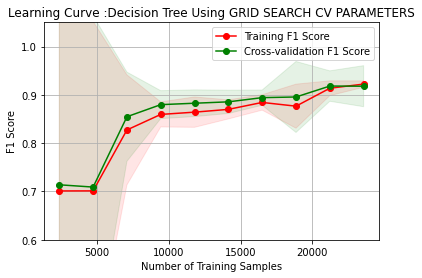

In [ ]:
Learning_Curve(DecisionTreeClassifier(criterion="entropy",splitter="best",max_features=40,max_depth=5,min_samples_split=5,min_samples_leaf=4),X_train_re,y_train_re,"Decision Tree Using GRID SEARCH CV PARAMETERS")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

## RANDOM FOREST MODEL

In [ ]:
def RanFor(X_train,Y_train,X_test,Y_test):
  rfc=RandomForestClassifier()     
  rfc_model=rfc.fit(X_train, Y_train)
  Y_train_pred = rfc_model.predict(X_train)
  Y_test_pred = rfc_model.predict(X_test)
  print("The First 10 train predictions are:\n",Y_train_pred[0:10],'\n')
  print("**"*50)
  print("The First 10 test predictions are:\n",Y_test_pred[0:10],'\n')
  return Y_train_pred,Y_test_pred,rfc_model

In [ ]:
y_train_rf,y_test_rf,rfc_clf=RanFor(X_train_re,y_train_re,X_test_df,y_test)

The First 10 train predictions are:
 [0 0 0 1 0 0 0 1 0 0] 

****************************************************************************************************
The First 10 test predictions are:
 [0 0 1 0 0 0 0 0 0 0] 



In [ ]:
feature=pd.Series(rfc_clf.feature_importances_,index=X_train_re.columns).sort_values(ascending=False)

In [ ]:
feature[0:15]

Insured_details_Chance_Fraud_More_Chance_of_Fraud   0.28
Useful_to_target_less_useful                        0.19
Effect_to_target_effective                          0.12
SeverityOfIncident_Minor Damage                     0.03
SeverityOfIncident_Total Loss                       0.02
AmountOfVehicleDamage                               0.02
AmountOfPropertyClaim                               0.01
AmountOfInjuryClaim                                 0.01
InsuredHobbies_cross-fit                            0.01
PolicyAnnualPremium                                 0.01
Gap_Policy_Incident                                 0.01
CustomerLoyaltyPeriod                               0.01
InsuredHobbies_chess                                0.01
InsuredAge                                          0.01
IncidentTime                                        0.01
dtype: float64

In [ ]:
ErrorMetrics(y_train_re,y_train_rf)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14736     0]
 [    1 14735]]
Accurcay :  0.9999660694896851
Recall   :  0.9999321389793703
Precision:  1.0
F1 Score: 0.9999660683383665
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_rf)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6244   71]
 [ 376 1960]]
Accurcay :  0.9483296728701884
Recall   :  0.839041095890411
Precision:  0.9650418513047759
F1 Score: 0.8976414014197389
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

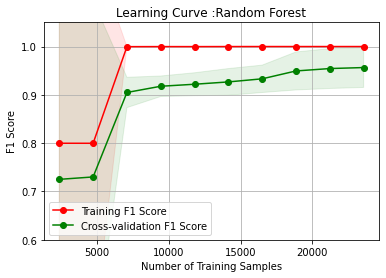

In [ ]:
Learning_Curve(RandomForestClassifier(),X_train_re,y_train_re,"Random Forest")


---


**Report** :
>The learning curve suggests that the model is consistently overfitting the data regardless of the number of training samples.


---



---

**RANDOM FOREST MODEL USING GRID SEARCH CROSS VALIDATION**

In [ ]:
"""rfc=RandomForestClassifier()
param_grid={'max_depth': [6, 8, 10,12],'n_estimators':[40,50,60,80,100,150],'criterion':['gini','entropy']}
grid_search= GridSearchCV(rfc, param_grid, cv =5, scoring='f1',n_jobs=-1,verbose=2,refit=True) 
grid_search.fit(X_train_re,y_train_re)
print("Best parameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)"""

'rfc=RandomForestClassifier()\nparam_grid={\'max_depth\': [6, 8, 10,12],\'n_estimators\':[40,50,60,80,100,150],\'criterion\':[\'gini\',\'entropy\']}\ngrid_search= GridSearchCV(rfc, param_grid, cv =5, scoring=\'f1\',n_jobs=-1,verbose=2,refit=True) \ngrid_search.fit(X_train_re,y_train_re)\nprint("Best parameters:", grid_search.best_params_)\nprint("Best score:", grid_search.best_score_)'

![alt text here](https://drive.google.com/uc?export=view&id=15JNwJ9GOnuv0gcP6zOJIASUxH_IV7aGT)

In [ ]:
rfc=RandomForestClassifier(n_estimators=100,criterion="entropy",max_features=30,max_depth=6,min_samples_split=5)     
rfc=rfc.fit(X_train_re,y_train_re)
y_train_rf_cv=rfc.predict(X_train_re)
y_test_rf_cv=rfc.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_rf_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14572   164]
 [ 1704 13032]]
Accurcay :  0.9366178067318133
Recall   :  0.8843648208469055
Precision:  0.9875719915125796
F1 Score: 0.9331232994415007
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_rf_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6259   56]
 [ 395 1941]]
Accurcay :  0.9478672985781991
Recall   :  0.8309075342465754
Precision:  0.971957936905358
F1 Score: 0.8959150703900299
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

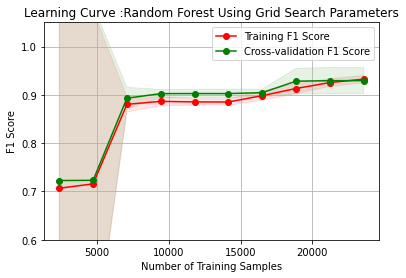

In [ ]:
Learning_Curve(RandomForestClassifier(n_estimators=100,criterion="entropy",max_features=30,max_depth=6,min_samples_split=5),X_train_re,y_train_re,"Random Forest Using Grid Search Parameters")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.And the model Suggests that if more Data is Available then The model will Perform very well and gets f1_score>90


---



---

## SUPPORT VECTOR MACHINE MODEL

In [ ]:
def SVM_func(X_train,Y_train,X_test,Y_test):                      # Building SVM - Support Vector Machine model
  svc=SVC(kernel='linear', C=0.01)                                #kernel-->It maps the observations into some feature space. Ideally the observations are more easily (linearly) separable after this transformation
  svc=svc.fit(X_train,Y_train)                                    # C--> it is a cost Parameter
  Y_train_pred=svc.predict(X_train)
  Y_test_pred=svc.predict(X_test)
  print("The First 10 train predictions are:\n",Y_train_pred[0:10],'\n')
  print("The First 10 test predictions are:\n",Y_test_pred[0:10],'\n')
  return Y_train_pred,Y_test_pred,svc

In [ ]:
y_train_svc,y_test_svc,svc_clf=SVM_func(X_train_re,y_train_re,X_test_df,y_test)

The First 10 train predictions are:
 [0 0 0 1 0 0 0 1 0 0] 

The First 10 test predictions are:
 [0 0 1 0 0 0 0 0 0 0] 



In [ ]:
ErrorMetrics(y_train_re,y_train_svc)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14570   166]
 [ 2286 12450]]
Accurcay :  0.9168023887079262
Recall   :  0.8448697068403909
Precision:  0.9868421052631579
F1 Score: 0.9103539046504825
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_svc) #linear,0.001-->90.2,89.6, linear ,0.01-->91.0,89.6, sigmoid,0.01-->89.86,89.11

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6261   54]
 [ 395 1941]]
Accurcay :  0.9480984857241938
Recall   :  0.8309075342465754
Precision:  0.9729323308270676
F1 Score: 0.8963287924266914
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

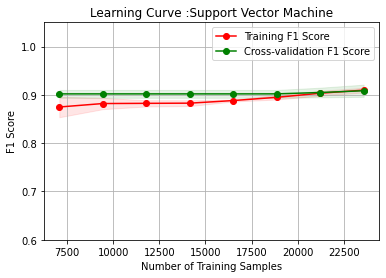

In [ ]:
Learning_Curve(SVC(kernel='linear', C=0.01),X_train_re,y_train_re,"Support Vector Machine")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

**SUPPORT VECTOR MACHINE USING GRID SEARCH CROSS VALIDATION**

In [ ]:
"""svc=SVC()
param_grid = {'C': [0.01,0.1, 1],
              'kernel': ['linear', 'poly', 'rbf']}
grid_svm = GridSearchCV(svc,param_grid, scoring="f1", refit=True, cv=5,n_jobs=-1,verbose=2)
grid_svm.fit(X_train_re, y_train_re)
print("Best hyperparameters: ", grid_svm.best_params_)
print("Best accuracy score: ", grid_svm.best_score_)"""

'svc=SVC()\nparam_grid = {\'C\': [0.01,0.1, 1],\n              \'kernel\': [\'linear\', \'poly\', \'rbf\']}\ngrid_svm = GridSearchCV(svc,param_grid, scoring="f1", refit=True, cv=5,n_jobs=-1,verbose=2)\ngrid_svm.fit(X_train_re, y_train_re)\nprint("Best hyperparameters: ", grid_svm.best_params_)\nprint("Best accuracy score: ", grid_svm.best_score_)'

![alt text here](https://drive.google.com/uc?export=view&id=1Cg4sTHGGMdJe28lhInDO8AF1TTWODRhD)


In [ ]:
svc= SVC(C=1,kernel="poly")
svc=svc.fit(X_train_re,y_train_re)
y_train_svc_cv=svc.predict(X_train_re)
y_test_svc_cv=svc.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_svc_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14596   140]
 [  837 13899]]
Accurcay :  0.966849891422367
Recall   :  0.943200325732899
Precision:  0.9900277797563929
F1 Score: 0.9660469157254562
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_svc_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6208  107]
 [ 331 2005]]
Accurcay :  0.9493700150271644
Recall   :  0.858304794520548
Precision:  0.9493371212121212
F1 Score: 0.9015287769784174
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

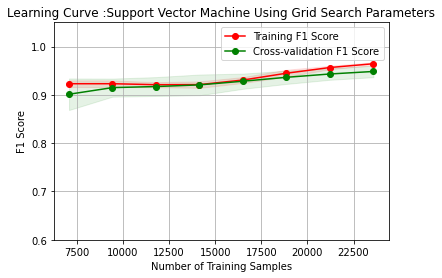

In [ ]:
Learning_Curve(SVC(C=1,kernel="poly"),X_train_re,y_train_re,"Support Vector Machine Using Grid Search Parameters")


---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

## K NEAREST NEIGHBOURS METHOD

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=3,p=1)
knn=knn.fit(X_train_re, y_train_re)
y_train_knn=knn.predict(X_train_re)
y_test_knn=knn.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_knn)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14258   478]
 [  240 14496]]
Accurcay :  0.9756378935939196
Recall   :  0.9837133550488599
Precision:  0.9680780018699079
F1 Score: 0.9758330528441602
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_knn)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[5990  325]
 [ 356 1980]]
Accurcay :  0.9212807767888106
Recall   :  0.8476027397260274
Precision:  0.8590021691973969
F1 Score: 0.8532643826761473
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

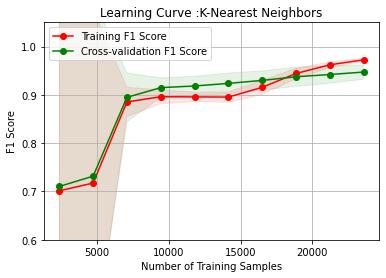

In [ ]:
Learning_Curve(KNeighborsClassifier(n_neighbors=3,p=1),X_train_re,y_train_re,"K-Nearest Neighbors")

---


**Report** :
> In this Learning Curve initially there is some overfitting and model tries to generalize as number of Samples increases and Equals to Training Curve after that it started little Overfitting.


---



---

**K NEAREST NEIGHBOURS USING GRID SEARCH CROSS VALIDATION**

In [ ]:
"""knn_cv= KNeighborsClassifier()
param_grid = {'n_neighbors': [3,5,7],'p': [1, 2]}    #p=1 i.e.,Manhattan distance or p=2 i.e., Euclidian distance
grid_search = GridSearchCV(knn_cv, param_grid=param_grid, cv=5, n_jobs=-1,verbose=2,scoring="f1",refit=True)
grid_search.fit(X_train_re, y_train_re)
print("Best hyperparameters: ", grid_search.best_params_)
print("Best accuracy score: ", grid_search.best_score_)   """

'knn_cv= KNeighborsClassifier()\nparam_grid = {\'n_neighbors\': [3,5,7],\'p\': [1, 2]}    #p=1 i.e.,Manhattan distance or p=2 i.e., Euclidian distance\ngrid_search = GridSearchCV(knn_cv, param_grid=param_grid, cv=5, n_jobs=-1,verbose=2,scoring="f1",refit=True)\ngrid_search.fit(X_train_re, y_train_re)\nprint("Best hyperparameters: ", grid_search.best_params_)\nprint("Best accuracy score: ", grid_search.best_score_)   '

![alt text here](https://drive.google.com/uc?export=view&id=1chFQ_E4qZYJNqAAlm1luntYz2BZPDHo-)


In [ ]:
knn_cv=KNeighborsClassifier(n_neighbors=9 ,p=1)
knn_cv=knn_cv.fit(X_train_re,y_train_re)
y_train_knn_cv=knn_cv.predict(X_train_re)
y_test_knn_cv=knn_cv.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_knn_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14339   397]
 [ 1162 13574]]
Accurcay :  0.9471023344191096
Recall   :  0.9211454940282302
Precision:  0.9715839954190824
F1 Score: 0.945692688194517
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_knn_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6130  185]
 [ 360 1976]]
Accurcay :  0.937001502716449
Recall   :  0.8458904109589042
Precision:  0.9143914854234151
F1 Score: 0.878808094285079
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

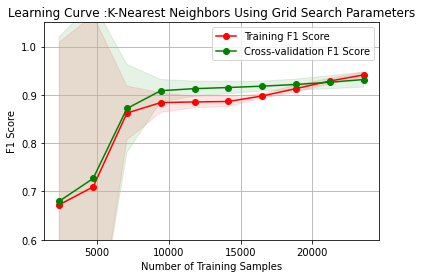

In [ ]:
Learning_Curve(KNeighborsClassifier(n_neighbors=9,p=1),X_train_re,y_train_re,"K-Nearest Neighbors Using Grid Search Parameters")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

## Extreme Gradient Boosting(XGBOOST MODEL)

In [ ]:
import xgboost as xgb
xgb_model =XGBClassifier(objective='binary:logistic', n_estimators=100,learning_rate=0.01,max_depth=9,gamma=0.1)
xgb_model=xgb_model.fit(X_train_re, y_train_re)
y_train_xgb=xgb_model.predict(X_train_re)
y_test_xgb=xgb_model.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_xgb)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14593   143]
 [ 1209 13527]]
Accurcay :  0.9541259500542888
Recall   :  0.9179560260586319
Precision:  0.9895391367959034
F1 Score: 0.9524044216010702
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_xgb)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6257   58]
 [ 396 1940]]
Accurcay :  0.947520517859207
Recall   :  0.8304794520547946
Precision:  0.970970970970971
F1 Score: 0.8952468850946008
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

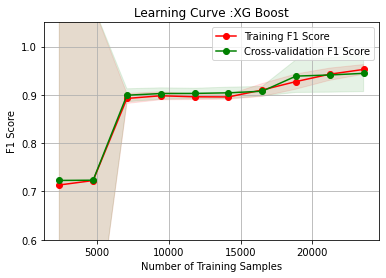

In [ ]:
Learning_Curve(XGBClassifier(objective='binary:logistic', n_estimators=100,learning_rate=0.01,max_depth=9,gamma=0.1),X_train_re,
               y_train_re,"XG Boost")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

**XGBOOST USING GRID SEACH CROSS VALIDATION**

In [ ]:
"""xgb_cv= xgb.XGBClassifier(objective='binary:logistic')
param_grid = {
    'max_depth': [3,5,7,9],
    'learning_rate': [0.1, 0.01],
    'n_estimators': [100,200,300],
    'gamma': [0, 0.1, 0.2],
    'colsample_bytree': [0.5, 0.7]}

grid_search = GridSearchCV(estimator=xgb_cv, param_grid=param_grid, cv=5, n_jobs=-1,scoring="f1")

grid_search.fit(X_train_re, y_train_re)

print("Best hyperparameters: ", grid_search.best_params_)
print("Best accuracy score: ", grid_search.best_score_)""" 


'xgb_cv= xgb.XGBClassifier(objective=\'binary:logistic\')\nparam_grid = {\n    \'max_depth\': [3,5,7,9],\n    \'learning_rate\': [0.1, 0.01],\n    \'n_estimators\': [100,200,300],\n    \'gamma\': [0, 0.1, 0.2],\n    \'colsample_bytree\': [0.5, 0.7]}\n\ngrid_search = GridSearchCV(estimator=xgb_cv, param_grid=param_grid, cv=5, n_jobs=-1,scoring="f1")\n\ngrid_search.fit(X_train_re, y_train_re)\n\nprint("Best hyperparameters: ", grid_search.best_params_)\nprint("Best accuracy score: ", grid_search.best_score_)'

![alt text here](https://drive.google.com/uc?export=view&id=1zBHyk0SDq8QD9sv66RGDX-wMNxs1GXS9)


In [ ]:
xgb_cv = xgb.XGBClassifier(objective='binary:logistic',colsample_bytree= 0.7,gamma=0.7,learning_rate=0.1,max_depth=9,n_estimators=200)
xgb_cv=xgb_cv.fit(X_train_re,y_train_re)
y_train_xgb_cv=xgb_cv.predict(X_train_re)
y_test_xgb_cv=xgb_cv.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_xgb_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14722    14]
 [  372 14364]]
Accurcay :  0.9869028230184582
Recall   :  0.9747557003257329
Precision:  0.9990262901655307
F1 Score: 0.9867417737171121
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_xgb_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6246   69]
 [ 378 1958]]
Accurcay :  0.9483296728701884
Recall   :  0.8381849315068494
Precision:  0.9659595461272817
F1 Score: 0.8975475590190236
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

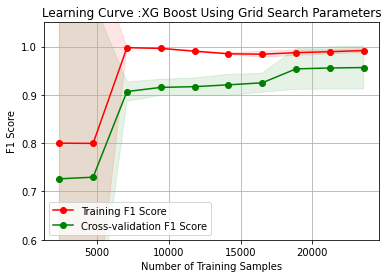

In [ ]:
Learning_Curve(XGBClassifier(objective='binary:logistic',colsample_bytree= 0.7,gamma=0.7,learning_rate=0.1,max_depth=9,n_estimators=200),
               X_train_re,y_train_re,"XG Boost Using Grid Search Parameters")

---


**Report** :
>The learning curve suggests that the model is consistently overfitting the data regardless of the number of training samples.


---



---

## ADABOOST MODEL 

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
base_estimator = CatBoostClassifier(iterations=50, learning_rate=0.1, depth=6)
adaboost_clf = AdaBoostClassifier(base_estimator=base_estimator, n_estimators=100)
adaboost_clf=adaboost_clf.fit(X_train_re, y_train_re)
y_train_ada=adaboost_clf.predict(X_train_re)
y_test_ada=adaboost_clf.predict(X_test_df)


0:	learn: 0.5555022	total: 154ms	remaining: 7.57s
1:	learn: 0.4543963	total: 219ms	remaining: 5.25s
2:	learn: 0.3852532	total: 276ms	remaining: 4.33s
3:	learn: 0.3353132	total: 335ms	remaining: 3.85s
4:	learn: 0.2982129	total: 396ms	remaining: 3.56s
5:	learn: 0.2691019	total: 458ms	remaining: 3.36s
6:	learn: 0.2490708	total: 514ms	remaining: 3.16s
7:	learn: 0.2324352	total: 580ms	remaining: 3.04s
8:	learn: 0.2205638	total: 643ms	remaining: 2.93s
9:	learn: 0.2105859	total: 708ms	remaining: 2.83s
10:	learn: 0.2033479	total: 764ms	remaining: 2.71s
11:	learn: 0.1970494	total: 824ms	remaining: 2.61s
12:	learn: 0.1914976	total: 893ms	remaining: 2.54s
13:	learn: 0.1874523	total: 950ms	remaining: 2.44s
14:	learn: 0.1832263	total: 1.02s	remaining: 2.38s
15:	learn: 0.1794207	total: 1.08s	remaining: 2.3s
16:	learn: 0.1773033	total: 1.16s	remaining: 2.25s
17:	learn: 0.1753522	total: 1.22s	remaining: 2.17s
18:	learn: 0.1722896	total: 1.28s	remaining: 2.1s
19:	learn: 0.1693883	total: 1.35s	remaining

In [ ]:
ErrorMetrics(y_train_re,y_train_ada)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14736     0]
 [    0 14736]]
Accurcay :  1.0
Recall   :  1.0
Precision:  1.0
F1 Score: 1.0
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_ada)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6194  121]
 [ 357 1979]]
Accurcay :  0.9447462721072708
Recall   :  0.8471746575342466
Precision:  0.9423809523809524
F1 Score: 0.8922452660054102
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

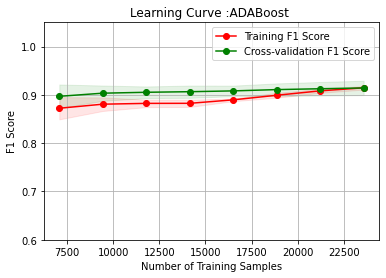

In [ ]:
Learning_Curve(AdaBoostClassifier(base_estimator=LogisticRegression(), n_estimators=100),
               X_train_re,y_train_re,"ADABoost ")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

**ADABOOST USING GRID SEARCH CROSS VALIDATION**

In [ ]:
"""base_estimators = [
    RandomForestClassifier(n_estimators=50),
    CatBoostClassifier(learning_rate=0.1, depth=6)
]
for base_estimator in base_estimators:
    adaboost_clf = AdaBoostClassifier(base_estimator=base_estimator, random_state=42)
    param_grid = {
        'n_estimators': [50,75, 100],
        'learning_rate': [0.1, 0.01, 0.001],
    }
    grid_search = GridSearchCV(adaboost_clf, param_grid=param_grid, cv=3,scoring="f1",n_jobs=-1,verbose=2)
    grid_search.fit(X_train_re, y_train_re)
    print(f"Base estimator: {base_estimator.__class__.__name__}")
    print(f"Best hyperparameters: {grid_search.best_params_}")
    print(f"Validation score: {grid_search.best_score_}")"""

'base_estimators = [\n    RandomForestClassifier(n_estimators=50),\n    CatBoostClassifier(learning_rate=0.1, depth=6)\n]\nfor base_estimator in base_estimators:\n    adaboost_clf = AdaBoostClassifier(base_estimator=base_estimator, random_state=42)\n    param_grid = {\n        \'n_estimators\': [50,75, 100],\n        \'learning_rate\': [0.1, 0.01, 0.001],\n    }\n    grid_search = GridSearchCV(adaboost_clf, param_grid=param_grid, cv=3,scoring="f1",n_jobs=-1,verbose=2)\n    grid_search.fit(X_train_re, y_train_re)\n    print(f"Base estimator: {base_estimator.__class__.__name__}")\n    print(f"Best hyperparameters: {grid_search.best_params_}")\n    print(f"Validation score: {grid_search.best_score_}")'

![alt text here](https://drive.google.com/uc?export=view&id=1i3P-Fu-oUsF6fa9XnbgMdVLCcscFbXuX)


In [ ]:
base_estimator=DecisionTreeClassifier(max_depth=1)
adaboost_cv = AdaBoostClassifier(base_estimator=base_estimator,n_estimators=75 ,learning_rate=0.1 )
adaboost_cv=adaboost_cv.fit(X_train_re,y_train_re)
y_train_ada_cv=adaboost_cv.predict(X_train_re)
y_test_ada_cv=adaboost_cv.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_ada_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14555   181]
 [ 1795 12941]]
Accurcay :  0.9329533116178067
Recall   :  0.8781894679695983
Precision:  0.9862063709800335
F1 Score: 0.9290688491636155
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_ada_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6257   58]
 [ 393 1943]]
Accurcay :  0.9478672985781991
Recall   :  0.831763698630137
Precision:  0.9710144927536232
F1 Score: 0.8960110675582199
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

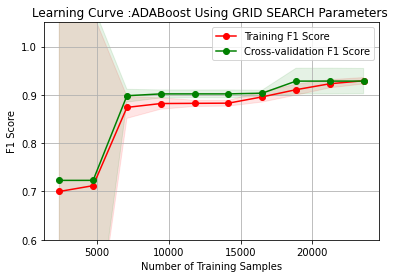

In [ ]:
Learning_Curve(AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1),n_estimators=75 ,learning_rate=0.1 ),
               X_train_re,y_train_re,"ADABoost Using GRID SEARCH Parameters ")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

## STACKING MODEL USING KNN,RANDOMFOREST,LOGISTIC REGRESSION,DECISION TREE

In [ ]:
from mlxtend.classifier import StackingCVClassifier

from sklearn.neighbors import KNeighborsClassifier
lr=LogisticRegression()
dt=DecisionTreeClassifier(criterion="entropy",max_depth=8,min_samples_split=2)                                                                                         
rf=RandomForestClassifier(criterion="entropy",n_estimators=100,max_depth=9)
knn=KNeighborsClassifier(n_neighbors=5)
cat=CatBoostClassifier(iterations=100, learning_rate=0.01, depth=6)
xgb=XGBClassifier(objective='binary:logistic', n_estimators=100,learning_rate=0.01,max_depth=9)
svc=SVC(C=0.1,kernel='linear')

stack = StackingCVClassifier(classifiers=(lr,dt,cat,rf,knn,xgb),meta_classifier=svc, use_features_in_secondary=True,cv=5,verbose=2,n_jobs=-1)
# Fit the stacking regressor
stack.fit(X_train_re,y_train_re)

# Predict target values
y_train_stack = stack.predict(X_train_re)
y_test_stack = stack.predict(X_test_df)

Fitting 6 classifiers...
Fitting classifier1: logisticregression (1/6)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    7.5s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    7.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/6)
DecisionTreeClassifier(criterion='entropy', max_depth=8)


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: catboostclassifier (3/6)


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   34.6s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   34.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: randomforestclassifier (4/6)
RandomForestClassifier(criterion='entropy', max_depth=9)


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.2s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier5: kneighborsclassifier (5/6)
KNeighborsClassifier()


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.5s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   13.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier6: xgbclassifier (6/6)
XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.01, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=9, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  2.8min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  2.8min finished


0:	learn: 0.6791767	total: 80.1ms	remaining: 7.93s
1:	learn: 0.6656314	total: 137ms	remaining: 6.7s
2:	learn: 0.6525493	total: 194ms	remaining: 6.26s
3:	learn: 0.6398221	total: 254ms	remaining: 6.1s
4:	learn: 0.6276076	total: 316ms	remaining: 6.01s
5:	learn: 0.6153776	total: 381ms	remaining: 5.97s
6:	learn: 0.6038290	total: 439ms	remaining: 5.83s
7:	learn: 0.5921519	total: 497ms	remaining: 5.71s
8:	learn: 0.5812402	total: 562ms	remaining: 5.68s
9:	learn: 0.5702370	total: 635ms	remaining: 5.71s
10:	learn: 0.5599565	total: 699ms	remaining: 5.66s
11:	learn: 0.5499673	total: 757ms	remaining: 5.55s
12:	learn: 0.5403609	total: 827ms	remaining: 5.53s
13:	learn: 0.5309888	total: 888ms	remaining: 5.45s
14:	learn: 0.5219154	total: 959ms	remaining: 5.43s
15:	learn: 0.5131533	total: 1.02s	remaining: 5.34s
16:	learn: 0.5046085	total: 1.08s	remaining: 5.27s
17:	learn: 0.4964139	total: 1.14s	remaining: 5.18s
18:	learn: 0.4881525	total: 1.2s	remaining: 5.09s
19:	learn: 0.4803358	total: 1.25s	remaining

In [ ]:
ErrorMetrics(y_train_re,y_train_stack)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14593   143]
 [ 1209 13527]]
Accurcay :  0.9541259500542888
Recall   :  0.9179560260586319
Precision:  0.9895391367959034
F1 Score: 0.9524044216010702
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_stack)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6257   58]
 [ 396 1940]]
Accurcay :  0.947520517859207
Recall   :  0.8304794520547946
Precision:  0.970970970970971
F1 Score: 0.8952468850946008
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    2.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    1.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    4.5s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    5.2s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   10.0s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   13.9s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   17.6s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   20.8s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   27.1s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()
Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    1.3s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    2.5s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    6.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    7.5s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    8.3s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   13.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   17.7s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   22.8s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    1.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   24.6s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()
Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    2.0s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.2s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    2.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    8.2s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    6.0s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   15.1s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   18.6s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   24.5s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.2s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   29.1s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()
Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.2s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    2.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.2s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    2.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    5.5s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    6.4s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   11.9s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   14.5s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   18.6s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   22.9s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   28.6s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.6s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.0s finished


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    1.3s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    3.6s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    4.2s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    6.1s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)
Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   10.7s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)
Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   14.1s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   18.3s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   21.7s finished


Fitting 4 classifiers...
Fitting classifier1: logisticregression (1/4)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/4)
DecisionTreeClassifier(criterion='entropy', max_depth=5, max_features=40,
                       min_samples_leaf=4, min_samples_split=5)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: randomforestclassifier (3/4)
RandomForestClassifier(criterion='entropy', max_depth=6, max_features=30,
                       min_samples_split=5, n_estimators=1)


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.2s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: svc (4/4)
SVC(C=1, kernel='poly')


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   27.4s finished


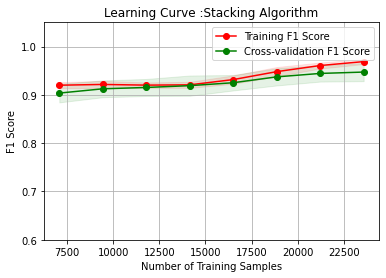

In [ ]:
Learning_Curve(StackingCVClassifier(classifiers=(LogisticRegression(),DecisionTreeClassifier(criterion="entropy",splitter="best",max_features=40,max_depth=5,min_samples_split=5,min_samples_leaf=4),
                                                 RandomForestClassifier(n_estimators=1,criterion="entropy",max_features=30,max_depth=6,min_samples_split=5),
                                                 SVC(C=1,kernel="poly")),meta_classifier=SVC(C=1,kernel="poly"), 
                                    use_features_in_secondary=True,verbose=2,n_jobs=-1),X_train_re,y_train_re,"Stacking Algorithm")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

## CATBOOST MODEL



---


**CatBoost (Categorical Boosting)** :-   
>CatBoost uses a combination of gradient boosting and decision tree algorithms. It works by iteratively training decision trees on the data, with each subsequent tree attempting to correct the errors of the previous ones. During this process, CatBoost also performs several optimizations to handle categorical features more efficiently, such as using ordered boosting, which sorts the categorical features based on their target statistics, and applying symmetric trees, which help to reduce overfitting.

>One of the unique features of CatBoost is its ability to handle missing values in the data. It does this by treating missing values as a separate category and assigning them a specific value during training.

Overall, CatBoost is a powerful and flexible machine learning algorithm that can handle a wide range of data types and perform well in many applications.


---



---



In [ ]:
from catboost import CatBoostClassifier
# Initialize the model
cat_model = CatBoostClassifier(iterations=100, learning_rate=0.1, depth=6, l2_leaf_reg=3,verbose=False)
# Train the model
cat_model=cat_model.fit(X_train_re, y_train_re)

In [ ]:
y_train_cat=cat_model.predict(X_train_re)
y_test_cat=cat_model.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_cat)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14571   165]
 [ 1106 13630]]
Accurcay :  0.9568743213897937
Recall   :  0.9249457111834962
Precision:  0.9880391446176151
F1 Score: 0.9554519645298097
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_cat)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6261   54]
 [ 394 1942]]
Accurcay :  0.948214079297191
Recall   :  0.8313356164383562
Precision:  0.9729458917835672
F1 Score: 0.896583564173592
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

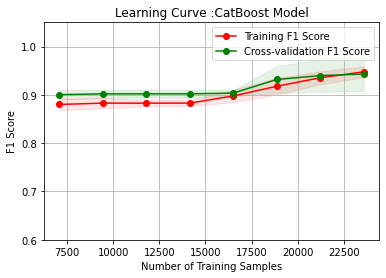

In [ ]:
Learning_Curve(CatBoostClassifier(iterations=30,learning_rate=0.1, depth=6, l2_leaf_reg=3,verbose=False),X_train_re,y_train_re,"CatBoost Model")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

**CATBOOST USING GRID SEARCH CROSS VALIDATION**

In [ ]:

""""from catboost import CatBoostClassifier, Pool
from sklearn.model_selection import GridSearchCV

# Initialize the model
model = CatBoostClassifier()

# Define the grid of hyperparameters to search over
param_grid = {
    'iterations': [100, 200, 300],
    'learning_rate': [0.05, 0.1, 0.2],
    'depth': [4, 6, 8]
}

# Create a cross-validation object
cv = GridSearchCV(
    estimator=model,  # the CatBoost model to use
    param_grid=param_grid,  # the grid of hyperparameters to search over
    cv=5,  # the number of cross-validation folds to use
    scoring='accuracy',  # the scoring metric to optimize for
    n_jobs=-1,  # the number of CPU cores to use (-1 means all available cores)
    verbose=False  # the verbosity level (0 means no output, higher values mean more output)
)

# Perform the grid search
cv.fit(X_train_re, y_train_re)

# Print the best hyperparameters and validation score
print('Best hyperparameters:', cv.best_params_)
print('Best validation score:', cv.best_score_)"""

'"from catboost import CatBoostClassifier, Pool\nfrom sklearn.model_selection import GridSearchCV\n\n# Initialize the model\nmodel = CatBoostClassifier()\n\n# Define the grid of hyperparameters to search over\nparam_grid = {\n    \'iterations\': [100, 200, 300],\n    \'learning_rate\': [0.05, 0.1, 0.2],\n    \'depth\': [4, 6, 8]\n}\n\n# Create a cross-validation object\ncv = GridSearchCV(\n    estimator=model,  # the CatBoost model to use\n    param_grid=param_grid,  # the grid of hyperparameters to search over\n    cv=5,  # the number of cross-validation folds to use\n    scoring=\'accuracy\',  # the scoring metric to optimize for\n    n_jobs=-1,  # the number of CPU cores to use (-1 means all available cores)\n    verbose=False  # the verbosity level (0 means no output, higher values mean more output)\n)\n\n# Perform the grid search\ncv.fit(X_train_re, y_train_re)\n\n# Print the best hyperparameters and validation score\nprint(\'Best hyperparameters:\', cv.best_params_)\nprint(\'Best

In [ ]:
cat_cv=CatBoostClassifier(iterations=300, learning_rate=0.1, depth=8)
cat_cv=cat_cv.fit(X_train_re,y_train_re)
y_train_cat_cv=cat_cv.predict(X_train_re)
y_test_cat_cv=cat_cv.predict(X_test_df)

0:	learn: 0.5616611	total: 338ms	remaining: 1m 40s
1:	learn: 0.4649634	total: 637ms	remaining: 1m 34s
2:	learn: 0.3992371	total: 941ms	remaining: 1m 33s
3:	learn: 0.3470107	total: 1.25s	remaining: 1m 32s
4:	learn: 0.3108809	total: 1.55s	remaining: 1m 31s
5:	learn: 0.2817981	total: 1.84s	remaining: 1m 30s
6:	learn: 0.2596637	total: 2.13s	remaining: 1m 29s
7:	learn: 0.2450664	total: 2.41s	remaining: 1m 28s
8:	learn: 0.2314137	total: 2.71s	remaining: 1m 27s
9:	learn: 0.2202546	total: 2.98s	remaining: 1m 26s
10:	learn: 0.2128857	total: 3.23s	remaining: 1m 24s
11:	learn: 0.2070366	total: 3.52s	remaining: 1m 24s
12:	learn: 0.1997411	total: 3.84s	remaining: 1m 24s
13:	learn: 0.1938931	total: 4.13s	remaining: 1m 24s
14:	learn: 0.1904809	total: 4.29s	remaining: 1m 21s
15:	learn: 0.1849469	total: 4.45s	remaining: 1m 19s
16:	learn: 0.1809218	total: 4.61s	remaining: 1m 16s
17:	learn: 0.1785693	total: 4.77s	remaining: 1m 14s
18:	learn: 0.1763049	total: 4.92s	remaining: 1m 12s
19:	learn: 0.1741125	t

In [ ]:
ErrorMetrics(y_train_re,y_train_cat_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14632   104]
 [  671 14065]]
Accurcay :  0.9737038545059717
Recall   :  0.9544652551574375
Precision:  0.992660032465241
F1 Score: 0.973188029752638
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_cat_cv)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6247   68]
 [ 379 1957]]
Accurcay :  0.9483296728701884
Recall   :  0.8377568493150684
Precision:  0.9664197530864198
F1 Score: 0.897500573263013
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

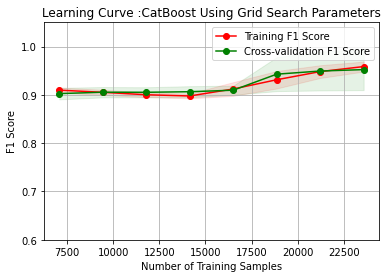

In [ ]:
Learning_Curve(CatBoostClassifier(iterations=100, learning_rate=0.1, depth=8),X_train_re,y_train_re,"CatBoost Using Grid Search Parameters")

---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

## ARTIFICIAL NEURAL NETWORK

In [ ]:
import tensorflow
from keras.models import Sequential
from keras.layers import Dense,BatchNormalization,Dropout,LayerNormalization
from keras.wrappers.scikit_learn import KerasClassifier

model = Sequential()
model.add(Dense(100, activation='relu', input_dim=166))
model.add(Dropout(0.5))
model.add(Dense(110, activation='relu'))         
model.add(Dropout(0.3))
model.add(Dense(units=1, activation='sigmoid'))
model.compile(optimizer="adam",loss='binary_crossentropy',metrics=get_f1)
model.fit(X_train_re, y_train_re,batch_size=50,epochs=30, validation_data=(X_test_df, y_test))

Epoch 1/30
590/590 [==============================] - 6s 7ms/step - loss: 0.3140 - get_f1: 0.8702 - val_loss: 0.2145 - val_get_f1: 0.8784
Epoch 2/30
590/590 [==============================] - 2s 4ms/step - loss: 0.2370 - get_f1: 0.9144 - val_loss: 0.2264 - val_get_f1: 0.8785
Epoch 3/30
590/590 [==============================] - 3s 4ms/step - loss: 0.2190 - get_f1: 0.9217 - val_loss: 0.2076 - val_get_f1: 0.8820
Epoch 4/30
590/590 [==============================] - 2s 4ms/step - loss: 0.2005 - get_f1: 0.9260 - val_loss: 0.2090 - val_get_f1: 0.8828
Epoch 5/30
590/590 [==============================] - 2s 4ms/step - loss: 0.1916 - get_f1: 0.9301 - val_loss: 0.2069 - val_get_f1: 0.8821
Epoch 6/30
590/590 [==============================] - 3s 5ms/step - loss: 0.1762 - get_f1: 0.9348 - val_loss: 0.2068 - val_get_f1: 0.8819
Epoch 7/30
590/590 [==============================] - 3s 5ms/step - loss: 0.1631 - get_f1: 0.9403 - val_loss: 0.2191 - val_get_f1: 0.8812
Epoch 8/30
590/590 [==============

In [ ]:
y_test_ann=(model.predict(X_test_df)> 0.5).astype(int)
y_train_ann=(model.predict(X_train_re)> 0.5).astype(int)

921/921 [==============================] - 2s 2ms/step


In [ ]:
ErrorMetrics(y_train_re,y_train_ann)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14612   124]
 [  234 14502]]
Accurcay :  0.9878528773072747
Recall   :  0.9841205211726385
Precision:  0.9915219472172843
F1 Score: 0.9878073700701587
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_ann)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6189  126]
 [ 357 1979]]
Accurcay :  0.9441683042422842
Recall   :  0.8471746575342466
Precision:  0.9401425178147268
F1 Score: 0.8912407115514523
****************************************************************************************************


************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this I'm Plotting the Learning Curves Fo

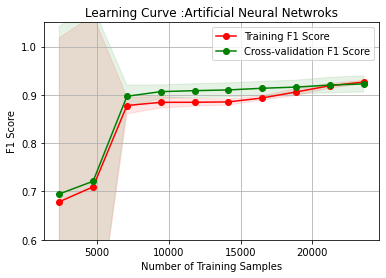

In [ ]:
from sklearn.neural_network import MLPClassifier
# Create an MLPClassifier object
mlp = MLPClassifier(hidden_layer_sizes=(10,), max_iter=30, solver='adam', random_state=42,verbose=False)
Learning_Curve(mlp,X_train_re,y_train_re,"Artificial Neural Netwroks")


---


**Report** :
>The learning curve suggests that the model initially overfits the training data but becomes more generalized as it is trained on more data, resulting in a smaller gap between the training and Cross validation curves by the end.This is a good sign, as it indicates that the model is neither underfitting nor overfitting the data, but is achieving a good balance between the two.


---



---

## VOTING CLASSIFIER MODEL 

In [ ]:
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import f1_score
# Create the voting classifier with hard voting
voting_clf = VotingClassifier(estimators=[('Logistics Regression', log_reg), ('Decision Tree', dtc), ('Random Forest', rfc_clf),("SVC",svc_clf),
                                          ("XG Boost",xgb_model),("AdaBoost",adaboost_cv),("Stacking",stack),("Cat Boost",cat_model)], voting='hard')

# Fit the voting classifier to the training data
voting_clf=voting_clf.fit(X_train_re, y_train_re)


Fitting 6 classifiers...
Fitting classifier1: logisticregression (1/6)
LogisticRegression()


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    6.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    6.2s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier2: decisiontreeclassifier (2/6)
DecisionTreeClassifier(criterion='entropy', max_depth=8)


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier3: catboostclassifier (3/6)


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   32.6s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   32.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier4: randomforestclassifier (4/6)
RandomForestClassifier(criterion='entropy', max_depth=9)


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   17.7s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   17.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier5: kneighborsclassifier (5/6)
KNeighborsClassifier()


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   12.7s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   12.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Fitting classifier6: xgbclassifier (6/6)
XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.01, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=9, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  2.7min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  2.7min finished


0:	learn: 0.6791767	total: 127ms	remaining: 12.5s
1:	learn: 0.6656314	total: 242ms	remaining: 11.8s
2:	learn: 0.6525493	total: 363ms	remaining: 11.7s
3:	learn: 0.6398221	total: 467ms	remaining: 11.2s
4:	learn: 0.6276076	total: 569ms	remaining: 10.8s
5:	learn: 0.6153776	total: 695ms	remaining: 10.9s
6:	learn: 0.6038290	total: 805ms	remaining: 10.7s
7:	learn: 0.5921519	total: 933ms	remaining: 10.7s
8:	learn: 0.5812402	total: 1.06s	remaining: 10.7s
9:	learn: 0.5702370	total: 1.18s	remaining: 10.6s
10:	learn: 0.5599565	total: 1.3s	remaining: 10.5s
11:	learn: 0.5499673	total: 1.41s	remaining: 10.4s
12:	learn: 0.5403609	total: 1.55s	remaining: 10.4s
13:	learn: 0.5309888	total: 1.66s	remaining: 10.2s
14:	learn: 0.5219154	total: 1.78s	remaining: 10.1s
15:	learn: 0.5131533	total: 1.91s	remaining: 10s
16:	learn: 0.5046085	total: 2.03s	remaining: 9.93s
17:	learn: 0.4964139	total: 2.14s	remaining: 9.77s
18:	learn: 0.4881525	total: 2.27s	remaining: 9.66s
19:	learn: 0.4803358	total: 2.37s	remaining:

In [ ]:
y_train_vote=voting_clf.predict(X_train_re)
y_test_vote=voting_clf.predict(X_test_df)

In [ ]:
ErrorMetrics(y_train_re,y_train_vote)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[14591   145]
 [ 1741 12995]]
Accurcay :  0.9360070575461455
Recall   :  0.8818539630836048
Precision:  0.98896499238965
F1 Score: 0.9323432343234324
****************************************************************************************************


In [ ]:
ErrorMetrics(y_test,y_test_vote)

The Error Metrics are :
 ****************************************************************************************************
Confusion Matrix 
 [[6261   54]
 [ 395 1941]]
Accurcay :  0.9480984857241938
Recall   :  0.8309075342465754
Precision:  0.9729323308270676
F1 Score: 0.8963287924266914
****************************************************************************************************


## DATAFRAME FOR EVALUATION METRICS FOR ALL MACHINE LEARNING MODELS

In [ ]:
models = [('Logistic Regression',y_train_log,y_test_log), ('Logistic Regression Using CV',y_train_log_cv,y_test_log_cv),
          ("Decision Tree",y_train_dt,y_test_dt),("Decision Tree Using CV",y_train_dt_cv,y_test_dt_cv),
          ("Random Forest",y_train_rf,y_test_rf),("Random Forest Using CV",y_train_rf_cv,y_test_rf_cv),
          ("SVC",y_train_svc,y_test_svc),("SVC Using CV",y_train_svc_cv,y_test_svc_cv),
          ("KNN",y_train_knn,y_test_knn),("KNN Using CV",y_train_knn_cv,y_test_knn_cv),
          ("XGBoost",y_train_xgb,y_test_xgb),("XGBoost Using CV",y_train_xgb_cv,y_test_xgb_cv),
          ("AdaBoost",y_train_ada,y_test_ada),("AdaBoost Using CV",y_train_ada_cv,y_test_ada_cv),
          ("Stacking",y_train_stack,y_test_stack),("Stacking Using CV",y_train_stack,y_test_stack),
          ("CATBoost",y_train_cat,y_test_cat),("CATBoost Using CV",y_train_cat_cv,y_test_cat_cv)]

metrics_list = []

# Calculate the evaluation metrics for each model
for model_name,train_preds,test_preds in models:
    accuracy_train = accuracy_score(y_train_re, train_preds)
    precision_train = precision_score(y_train_re, train_preds)
    recall_train = recall_score(y_train_re, train_preds)
    f1_train = f1_score(y_train_re, train_preds)
    accuracy_test = accuracy_score(y_test, test_preds)
    precision_test = precision_score(y_test, test_preds)
    recall_test = recall_score(y_test, test_preds)
    f1_test = f1_score(y_test, test_preds)
    metrics_dict = {'Model': model_name,
                    'Accuracy_train': accuracy_train,'Accuracy_test': accuracy_test,
                    'Precision_train': precision_train,'Precision_test': precision_test,
                    'Recall_train': recall_train,'Recall_test': recall_test, 
                    'F1_train': f1_train,'F1_test': f1_test}
    metrics_list.append(metrics_dict)

# Create a pandas dataframe from the list of evaluation metrics
metrics_df = pd.DataFrame(metrics_list)

In [ ]:
metrics_df

,Model,Accuracy_train,Accuracy_test,Precision_train,Precision_test,Recall_train,Recall_test,F1_train,F1_test
0,Logistic Regression,0.92,0.95,0.98,0.96,0.86,0.83,0.92,0.89
1,Logistic Regression Using CV,0.92,0.94,0.98,0.96,0.86,0.83,0.92,0.89
2,Decision Tree,1.00,0.90,1.00,0.81,1.00,0.83,1.00,0.82
3,Decision Tree Using CV,0.93,0.95,0.99,0.97,0.88,0.83,0.93,0.90
4,Random Forest,1.00,0.95,1.00,0.97,1.00,0.84,1.00,0.90
5,Random Forest Using CV,0.94,0.95,0.99,0.97,0.88,0.83,0.93,0.90
6,SVC,0.92,0.95,0.99,0.97,0.84,0.83,0.91,0.90
7,SVC Using CV,0.97,0.95,0.99,0.95,0.94,0.86,0.97,0.90
8,KNN,0.98,0.92,0.97,0.86,0.98,0.85,0.98,0.85
9,KNN Using CV,0.95,0.94,0.97,0.91,0.92,0.85,0.95,0.88


## APPLYING ON TEST DATA

In [ ]:
Test_Claim=pd.read_csv("/content/drive/MyDrive/CapStone/Test_data/Test_Claim.csv",na_values=["?","???","NA","-1","-5","MISSEDDATA","MISSINGVALUE"])
Test_Demo=pd.read_csv("/content/drive/MyDrive/CapStone/Test_data/Test_Demographics.csv",na_values=["?","???","NA","-1","-5","MISSEDDATA","MISSINGVALUE"])
Test_policy=pd.read_csv("/content/drive/MyDrive/CapStone/Test_data/Test_Policy.csv",na_values=["?","???","NA","-1","-5","MISSEDDATA","MISSINGVALUE"])
Test_Vehicle=pd.read_csv("/content/drive/MyDrive/CapStone/Test_data/Test_Vehicle.csv",na_values=["?","???","NA","-1","-5","MISSEDDATA","MISSINGVALUE"])

In [ ]:
Test_Claim

,CustomerID,DateOfIncident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,IncidentAddress,IncidentTime,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage
0,Cust10008,2015-02-05,Multi-vehicle Collision,Front Collision,Minor Damage,Ambulance,State5,City2,Location 1354,4.00,3,NO,0,0.00,NaN,68354.00,6835,8059,53460
1,Cust10010,2015-01-13,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State9,City5,Location 1383,16.00,1,NaN,1,1.00,NaN,55270.00,8113,5240,41917
2,Cust10015,2015-01-05,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,State5,City2,Location 2030,20.00,3,NO,0,1.00,NaN,59515.00,7490,9110,42915
3,Cust10020,2015-01-03,Vehicle Theft,NaN,Trivial Damage,None,State7,City5,Location 1449,10.00,1,NaN,2,1.00,NaN,4941.00,494,866,3581
4,Cust1003,2015-02-22,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,State5,City2,Location 1916,7.00,3,NO,2,3.00,NO,34650.00,7700,3850,23100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8907,Cust9984,2015-01-17,Single Vehicle Collision,Rear Collision,Total Loss,Police,State5,City4,Location 1958,10.00,1,YES,1,0.00,NO,61296.00,5785,8861,46650
8908,Cust9986,2015-02-09,Single Vehicle Collision,Front Collision,Total Loss,Other,State5,City2,Location 1035,19.00,1,NaN,1,1.00,YES,86729.00,9698,9698,67333
8909,Cust9990,2015-02-20,Single Vehicle Collision,Rear Collision,Minor Damage,Other,State5,City2,Location 2037,9.00,1,YES,1,2.00,NO,65328.00,12455,9281,43592
8910,Cust9995,2015-02-22,Single Vehicle Collision,Side Collision,Minor Damage,Police,State8,City3,Location 2097,19.00,1,YES,0,2.00,YES,71118.00,11977,11604,47537


In [ ]:
Test_Demo

,CustomerID,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,Country
0,Cust10008,27,471704,FEMALE,High School,adm-clerical,base-jumping,56400,-57000,India
1,Cust10010,40,455810,FEMALE,MD,prof-specialty,golf,56700,-65600,India
2,Cust10015,39,461919,MALE,JD,other-service,movies,30400,0,India
3,Cust10020,38,600904,FEMALE,Masters,exec-managerial,video-games,68500,0,India
4,Cust1003,29,430632,FEMALE,PhD,sales,board-games,35100,0,India
...,...,...,...,...,...,...,...,...,...,...
8907,Cust9984,28,446435,MALE,Associate,tech-support,camping,0,-53700,India
8908,Cust9986,30,438237,FEMALE,Associate,craft-repair,movies,39600,-64300,India
8909,Cust9990,44,450339,FEMALE,High School,armed-forces,dancing,25000,0,India
8910,Cust9995,29,439304,MALE,PhD,transport-moving,hiking,75800,-28800,India


In [ ]:
Test_policy

,InsurancePolicyNumber,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,CustomerID
0,110124,134,2000-09-06,State3,100/300,2000,1413.14,5000000,own-child,Cust1003
1,110129,165,1990-02-03,State1,100/300,1000,1137.03,0,unmarried,Cust1008
2,110137,473,1992-10-19,State2,100/300,2000,1131.40,0,other-relative,Cust1016
3,110140,160,2014-12-28,State3,500/1000,500,1374.22,0,other-relative,Cust1019
4,110141,196,1992-08-02,State2,500/1000,2000,1475.73,0,own-child,Cust1020
...,...,...,...,...,...,...,...,...,...,...
8907,148598,155,2000-03-19,State3,250/500,616,1358.80,3462442,other-relative,Cust39477
8908,148599,215,1993-07-23,State3,250/500,892,1299.82,4567362,other-relative,Cust39478
8909,148609,245,2009-12-11,State1,500/1000,1002,1361.44,9580,wife,Cust39488
8910,148610,437,2011-11-17,State1,500/1000,1902,1357.36,4510498,wife,Cust39489


In [ ]:
Test_Vehicle

,CustomerID,VehicleAttribute,VehicleAttributeDetails
0,Cust28465,VehicleModel,92x
1,Cust20319,VehicleModel,Jetta
2,Cust3683,VehicleID,Vehicle22709
3,Cust29385,VehicleID,Vehicle20347
4,Cust34403,VehicleModel,Camry
...,...,...,...
35643,Cust1980,VehicleModel,95
35644,Cust17773,VehicleModel,Silverado
35645,Cust24313,VehicleID,Vehicle33407
35646,Cust5061,VehicleYOM,2003


In [ ]:
Test_Vehicle_pivoted = Test_Vehicle.pivot(index='CustomerID', columns='VehicleAttribute', values='VehicleAttributeDetails')
Test_Vehicle_pivoted=Test_Vehicle_pivoted.reset_index()
Test_Vehicle_pivoted

VehicleAttribute,CustomerID,VehicleID,VehicleMake,VehicleModel,VehicleYOM
0,Cust10008,Vehicle34362,Volkswagen,Passat,1995
1,Cust10010,Vehicle17046,Nissan,Ultima,2006
2,Cust10015,Vehicle11038,Suburu,Impreza,2010
3,Cust10020,Vehicle37114,Accura,TL,2009
4,Cust1003,Vehicle16771,Dodge,RAM,2007
...,...,...,...,...,...
8907,Cust9984,Vehicle19062,Saab,95,2000
8908,Cust9986,Vehicle18191,Saab,92x,2000
8909,Cust9990,Vehicle11032,BMW,Civic,1998
8910,Cust9995,Vehicle30412,Jeep,Grand Cherokee,2002


In [ ]:
Test_df=pd.merge(Test_Claim,pd.merge(Test_Demo,pd.merge(Test_policy,Test_Vehicle_pivoted,on="CustomerID"),on="CustomerID"),on="CustomerID")

In [ ]:
Understanding_data(Test_df)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File. In this Function 
  I'm Understanding the dat

,CustomerID,DateOfIncident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,IncidentAddress,IncidentTime,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,Country,InsurancePolicyNumber,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,VehicleID,VehicleMake,VehicleModel,VehicleYOM
0,Cust10008,2015-02-05,Multi-vehicle Collision,Front Collision,Minor Damage,Ambulance,State5,City2,Location 1354,4.00,3,NO,0,0.00,NaN,68354.00,6835,8059,53460,27,471704,FEMALE,High School,adm-clerical,base-jumping,56400,-57000,India,119129,84,1998-05-10,State2,500/1000,2000,1006.00,0,own-child,Vehicle34362,Volkswagen,Passat,1995
1,Cust10010,2015-01-13,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State9,City5,Location 1383,16.00,1,NaN,1,1.00,NaN,55270.00,8113,5240,41917,40,455810,FEMALE,MD,prof-specialty,golf,56700,-65600,India,119131,232,2011-11-10,State3,100/300,500,1279.17,0,unmarried,Vehicle17046,Nissan,Ultima,2006
2,Cust10015,2015-01-05,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,State5,City2,Location 2030,20.00,3,NO,0,1.00,NaN,59515.00,7490,9110,42915,39,461919,MALE,JD,other-service,movies,30400,0,India,119136,218,2010-07-17,State2,250/500,1000,1454.67,1235986,other-relative,Vehicle11038,Suburu,Impreza,2010
3,Cust10020,2015-01-03,Vehicle Theft,NaN,Trivial Damage,None,State7,City5,Location 1449,10.00,1,NaN,2,1.00,NaN,4941.00,494,866,3581,38,600904,FEMALE,Masters,exec-managerial,video-games,68500,0,India,119141,205,2000-09-10,State3,500/500,2000,1287.76,5873212,wife,Vehicle37114,Accura,TL,2009
4,Cust1003,2015-02-22,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,State5,City2,Location 1916,7.00,3,NO,2,3.00,NO,34650.00,7700,3850,23100,29,430632,FEMALE,PhD,sales,board-games,35100,0,India,110124,134,2000-09-06,State3,100/300,2000,1413.14,5000000,own-child,Vehicle16771,Dodge,RAM,2007
5,Cust10033,2015-02-06,Multi-vehicle Collision,Side Collision,Minor Damage,Police,State5,City4,Location 1359,22.00,3,NaN,1,1.00,YES,82151.00,14692,9208,58251,55,445339,MALE,College,tech-support,sleeping,45700,0,India,119154,404,1994-03-17,State1,500/1000,2000,933.49,1435220,unmarried,Vehicle32962,Suburu,Forrestor,2010
6,Cust10036,2015-01-18,Single Vehicle Collision,Rear Collision,Major Damage,Ambulance,State7,City1,Location 1781,6.00,1,NaN,0,1.00,NaN,48775.00,5076,5076,38623,28,442142,FEMALE,College,craft-repair,golf,0,-85900,India,119157,76,2005-10-05,State3,500/1000,766,1382.17,0,wife,Vehicle29431,Dodge,Neon,2012
7,Cust10038,2015-01-24,Single Vehicle Collision,Side Collision,Total Loss,Fire,State8,City3,Location 1158,14.00,1,NaN,0,3.00,NaN,51168.00,6084,9266,35818,39,460760,MALE,JD,other-service,golf,0,-79400,India,119159,231,1996-05-19,State2,100/300,819,1361.74,1275838,not-in-family,Vehicle29796,Toyota,Corolla,2006
8,Cust10039,2015-02-26,Single Vehicle Collision,Side Collision,Total Loss,Fire,State8,City3,Location 1158,15.00,1,NO,1,2.00,NaN,48761.00,7365,7263,34133,33,460760,MALE,JD,priv-house-serv,golf,63100,-79800,India,119160,147,2004-07-17,State2,100/300,1321,1318.66,3282427,not-in-family,Vehicle36221,Toyota,Corolla,2007
9,Cust10045,2015-01-09,Single Vehicle Collision,Side Collision,Minor Damage,Police,State7,City7,Location 1629,19.00,1,YES,1,3.00,NaN,77860.00,13554,10090,54216,42,605258,FEMALE,PhD,adm-clerical,reading,64800,-22300,India,119166,196,2001-11-28,State1,500/1000,1092,1136.23,0,other-relative,Vehicle24190,Dodge,Malibu,2006


In [ ]:
Unique_Null_values(Test_df)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File. In this Function
  I want to Check for How ma

,Column_Name,Unique_Values,Null_Values
0,CustomerID,8912,0
1,DateOfIncident,67,0
2,TypeOfIncident,4,0
3,TypeOfCollission,3,1763
4,SeverityOfIncident,4,0
5,AuthoritiesContacted,5,0
6,IncidentState,7,0
7,IncidentCity,7,0
8,IncidentAddress,996,0
9,IncidentTime,24,7


In [ ]:
col=["CustomerID","Country","InsurancePolicyNumber","VehicleID"]
Delete_Cardinality(Test_df,col)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm "Deleting the High Car

,DateOfIncident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,IncidentAddress,IncidentTime,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,VehicleMake,VehicleModel,VehicleYOM
0,2015-02-05,Multi-vehicle Collision,Front Collision,Minor Damage,Ambulance,State5,City2,Location 1354,4.00,3,NO,0,0.00,NaN,68354.00,6835,8059,53460,27,471704,FEMALE,High School,adm-clerical,base-jumping,56400,-57000,84,1998-05-10,State2,500/1000,2000,1006.00,0,own-child,Volkswagen,Passat,1995
1,2015-01-13,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State9,City5,Location 1383,16.00,1,NaN,1,1.00,NaN,55270.00,8113,5240,41917,40,455810,FEMALE,MD,prof-specialty,golf,56700,-65600,232,2011-11-10,State3,100/300,500,1279.17,0,unmarried,Nissan,Ultima,2006
2,2015-01-05,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,State5,City2,Location 2030,20.00,3,NO,0,1.00,NaN,59515.00,7490,9110,42915,39,461919,MALE,JD,other-service,movies,30400,0,218,2010-07-17,State2,250/500,1000,1454.67,1235986,other-relative,Suburu,Impreza,2010
3,2015-01-03,Vehicle Theft,NaN,Trivial Damage,None,State7,City5,Location 1449,10.00,1,NaN,2,1.00,NaN,4941.00,494,866,3581,38,600904,FEMALE,Masters,exec-managerial,video-games,68500,0,205,2000-09-10,State3,500/500,2000,1287.76,5873212,wife,Accura,TL,2009
4,2015-02-22,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,State5,City2,Location 1916,7.00,3,NO,2,3.00,NO,34650.00,7700,3850,23100,29,430632,FEMALE,PhD,sales,board-games,35100,0,134,2000-09-06,State3,100/300,2000,1413.14,5000000,own-child,Dodge,RAM,2007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8907,2015-01-17,Single Vehicle Collision,Rear Collision,Total Loss,Police,State5,City4,Location 1958,10.00,1,YES,1,0.00,NO,61296.00,5785,8861,46650,28,446435,MALE,Associate,tech-support,camping,0,-53700,94,1997-10-23,State3,500/1000,673,1104.02,1959277,wife,Saab,95,2000
8908,2015-02-09,Single Vehicle Collision,Front Collision,Total Loss,Other,State5,City2,Location 1035,19.00,1,NaN,1,1.00,YES,86729.00,9698,9698,67333,30,438237,FEMALE,Associate,craft-repair,movies,39600,-64300,115,2001-08-16,State2,250/500,574,961.46,0,husband,Saab,92x,2000
8909,2015-02-20,Single Vehicle Collision,Rear Collision,Minor Damage,Other,State5,City2,Location 2037,9.00,1,YES,1,2.00,NO,65328.00,12455,9281,43592,44,450339,FEMALE,High School,armed-forces,dancing,25000,0,297,2003-04-14,State2,100/300,1216,1560.49,0,wife,BMW,Civic,1998
8910,2015-02-22,Single Vehicle Collision,Side Collision,Minor Damage,Police,State8,City3,Location 2097,19.00,1,YES,0,2.00,YES,71118.00,11977,11604,47537,29,439304,MALE,PhD,transport-moving,hiking,75800,-28800,94,1992-08-21,State2,100/300,1950,1577.48,0,wife,Jeep,Grand Cherokee,2002


In [ ]:
date_col=["DateOfIncident","DateOfPolicyCoverage"]
cat_col=['TypeOfIncident', 'TypeOfCollission','SeverityOfIncident', 'AuthoritiesContacted', 'IncidentState',
       'IncidentCity', 'IncidentAddress','NumberOfVehicles','PropertyDamage', 'BodilyInjuries', 'Witnesses','PoliceReport',
       'InsuredZipCode','InsuredGender', 'InsuredEducationLevel', 'InsuredOccupation','InsuredHobbies','InsurancePolicyState',
       'Policy_CombinedSingleLimit','InsuredRelationship','VehicleMake', 'VehicleModel', 'VehicleYOM']

In [ ]:
Test_df=Convert_dtype(Test_df,date_col,cat_col)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Converting the DataTyp

In [ ]:
Test_df.describe()

,IncidentTime,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit
count,8905.00,8904.00,8912.00,8912.00,8912.00,8912.00,8912.00,8912.00,8912.00,8912.00,8865.00,8912.00
mean,11.79,51092.66,7214.08,7114.53,36761.52,38.74,23413.00,-25365.89,203.06,1123.58,1260.24,931859.36
std,6.16,25653.52,4447.76,4367.82,18381.52,7.91,27821.33,28032.96,98.42,553.14,205.53,1919602.62
min,0.00,100.00,0.00,0.00,70.00,19.00,0.00,-111100.00,0.00,500.00,433.33,-883692.00
25%,6.00,42288.25,4409.00,4508.25,30215.75,33.00,0.00,-50400.00,127.00,622.00,1119.46,0.00
50%,12.00,57770.50,7133.50,6988.50,41913.00,38.00,0.00,0.00,199.00,1000.00,1265.84,0.00
75%,17.00,68518.25,10378.50,10184.50,49222.00,44.00,49900.00,0.00,265.00,1691.25,1399.24,283681.00
max,23.00,112320.00,20989.00,23498.00,77760.00,64.00,100500.00,0.00,478.00,2000.00,2033.54,9699227.00


In [ ]:
import numpy as np
from scipy.stats.mstats import winsorize

# apply Winsorization to replace the top 10% of values with the 99th percentile value
Test_df.insert(35,"UmbrellaLimit_winsorize",winsorize(Test_df['UmbrellaLimit'], limits=[0.001, 0.22]))

In [ ]:
Test_df.drop(["AmountOfTotalClaim","UmbrellaLimit"],axis=1,inplace=True)

In [ ]:
Test_df.insert(loc=10, column='Gap_Policy_Incident', value=(Test_df['DateOfIncident']- Test_df['DateOfPolicyCoverage']))

In [ ]:
Test_df["Gap_Policy_Incident"]=Test_df["Gap_Policy_Incident"]/np.timedelta64(1,'D')

In [ ]:
Test_df.insert(1,"Incident_Month",Test_df["DateOfIncident"].dt.month)

In [ ]:
Test_df.insert(2,"Incident_Date",Test_df["DateOfIncident"].dt.day)

In [ ]:
Test_df.insert(3,"Day_of_incident",Test_df['DateOfIncident'].dt.day_name())

In [ ]:
category = pd.cut(Test_df.Gap_Policy_Incident,bins=[-100,3650,7300,10000],labels=["Below_Ten_years","Second_Decade","Above_two_Decades"])
Test_df.insert(11,"Gap_in_Decades",category)

In [ ]:
Test_df.insert(loc=9, column='State_city_of_incident_address', value=(Test_df['IncidentState'].astype(str) + '-' + Test_df['IncidentCity'].astype(str)).astype('category'))

In [ ]:
Test_df

,DateOfIncident,Incident_Month,Incident_Date,Day_of_incident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,State_city_of_incident_address,IncidentCity,IncidentAddress,Gap_in_Decades,IncidentTime,NumberOfVehicles,Gap_Policy_Incident,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,InsuredRelationship,VehicleMake,UmbrellaLimit_winsorize,VehicleModel,VehicleYOM
0,2015-02-05,2,5,Thursday,Multi-vehicle Collision,Front Collision,Minor Damage,Ambulance,State5,State5-City2,City2,Location 1354,Second_Decade,4.00,3,6115.00,NO,0,0.00,NaN,6835,8059,53460,27,471704,FEMALE,High School,adm-clerical,base-jumping,56400,-57000,84,1998-05-10,State2,500/1000,2000,1006.00,own-child,Volkswagen,0,Passat,1995
1,2015-01-13,1,13,Tuesday,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,State9,State9-City5,City5,Location 1383,Below_Ten_years,16.00,1,1160.00,NaN,1,1.00,NaN,8113,5240,41917,40,455810,FEMALE,MD,prof-specialty,golf,56700,-65600,232,2011-11-10,State3,100/300,500,1279.17,unmarried,Nissan,0,Ultima,2006
2,2015-01-05,1,5,Monday,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,State5,State5-City2,City2,Location 2030,Below_Ten_years,20.00,3,1633.00,NO,0,1.00,NaN,7490,9110,42915,39,461919,MALE,JD,other-service,movies,30400,0,218,2010-07-17,State2,250/500,1000,1454.67,other-relative,Suburu,1062548,Impreza,2010
3,2015-01-03,1,3,Saturday,Vehicle Theft,NaN,Trivial Damage,None,State7,State7-City5,City5,Location 1449,Second_Decade,10.00,1,5228.00,NaN,2,1.00,NaN,494,866,3581,38,600904,FEMALE,Masters,exec-managerial,video-games,68500,0,205,2000-09-10,State3,500/500,2000,1287.76,wife,Accura,1062548,TL,2009
4,2015-02-22,2,22,Sunday,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,State5,State5-City2,City2,Location 1916,Second_Decade,7.00,3,5282.00,NO,2,3.00,NO,7700,3850,23100,29,430632,FEMALE,PhD,sales,board-games,35100,0,134,2000-09-06,State3,100/300,2000,1413.14,own-child,Dodge,1062548,RAM,2007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8907,2015-01-17,1,17,Saturday,Single Vehicle Collision,Rear Collision,Total Loss,Police,State5,State5-City4,City4,Location 1958,Second_Decade,10.00,1,6295.00,YES,1,0.00,NO,5785,8861,46650,28,446435,MALE,Associate,tech-support,camping,0,-53700,94,1997-10-23,State3,500/1000,673,1104.02,wife,Saab,1062548,95,2000
8908,2015-02-09,2,9,Monday,Single Vehicle Collision,Front Collision,Total Loss,Other,State5,State5-City2,City2,Location 1035,Second_Decade,19.00,1,4925.00,NaN,1,1.00,YES,9698,9698,67333,30,438237,FEMALE,Associate,craft-repair,movies,39600,-64300,115,2001-08-16,State2,250/500,574,961.46,husband,Saab,0,92x,2000
8909,2015-02-20,2,20,Friday,Single Vehicle Collision,Rear Collision,Minor Damage,Other,State5,State5-City2,City2,Location 2037,Second_Decade,9.00,1,4330.00,YES,1,2.00,NO,12455,9281,43592,44,450339,FEMALE,High School,armed-forces,dancing,25000,0,297,2003-04-14,State2,100/300,1216,1560.49,wife,BMW,0,Civic,1998
8910,2015-02-22,2,22,Sunday,Single Vehicle Collision,Side Collision,Minor Damage,Police,State8,State8-City3,City3,Location 2097,Above_two_Decades,19.00,1,8220.00,YES,0,2.00,YES,11977,11604,47537,29,439304,MALE,PhD,transport-moving,hiking,75800,-28800,94,1992-08-21,State2,100/300,1950,1577.48,wife,Jeep,0,Grand Cherokee,2002


In [ ]:
Test_df.insert(5, 'Effect_to_target', Test_df.apply(check_combination, axis=1).astype('category')) 

In [ ]:
Test_df.insert(6, 'Useful_to_target', Test_df.apply(check_combination_2, axis=1).astype('category')) 

In [ ]:
Test_df.insert(7, 'Insured_details_Chance_Fraud', Test_df.apply(check_combination_3, axis=1).astype('category')) 

In [ ]:
Test_df.drop(["DateOfIncident","Incident_Date","Day_of_incident","State_city_of_incident_address","IncidentState","IncidentCity","IncidentAddress","InsuredZipCode","DateOfPolicyCoverage","InsuredRelationship"],axis=1,inplace=True)

In [ ]:
Test_num,Test_cat=Num_Cat_df(Test_df)

In [ ]:
Test_cat.columns

In [ ]:
Test_cat_dum = pd.DataFrame(enc.transform(Test_cat))
Test_cat_dum.columns = enc.get_feature_names_out(input_features=Test_cat.columns)

In [ ]:
Test_cat_impute=pd.DataFrame(imputer_cat.transform(Test_cat_dum),columns=Test_cat_dum.columns)

[IterativeImputer] Completing matrix with shape (8912, 153)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.00


In [ ]:
Test_cat_impute.isnull().sum()

In [ ]:
Test_num_impute=pd.DataFrame(imputer_num.transform(Test_num),columns=Test_num.columns)

In [ ]:
Test_num=pd.DataFrame(scaler.transform(Test_num_impute),columns=Test_num_impute.columns)

In [ ]:
Test_df=Combine_Num_Cat_df(Test_num,Test_cat_impute)

In [ ]:
Test_pred = pd.DataFrame(svc_clf.predict(Test_df), columns=["ReportedFraud"])

In [ ]:
Test_pred

,ReportedFraud
0,0
1,0
2,0
3,0
4,0
...,...
8907,0
8908,0
8909,0
8910,0


In [ ]:
Test=pd.read_csv("/content/drive/MyDrive/CapStone/Test_data/Test.csv")

In [ ]:
Test["ReportedFraud"]=Test_pred

In [ ]:
Test.to_csv("./Test_prediction.csv")

## Pattern Extraction

In [ ]:
Train_df=pd.merge(Train_Claim,pd.merge(Train_Demo,pd.merge(Train_policy,pd.merge(Train_Vehicle_pivoted,Train_target,on="CustomerID"),on="CustomerID"),on="CustomerID"),on="CustomerID")

In [ ]:
Train_df["ReportedFraud"]=Train_df["ReportedFraud"].replace({"Y":1,"N":0})

In [ ]:
col=["CustomerID","DateOfIncident","IncidentState","IncidentCity","IncidentAddress","IncidentTime","InsuredZipCode","Country","InsurancePolicyNumber","VehicleID","DateOfPolicyCoverage","InsurancePolicyState"]
Delete_Cardinality(Train_df,col)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm "Deleting the High Car

,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,CustomerLoyaltyPeriod,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,VehicleMake,VehicleModel,VehicleYOM,ReportedFraud
0,Multi-vehicle Collision,Side Collision,Total Loss,Police,3,NaN,1,0.00,NaN,65501.00,13417,6071,46013,35,MALE,JD,armed-forces,movies,56700,-48500,49,100/300,1000,1632.73,0,not-in-family,Audi,A5,2008,0
1,Multi-vehicle Collision,Side Collision,Total Loss,Police,3,YES,2,1.00,YES,61382.00,15560,5919,39903,36,MALE,JD,tech-support,cross-fit,70600,-48500,114,100/300,1000,1255.19,0,not-in-family,Audi,A5,2006,0
2,Single Vehicle Collision,Side Collision,Minor Damage,Other,1,YES,2,3.00,NO,66755.00,11630,11630,43495,33,MALE,JD,armed-forces,polo,66400,-63700,167,500/1000,617,1373.38,0,wife,Volkswagen,Jetta,1999,0
3,Single Vehicle Collision,Side Collision,Minor Damage,Other,1,YES,2,3.00,NO,66243.00,12003,12003,42237,36,MALE,JD,armed-forces,polo,47900,-73400,190,500/1000,722,1337.60,0,own-child,Volkswagen,Jetta,2003,0
4,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,1,NO,2,1.00,YES,53544.00,8829,7234,37481,29,FEMALE,High School,exec-managerial,dancing,0,-41500,115,100/300,500,1353.73,4279863,unmarried,Toyota,CRV,2010,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28831,Vehicle Theft,NaN,Trivial Damage,Police,1,NO,0,3.00,NaN,6590.00,870,1078,4642,46,MALE,Masters,protective-serv,sleeping,0,0,321,500/1000,655,1276.01,0,unmarried,Suburu,Impreza,2007,0
28832,Single Vehicle Collision,Front Collision,Minor Damage,Fire,1,YES,0,2.00,YES,74547.00,14699,7875,51973,44,MALE,Masters,adm-clerical,dancing,0,-28800,237,100/300,1089,1273.38,0,unmarried,Jeep,Wrangler,2003,0
28833,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,1,YES,2,0.00,YES,55305.00,7043,7043,41219,53,MALE,PhD,transport-moving,base-jumping,63100,-43800,392,250/500,787,1380.92,3448735,own-child,Suburu,Legacy,2004,0
28834,Single Vehicle Collision,Rear Collision,Minor Damage,Ambulance,1,NaN,2,0.00,YES,55830.00,7059,7059,41712,53,MALE,Associate,transport-moving,skydiving,67400,-43800,391,250/500,780,1389.29,3364301,not-in-family,Suburu,Forrestor,2004,0


In [ ]:
cat_col=["TypeOfIncident","TypeOfCollission","SeverityOfIncident","AuthoritiesContacted","NumberOfVehicles","PropertyDamage","BodilyInjuries",
         "Witnesses","PoliceReport","InsuredGender","InsuredEducationLevel","InsuredOccupation","InsuredHobbies","Policy_CombinedSingleLimit",
         "InsuredRelationship","VehicleMake","VehicleModel","VehicleYOM","ReportedFraud"]
Train_df[cat_col]=Train_df[cat_col].astype("category") 

In [ ]:
X,y=Separate_x_y_df(Train_df,"ReportedFraud")

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Seperating the Indepen

In [ ]:
X_train,X_test,y_train,y_test=Split_train_test(X,y)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function we are Splitting The Train

In [ ]:
X_train_num,X_train_cat=Num_Cat_df(X_train)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Seperating X_train,X_t

In [ ]:
X_test_num,X_test_cat=Num_Cat_df(X_test)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Seperating X_train,X_t

In [ ]:
X_train_cat_dum,enc=One_Hot_Encoding(X_train_cat,X_train_cat.columns)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
This is the Function Written in ml_functions.py File.
  In this Function I'm Dummifing the Categori

In [ ]:
X_test_cat_dum = pd.DataFrame(enc.transform(X_test_cat))
X_test_cat_dum.columns = enc.get_feature_names_out(input_features=X_test_cat.columns)

In [ ]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

rf=RandomForestClassifier()
imputer_cat = IterativeImputer(estimator=rf,missing_values=np.nan,initial_strategy="most_frequent", max_iter=50, verbose=2, imputation_order='descending',random_state=123)
imputer_cat=imputer_cat.fit(X_train_cat_dum)
X_train_cat_impute=pd.DataFrame(imputer_cat.transform(X_train_cat_dum),columns=X_train_cat_dum.columns)

[IterativeImputer] Completing matrix with shape (20185, 151)
[IterativeImputer] Ending imputation round 1/50, elapsed time 514.15
[IterativeImputer] Change: 0.0, scaled tolerance: 0.001 
[IterativeImputer] Early stopping criterion reached.
[IterativeImputer] Completing matrix with shape (20185, 151)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.01


In [ ]:
X_test_cat_impute=pd.DataFrame(imputer_cat.transform(X_test_cat_dum),columns=X_train_cat_dum.columns)

[IterativeImputer] Completing matrix with shape (8651, 151)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.01


In [ ]:
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

rf1=RandomForestRegressor()
imputer_num = IterativeImputer(estimator=rf1,missing_values=np.nan,initial_strategy="mean", max_iter=50, verbose=2, imputation_order='descending',random_state=123)
imputer_num=imputer_num.fit(X_train_num)
X_train_num_impute=pd.DataFrame(imputer_num.transform(X_train_num),columns=X_train_num.columns)

[IterativeImputer] Completing matrix with shape (20185, 11)
[IterativeImputer] Ending imputation round 1/50, elapsed time 242.69
[IterativeImputer] Change: 48402.92692590203, scaled tolerance: 10000.0 
[IterativeImputer] Ending imputation round 2/50, elapsed time 454.42
[IterativeImputer] Change: 1264.5999999999913, scaled tolerance: 10000.0 
[IterativeImputer] Early stopping criterion reached.
[IterativeImputer] Completing matrix with shape (20185, 11)
[IterativeImputer] Ending imputation round 1/2, elapsed time 0.05
[IterativeImputer] Ending imputation round 2/2, elapsed time 0.09


In [ ]:
X_test_num_impute=pd.DataFrame(imputer_num.transform(X_test_num),columns=X_test_num.columns)

[IterativeImputer] Completing matrix with shape (8651, 11)
[IterativeImputer] Ending imputation round 1/2, elapsed time 0.03
[IterativeImputer] Ending imputation round 2/2, elapsed time 0.06


In [ ]:
X_train_df=Combine_Num_Cat_df(X_train_num_impute,X_train_cat_impute)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
Combining Numeric And categorical DataFrames After Performing 
  All the preprocessing steps after 

In [ ]:
X_test_df=Combine_Num_Cat_df(X_test_num_impute,X_test_cat_impute)

************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************
Combining Numeric And categorical DataFrames After Performing 
  All the preprocessing steps after 

In [ ]:
import pandas as pd
import numpy as np
import pydotplus
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from IPython.display import Image

# define a function to get the decision paths and their split counts
def get_decision_paths(tree, node_index=0, current_path=[], decision_paths=[]):
    current_path.append(node_index)
    left_child = tree.tree_.children_left[node_index]
    right_child = tree.tree_.children_right[node_index]
    if left_child == -1 and right_child == -1:
        decision_paths.append((current_path, tree.tree_.n_node_samples[node_index]))
    if left_child != -1:
        get_decision_paths(tree, left_child, current_path.copy(), decision_paths)
    if right_child != -1:
        get_decision_paths(tree, right_child, current_path.copy(), decision_paths)
    return decision_paths

# load your data and split it into train and test sets

# fit a decision tree classifier on the train set
dt = DecisionTreeClassifier()
dt.fit(X_train_df, y_train)

# get the decision paths from the root to the leaf node where impurities vanish
decision_paths = get_decision_paths(dt)

# sort the decision paths by their length and pick the top 20 paths
top_20_paths = sorted(decision_paths, key=lambda x: len(x[0]))[:25]

# get the feature names from the column names of the training data
feature_names = X_train_df.columns.tolist()

# print the top 20 paths with feature names, splitting conditions, and split counts
for i, (path, count) in enumerate(top_20_paths):
    print(f"\nPath {i+1} (count: {count})")
    for j, node_id in enumerate(path[:-1]):
        feature_index = dt.tree_.feature[node_id]
        threshold = dt.tree_.threshold[node_id]
        if feature_index != -2:
            feature_name = feature_names[feature_index]
            if X_train_df[feature_name].dtype == 'object':
                condition = f"== '{threshold}'"
            else:
                condition = f"<= {threshold:.6f}"
            print(f"  {feature_name} {condition}")
    print(f"  Class: {np.argmax(dt.tree_.value[node_id])}")


Path 1 (count: 5)
  InsuredHobbies_chess <= 0.500000
  InsuredHobbies_cross-fit <= 0.500000
  InsuredOccupation_other-service <= 0.500000
  PolicyAnnualPremium <= 1238.474976
  Class: 0

Path 2 (count: 2)
  InsuredHobbies_chess <= 0.500000
  TypeOfIncident_Single Vehicle Collision <= 0.500000
  AmountOfInjuryClaim <= 177.000000
  InsuredOccupation_protective-serv <= 0.500000
  Class: 0

Path 3 (count: 2)
  InsuredHobbies_chess <= 0.500000
  TypeOfIncident_Single Vehicle Collision <= 0.500000
  AmountOfInjuryClaim <= 6714.500000
  VehicleMake_Honda <= 0.500000
  Class: 1

Path 4 (count: 15)
  InsuredHobbies_chess <= 0.500000
  InsuredHobbies_cross-fit <= 0.500000
  SeverityOfIncident_Minor Damage <= 0.500000
  InsuredOccupation_exec-managerial <= 0.500000
  NumberOfVehicles_4 <= 0.500000
  Class: 0

Path 5 (count: 4)
  InsuredHobbies_chess <= 0.500000
  InsuredHobbies_cross-fit <= 0.500000
  InsuredOccupation_other-service <= 0.500000
  VehicleModel_Wrangler <= 0.500000
  TypeOfColliss

**Rankings to Top 20 Patterns** :
>Giving ranks Based on the given paths for auto insurance claim fraud detection, here's the ranking of the paths from the most likely to be a fraud to the least likely:

1. Path 3: This path has only two instances and both are classified as 
fraud (class 1). The condition "AmountOfInjuryClaim <= 6714.500000" might have triggered the fraud detection, as it is a relatively high amount for a single incident.

2. Path 7: This path also has a high probability of being a fraud as five out of six instances were classified as fraud. The condition "AmountOfInjuryClaim <= 177.000000" might have triggered the fraud detection, as it is a low amount for a single incident.

3. Path 8: This path has a probability of being a fraud as both instances are classified as fraud. The condition "AmountOfInjuryClaim <= 6714.500000" might have triggered the fraud detection, as it is a relatively high amount for a single incident.

4. Path 14: This path has a probability of being a fraud as 1 instance were classified as fraud. The condition "PolicyAnnualPremium <= 1238.474976" might have triggered the fraud detection, as it is a low amount for an annual premium.

5. Path 17: This path has a probability of being a fraud as Three  instances  were classified as non-fraud (class 0) and three were classified as fraud. The conditions "InsuredHobbies_chess <= 0.500000" and "AmountOfInjuryClaim <= 12433.500000" might have filtered out some fraudulent cases.

6. Path 9: This path has a probability of being a non-fraud as nine out of eleven instances were classified as non-fraud (class 0) and only two were classified as fraud. The condition "UmbrellaLimit <= 4569940.500000" might have filtered out some fraudulent cases.

7. Path 10: This path has a probability of being a non-fraud as ten out of twelve instances were classified as non-fraud (class 0) and two were classified as fraud. The conditions "SeverityOfIncident_Minor Damage <= 0.500000" and "SeverityOfIncident_Total Loss <= 0.500000" might have filtered out some fraudulent cases.

8. Path 1: This path has a probability of being a non-fraud as all five instances were classified as non-fraud (class 0). The conditions "InsuredHobbies_chess <= 0.500000", "InsuredHobbies_cross-fit <= 0.500000", and "InsuredOccupation_other-service <= 0.500000" might have filtered out some fraudulent cases.

9. Path 5: This path has a probability of being a non-fraud as all four instances were classified as non-fraud (class 0). The conditions "InsuredHobbies_chess <= 0.500000", "InsuredHobbies_cross-fit <= 0.500000", "InsuredOccupation_other-service <= 0.500000", "VehicleModel_Wrangler <= 0.500000", and "TypeOfCollission_Rear Collision <= 0.500000" might have filtered out some fraudulent cases.

10. Path 6: This path has a probability of being a non-fraud as all one instance was classified as non-fraud (class 0). The conditions "InsuredHobbies_chess <= 0.500000", "TypeOfIncident_Single Vehicle Collision <= 0.500000", "AmountOfInjuryClaim <= 177.000000".

11. Path 15 (count: 1): This path has the lowest count, which means it is the least frequently occurring path in the dataset. It includes a combination of features that lead to a Class 0 prediction, but with only one instance in the data, it may not be a reliable indicator of fraud or non-fraud.

12. Path 13: This path has a probability of being a fraud as four out of six instances were classified as fraud. The condition "PolicyAnnualPremium <= 1238.474976" might have triggered the fraud detection, as it is a low amount for an annual premium. 

13. Path 4: This path has a probability of being a fraud as twelve out of fifteen instances were classified as non-fraud (class 0) and three were classified as fraud. The conditions "InsuredHobbies_chess <= 0.500000" and "InsuredHobbies_cross-fit <= 0.500000" might have filtered out some fraudulent cases.

14. Path 16 (count: 1): This path also has a low count, but it leads to a Class 1 prediction. However, since it occurs only once in the data, it may not be a reliable indicator of fraud.

15. Path 11 :This path includes features related to the number of injuries, type of incident, policy annual premium, and vehicle make that lead to a Class 0 prediction. It has a higher count than some of the other paths, indicating that it is a relatively common combination of features that could be useful in identifying non-fraudulent claims.

16. Path 18 (count: 3): This path includes features related to the number of injuries, policy annual premium, and type of collision that lead to a Class 0 prediction. While it has a higher count than some of the other paths, it may not be as useful in identifying fraud compared to some of the higher-ranking paths.

17. Path 2 :This path includes features related to the type of incident, amount of injury claim, and insured age that lead to a Class 0 prediction. It has a higher count than some of the other paths, but the combination of features may not be as indicative of fraud compared to some of the higher-ranking paths.

18. Path 12: This path includes features related to the type of incident, amount of injury claim, and vehicle make that lead to a Class 1 prediction. It has a higher count than some of the other paths, indicating that it is a relatively common combination of features that could be useful in identifying potential fraud.

19. Path 19 (count: 5): This path includes features related to the number of injuries, type of incident, policy annual premium, and customer loyalty period that lead to a Class 1 prediction. It has a higher count than some of the other paths, indicating that it is a relatively common combination of features that could be useful in identifying potential fraud.

20. Path 20 (count: 8): This path includes features related to the type of incident, amount of injury claim, and insured age that lead to a Class 0 prediction. It has a higher count than some of the other paths, but the combination of features may not be as indicative of fraud compared to some of the higher-ranking paths.

In [ ]:
# fit a decision tree classifier on the train set
dt = DecisionTreeClassifier()
dt.fit(X_train_df, y_train)

# get the decision paths from the root to the leaf node where impurities vanish
decision_paths = get_decision_paths(dt)

# sort the decision paths by their length and pick the top 20 paths with counts > 200
top_paths = [(path, count) for (path, count) in decision_paths if count > 250]
top_paths = sorted(top_paths, key=lambda x: len(x[0]))[:30]

# get the feature names from the column names of the training data
feature_names = X_train_df.columns.tolist()

# print the top paths with feature names, splitting conditions, and split counts
for i, (path, count) in enumerate(top_paths):
    print(f"\nPath {i+1} (count: {count})")
    for j, node_id in enumerate(path[:-1]):
        feature_index = dt.tree_.feature[node_id]
        threshold = dt.tree_.threshold[node_id]
        if feature_index != -2:
            feature_name = feature_names[feature_index]
            if X_train_df[feature_name].dtype == 'object':
                condition = f"== '{threshold}'"
            else:
                condition = f"<= {threshold:.6f}"
            print(f"  {feature_name} {condition}")
    print(f"  Class: {np.argmax(dt.tree_.value[node_id])}")


Path 1 (count: 256)
  InsuredHobbies_chess <= 0.500000
  PolicyAnnualPremium <= 981.939972
  CapitalLoss <= -66250.000000
  UmbrellaLimit <= 6341908.000000
  CustomerLoyaltyPeriod <= 25.500000
  VehicleMake_Saab <= 0.500000
  AmountOfPropertyClaim <= 486.000000
  Policy_Deductible <= 1231.000000
  AmountOfInjuryClaim <= 449.500000
  AmountOfInjuryClaim <= 518.000000
  Class: 1

Path 2 (count: 249)
  InsuredHobbies_chess <= 0.500000
  InsuredHobbies_cross-fit <= 0.500000
  SeverityOfIncident_Minor Damage <= 0.500000
  SeverityOfIncident_Total Loss <= 0.500000
  InsuredOccupation_exec-managerial <= 0.500000
  CapitalGains <= 88600.000000
  InsuredHobbies_video-games <= 0.500000
  VehicleModel_M5 <= 0.500000
  CapitalLoss <= -39350.000000
  AmountOfVehicleDamage <= 44361.000000
  CustomerLoyaltyPeriod <= 15.500000
  VehicleModel_MDX <= 0.500000
  AmountOfPropertyClaim <= 10904.500000
  AmountOfPropertyClaim <= 10870.000000
  Witnesses_nan <= 0.500000
  VehicleMake_Mercedes <= 0.500000
  